In [ ]:
%cd /content/

/content


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install pyradiomics
# # !pip install tifftools
## !pip install brainextractor
!pip install antspyx
!pip install antspynet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 42.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
Discarding https://files.pythonhosted.org/packages/03/c1/20fc2c50ab1e3304da36d866042a1905a2b05a1431ece35448ab6b4578f2/pyradiomics-3.1.0.tar.gz (from https://pypi.org/simple/pyradiomics/): Requested pyradiomics from https://files.pythonhosted.org/packages/03/c1/20fc2c50ab1e3304da36d866042a1905a2b05a1431ece35448ab6b4578f2/pyradiomics-3.1.0.tar.gz has inconsistent version: expected '3.1.0', but metadata has '3.0.1a1'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 34.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 80.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117

In [ ]:
# !zip -r '/content/data_sm_1.zip' '/content/RADIOMICS/data_sm'
# !cp -av /content/data_sm_1.zip /content/drive/MyDrive/Colab\ Notebooks/MEDAI_July
# !unzip /content/RADIOMICS/data/RADIOMICS_04/Segmentation/Segmentation.nii.gz -d /content/RADIOMICS/data/RADIOMICS_04/Segmentation/

In [ ]:
!cp -av /content/drive/MyDrive/Colab\ Notebooks/MEDAI_July/final_data1 /content/

# !cp -av  /content/final_data /content/drive/MyDrive/Colab\ Notebooks/MEDAI_July/final_data1

# !unzip /content/drive/MyDrive/Colab\ Notebooks/MEDAI_July/data_sm_1.zip -d /


'/content/drive/MyDrive/Colab Notebooks/MEDAI_July/final_data1' -> '/content/final_data1'
'/content/drive/MyDrive/Colab Notebooks/MEDAI_July/final_data1/RADIOMICS' -> '/content/final_data1/RADIOMICS'
'/content/drive/MyDrive/Colab Notebooks/MEDAI_July/final_data1/RADIOMICS/new_folder' -> '/content/final_data1/RADIOMICS/new_folder'
'/content/drive/MyDrive/Colab Notebooks/MEDAI_July/final_data1/RADIOMICS/.ipynb_checkpoints' -> '/content/final_data1/RADIOMICS/.ipynb_checkpoints'


In [ ]:
# !rm -r /content/final_data/RADIOMICS/new_folder/RADIOMICS_03_PROG
# !rm -r /content/final_data/RADIOMICS/new_folder/RADIOMICS_06_RTN
# !rm -r /content/final_data/RADIOMICS/new_folder/RADIOMICS_07_PROG
# !rm -r /content/final_data/RADIOMICS/new_folder/RADIOMICS_96_PROG
# !rm -r /content/final_data/RADIOMICS/new_folder/RADIOMICS_43_RTN
# !rm -r /content/final_data/RADIOMICS/new_folder/RADIOMICS_59_PROG

In [ ]:
from skimage.io import imread
import radiomics
from radiomics import featureextractor
from radiomics import getFeatureClasses
import SimpleITK as sitk
from SimpleITK import GetImageFromArray
import nibabel as nib

import numpy as np
import pandas as pd
import glob

import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

import ants

from natsort import natsorted
from scipy.ndimage import zoom

# from brainextractor import BrainExtractor




In [ ]:
# img_path= "/content/RADIOMICS/data/RADIOMICS_04/NII"
img_path= "/content/final_data1/RADIOMICS/new_folder"
# Fetching files from the directory
img_list= glob.glob(img_path+"/*/Resize/*.gz", recursive= True)

In [ ]:
folder_list= glob.glob(img_path+"/*", recursive= True)

In [ ]:
folder_list= natsorted(folder_list)

In [ ]:
len(folder_list)

135

In [ ]:
img_list= natsorted(img_list)

In [ ]:
img_list

['/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_02_RTN/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_04_RTN/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_08_PROG/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_09_PROG/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_10_PROG/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_12_RTN/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_13_RTN/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_16_RTN/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_17_RTN/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_18_PROG/Resize/3DFSPGR.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_19_PRO

In [ ]:
len(img_list)

135

In [ ]:
for i in img_list:
  # print(i)
  train_load = nib.load(i).get_fdata()
  print(i, train_load.shape) #channel last in original image

/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize/3DFSPGR.nii.gz (256, 256, 50)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_02_RTN/Resize/3DFSPGR.nii.gz (256, 256, 160)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_04_RTN/Resize/3DFSPGR.nii.gz (256, 256, 82)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_08_PROG/Resize/3DFSPGR.nii.gz (256, 256, 75)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_09_PROG/Resize/3DFSPGR.nii.gz (256, 256, 78)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_10_PROG/Resize/3DFSPGR.nii.gz (256, 256, 66)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_12_RTN/Resize/3DFSPGR.nii.gz (256, 256, 172)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_13_RTN/Resize/3DFSPGR.nii.gz (256, 256, 75)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_16_RTN/Resize/3DFSPGR.nii.gz (256, 256, 76)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_17_RTN/Resize/3DFSPGR.nii.gz (256, 256, 152)
/content/final_data1/RADIOMICS/ne

In [ ]:
mask_path= "/content/final_data1/RADIOMICS/new_folder/"
# Fetching files from the directory
mask_list= glob.glob(img_path+"/*/Resize_seg/*.gz" , recursive= True)

In [ ]:
mask_list= natsorted(mask_list)

In [ ]:
mask_list

['/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_02_RTN/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_04_RTN/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_08_PROG/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_09_PROG/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_10_PROG/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_12_RTN/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_13_RTN/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_16_RTN/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_17_RTN/Resize_seg/Segmentation.nii.gz',
 '/content/final_data1/RADIOMICS/new_folder/RADIOMICS_18

In [ ]:
for i in mask_list:
  # print(i)
  train_load = nib.load(i).get_fdata()
  print(i, train_load.shape)

/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize_seg/Segmentation.nii.gz (256, 256, 50)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_02_RTN/Resize_seg/Segmentation.nii.gz (256, 256, 160)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_04_RTN/Resize_seg/Segmentation.nii.gz (256, 256, 82)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_08_PROG/Resize_seg/Segmentation.nii.gz (256, 256, 75)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_09_PROG/Resize_seg/Segmentation.nii.gz (256, 256, 78)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_10_PROG/Resize_seg/Segmentation.nii.gz (256, 256, 66)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_12_RTN/Resize_seg/Segmentation.nii.gz (256, 256, 172)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_13_RTN/Resize_seg/Segmentation.nii.gz (256, 256, 75)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_16_RTN/Resize_seg/Segmentation.nii.gz (256, 256, 76)
/content/final_data1/RADIOMICS/new_folder/RADIOMI

In [ ]:
len(mask_list)

135

In [ ]:
# for fold_path in folder_list:
#   print(fold_path)
#   path_= os.path.join(fold_path, "Resize")
#   os.makedirs(path_)

In [ ]:
# for fold_path in folder_list:
#   print(fold_path)
#   path_= os.path.join(fold_path, "Resize_seg")
#   os.makedirs(path_)

In [ ]:
# lst= [24,25,27,28,30, 32, 35, 38, 39,60, 131,132,135, 138,140,144, 148, 150, 152, 154, 157, 158,159, 163, 170, 179, 182, 184, 187, 193,218,220]




In [ ]:
#  def __resize_data__(data, input_H, input_W):
#       """
#       Resize the data to the input size
#       """
#       # print(data.shape, "dtata")
#       [depth,width, height] = data.shape
#       # print(depth, height, width)
#       scale = [depth*1.0/depth, input_W*1.0/width, input_H*1.0/height]
#       # data = ndimage.interpolation.zoom(data, scale, order=0)
#       data = zoom(data, scale, order=0)

#       return data


In [ ]:


# img_list= natsorted(img_list)

# for idx, fold_path in enumerate(folder_list):

#   img_p= "NII/3DFSPGR.nii"
#   mid= "Resize"
#   out_filename= "3DFSPGR.nii.gz"

#   img_path= os.path.join(fold_path, img_p)
#   out_path = os.path.join(fold_path, mid ,out_filename)

#   print(img_path)


#   f= img_path.split('_')

#   i= int(f[3])

#   if i in lst:
#     # print("True", type(i))

#     img= nib.load(img_path).get_fdata()
#     print(img.shape, "Before")
#     img= img.transpose(1,2, 0)
#     print(img.shape, "After")

#     img_rz= __resize_data__(img, input_H= 256, input_W= 256)

#     print(img_rz.shape, "After resizing")

#     img_rz= img_rz.transpose(0,2, 1)

#     print(img_rz.shape, "After transposing")

#     img_itk = sitk.GetImageFromArray(img_rz.astype(np.float32))

#     sitk.WriteImage(img_itk, out_path)



#     # img_rz.to_file(out_path)

#   else:


#     img= nib.load(img_path).get_fdata()

#     img= img.transpose(2,1, 0)

#     print(img.shape,"Initial image")

#     img_rz= __resize_data__(img, input_H= 256, input_W= 256)

#     img_rz= img_rz.transpose(0,1, 2)

#     print(img_rz.shape, "After resizing")

#     img_itk = sitk.GetImageFromArray(img_rz.astype(np.float32))

#     sitk.WriteImage(img_itk, out_path)






/content/final_data/RADIOMICS/new_folder/RADIOMICS_01_PROG/NII/3DFSPGR.nii
(50, 320, 320) Initial image
(50, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_02_RTN/NII/3DFSPGR.nii
(160, 512, 512) Initial image
(160, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_04_RTN/NII/3DFSPGR.nii
(82, 256, 256) Initial image
(82, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_08_PROG/NII/3DFSPGR.nii
(75, 320, 320) Initial image
(75, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_09_PROG/NII/3DFSPGR.nii
(78, 256, 256) Initial image
(78, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_10_PROG/NII/3DFSPGR.nii
(66, 256, 256) Initial image
(66, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_12_RTN/NII/3DFSPGR.nii
(172, 512, 512) Initial image
(172, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_13_RTN/NII

In [ ]:

train_load = nib.load('/content/final_data1/RADIOMICS/new_folder/RADIOMICS_138_PROG/NII/3DFSPGR.nii').get_fdata()
train_load.shape


(400, 400, 150)

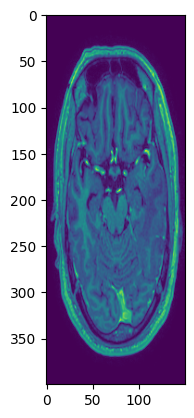

In [ ]:
idx=190

train = train_load[:,idx,:]
plt.imshow(train)
plt.show()

In [ ]:
train_load = nib.load('/content/final_data1/RADIOMICS/new_folder/RADIOMICS_138_PROG/Resize/3DFSPGR.nii.gz').get_fdata()
train_load.shape


(256, 256, 400)

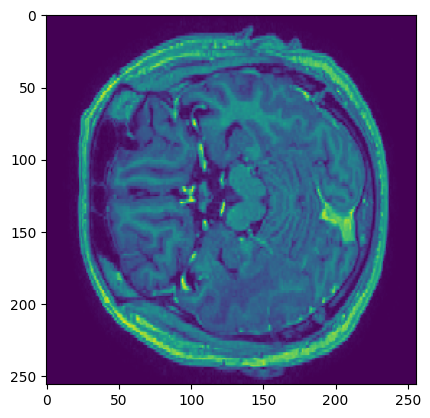

In [ ]:

train = train_load[:,:,idx]
plt.imshow(train)
plt.show()

In [ ]:

train_load = nib.load('/content/final_data1/RADIOMICS/new_folder/RADIOMICS_138_PROG/Resize_seg/Segmentation.nii.gz').get_fdata()
train_load.shape


(256, 256, 400)

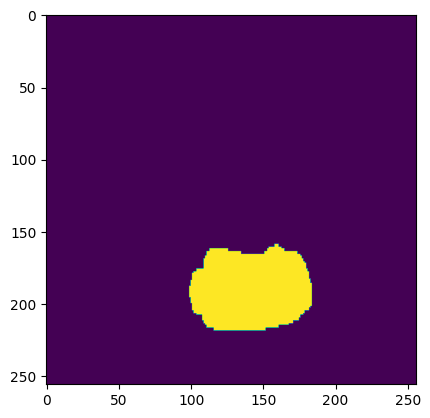

In [ ]:

train = train_load[:,:, idx]
plt.imshow(train)
plt.show()

In [ ]:
#Mask List




# for idx, fold_path in enumerate(folder_list):

#   img_p= "Segmentation/Segmentation.nii.gz"
#   mid= "Resize_seg"
#   out_filename= "Segmentation.nii.gz"

#   img_path= os.path.join(fold_path, img_p)
#   out_path = os.path.join(fold_path, mid ,out_filename)

#   print(img_path)


#   f= img_path.split('_')

#   i= int(f[3])

#   if i in lst:
#     # print("True", type(i))

#     img= nib.load(img_path).get_fdata()
#     print(img.shape, "Before")
#     img= img.transpose(1,2, 0)
#     print(img.shape, "After")

#     img_rz= __resize_data__(img, input_H= 256, input_W= 256)

#     print(img_rz.shape, "After resizing")

#     img_rz= img_rz.transpose(0,2, 1)

#     print(img_rz.shape, "After transposing")

#     img_itk = sitk.GetImageFromArray(img_rz.astype(np.float32))

#     sitk.WriteImage(img_itk, out_path)



#     # img_rz.to_file(out_path)

#   else:


#     img= nib.load(img_path).get_fdata()

#     img= img.transpose(2,1, 0)

#     print(img.shape,"Initial image")

#     img_rz= __resize_data__(img, input_H= 256, input_W= 256)

#     img_rz= img_rz.transpose(0,1, 2)

#     print(img_rz.shape, "After resizing")

#     img_itk = sitk.GetImageFromArray(img_rz.astype(np.float32))

#     sitk.WriteImage(img_itk, out_path)





/content/final_data/RADIOMICS/new_folder/RADIOMICS_01_PROG/Segmentation/Segmentation.nii.gz
(50, 320, 320) Initial image
(50, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_02_RTN/Segmentation/Segmentation.nii.gz
(160, 512, 512) Initial image
(160, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_04_RTN/Segmentation/Segmentation.nii.gz
(82, 256, 256) Initial image
(82, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_08_PROG/Segmentation/Segmentation.nii.gz
(75, 320, 320) Initial image
(75, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_09_PROG/Segmentation/Segmentation.nii.gz
(78, 256, 256) Initial image
(78, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_10_PROG/Segmentation/Segmentation.nii.gz
(66, 256, 256) Initial image
(66, 256, 256) After resizing
/content/final_data/RADIOMICS/new_folder/RADIOMICS_12_RTN/Segmentation/Segmentation.nii.gz
(17

In [ ]:

train_load = nib.load('/content/final_data/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize_seg/Segmentation.nii.gz').get_fdata()
train_load.shape

(256, 256, 50)

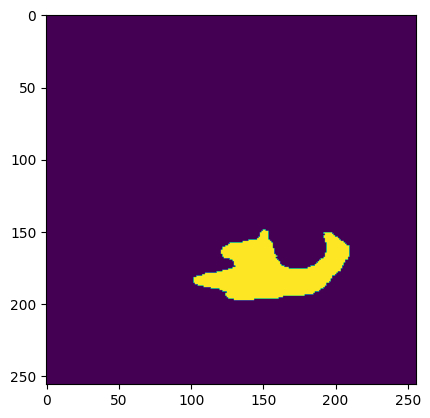

In [ ]:

train = train_load[:,:, 25]
plt.imshow(train)
plt.show()

In [ ]:

train_load = nib.load('/content/final_data/RADIOMICS/new_folder/RADIOMICS_01_PROG/Strip/3DFSPGR.nii.gz').get_fdata()
train_load.shape

(50, 256, 256)

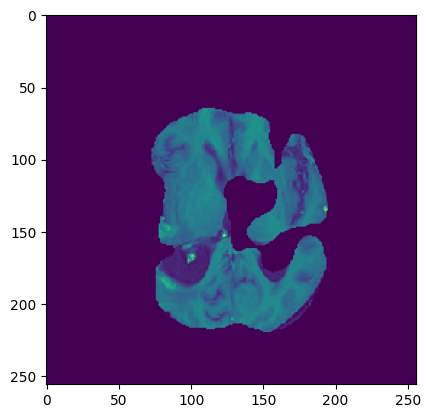

In [ ]:

train = train_load[25,:,:]
plt.imshow(train)
plt.show()

In [ ]:
print(img_list[0])
print(mask_list[0])

/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize/3DFSPGR.nii.gz
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize_seg/Segmentation.nii.gz


In [ ]:
df_res= pd.DataFrame(columns= ['Id', 'Sequence' , 'Image_Path', "Mask_Path" ,'Outcome'])

# def df_func():

num= 0

folder_list= natsorted(folder_list)

for idx, val in enumerate(folder_list):

  f= val.split('_')
  # print(f)

  img_list= glob.glob(folder_list[idx]+"/Resize/*.gz", recursive= True)

  img_list= natsorted(img_list)

  mask_list= glob.glob(img_path+"/*/Resize_seg/*.gz", recursive= True)

  mask_list= natsorted(mask_list)


  for idx_, val_ in enumerate(img_list):

    df_res.loc[num, 'Id']= f[3]
    df_res.loc[num, 'Outcome']= f[4]
    df_res.loc[num,'Image_Path']= val_
    df_res.loc[num, 'Mask_Path']= mask_list[idx]
    # print(val_.split('_'))
    seq= val_.split('_')[4].split('/')[2].split('.')[0]
    # print(seq)
    df_res.loc[num,'Sequence']= seq


    num+=1












['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '01', 'PROG']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '02', 'RTN']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '04', 'RTN']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '08', 'PROG']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '09', 'PROG']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '10', 'PROG']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '12', 'RTN']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '13', 'RTN']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '16', 'RTN']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '17', 'RTN']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '18', 'PROG']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '19', 'PROG']
['/content/final', 'data1/RADIOMICS/new', 'folder/RADIOMICS', '24', 'PROG']
['/content/final',

In [ ]:

df_res

,Id,Sequence,Image_Path,Mask_Path,Outcome
0,01,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,PROG
1,02,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,RTN
2,04,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,RTN
3,08,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,PROG
4,09,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,PROG
...,...,...,...,...,...
130,246,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,RTN
131,247,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,RTN
132,248,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,RTN
133,249,3DFSPGR,/content/final_data1/RADIOMICS/new_folder/RADI...,/content/final_data1/RADIOMICS/new_folder/RADI...,RTN


In [ ]:
df_res.loc[0,'Image_Path']


'/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize/3DFSPGR.nii.gz'

In [ ]:

df_res.loc[0, 'Mask_Path']

'/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize_seg/Segmentation.nii.gz'

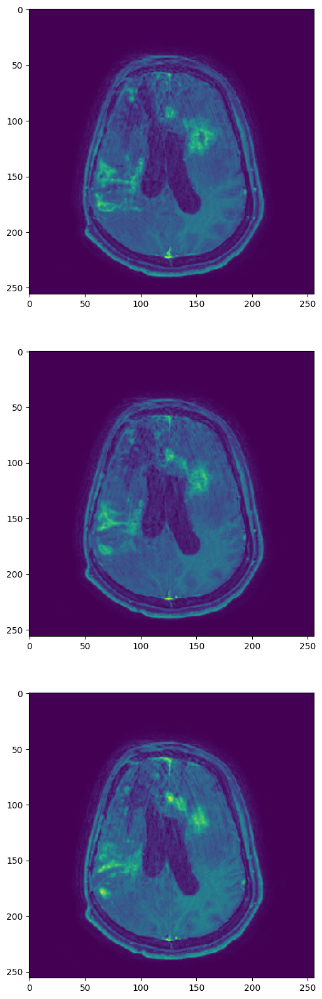

In [ ]:
img_sitk = df_res['Image_Path'][7]

img_sitk = sitk.ReadImage(img_sitk)

img_sitk = sitk.GetArrayFromImage(img_sitk)

# train = img_sitk[index, :, :]


ncols = 1
nrows = 3
fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize= (20, 20))
for index, axi in enumerate(ax.flat):
  index= index+50
  train = img_sitk[index, :, :]
  axi.imshow(train)
plt.show()




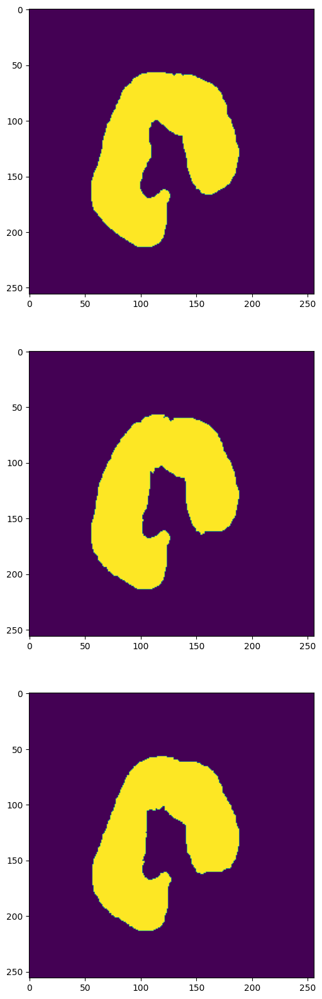

In [ ]:
mask_sitk = df_res['Mask_Path'][7]

  # Read the .nii image containing the volume with SimpleITK:
mask_sitk = sitk.ReadImage(mask_sitk)

# and access the numpy array:
mask_sitk = sitk.GetArrayFromImage(mask_sitk)

mask_sitk= mask_sitk.clip(0,1).astype(np.uint8)

ncols = 1
nrows = 3
fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize= (20, 20))
for index, axi in enumerate(ax.flat):
  index= index+50
  train = mask_sitk[index, :, :]
  axi.imshow(train)
plt.show()


INFO:radiomics.featureextractor:Loading parameter file /content/tumor.yaml


/content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_01_PROG/Resize_seg/Segmentation.nii.gz


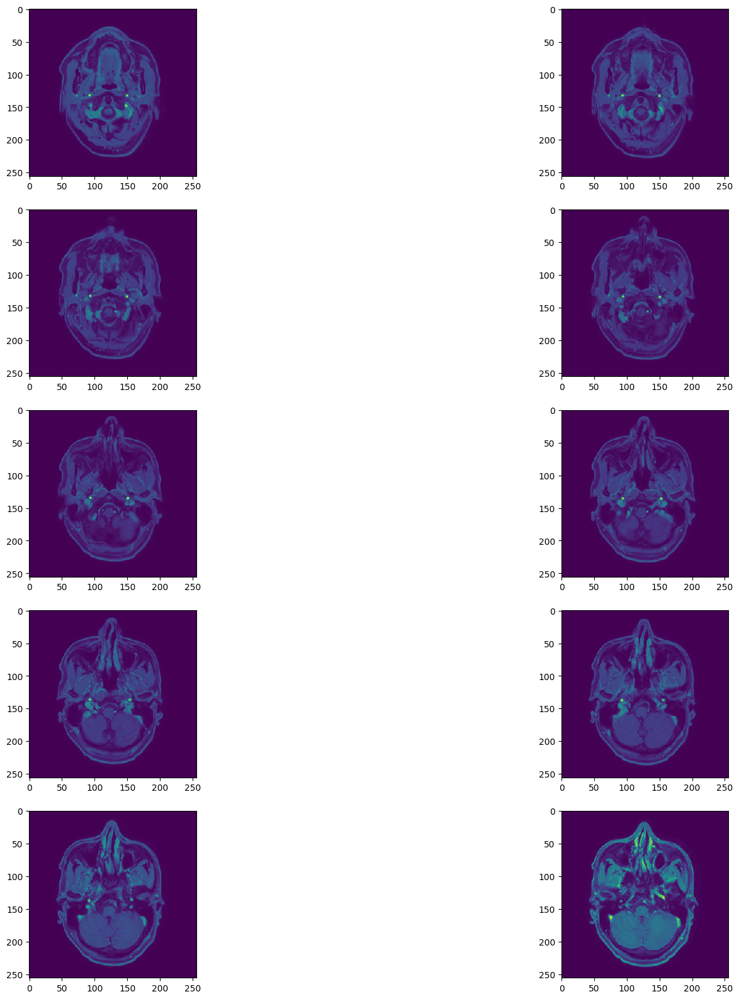

(50, 256, 256)


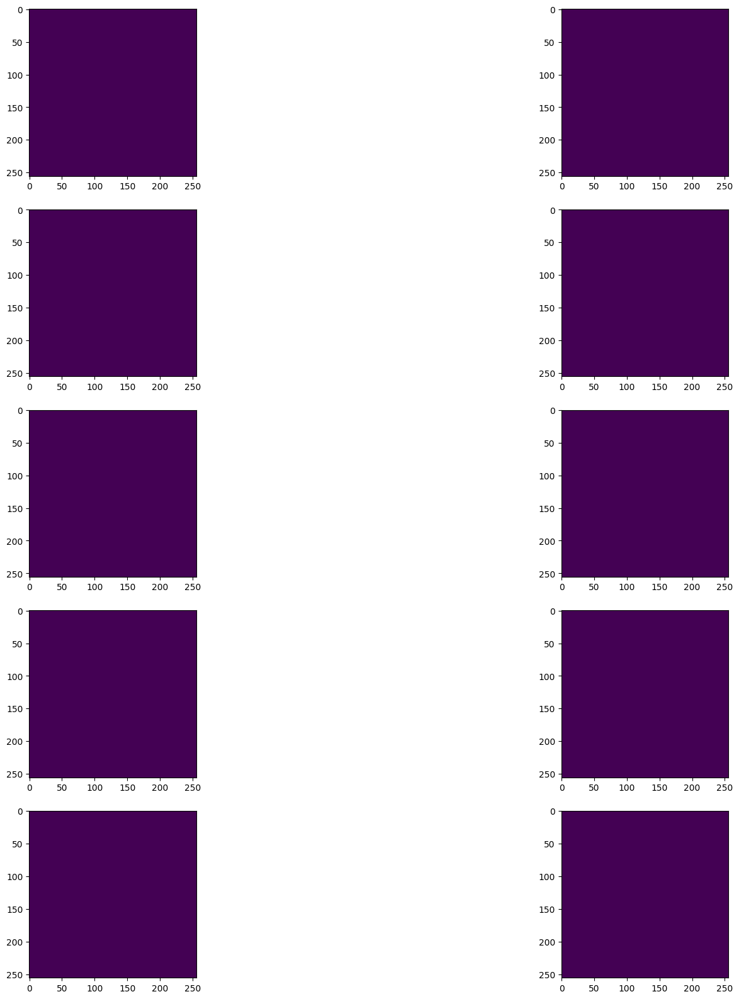

(50, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_02_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_02_RTN/Resize_seg/Segmentation.nii.gz


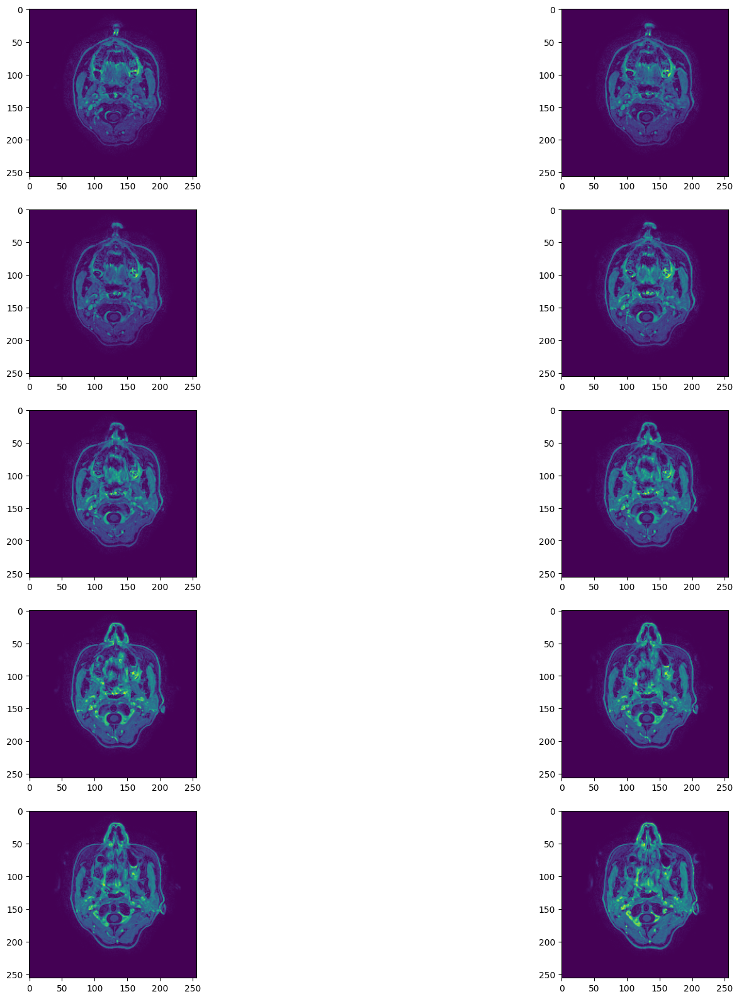

(160, 256, 256)


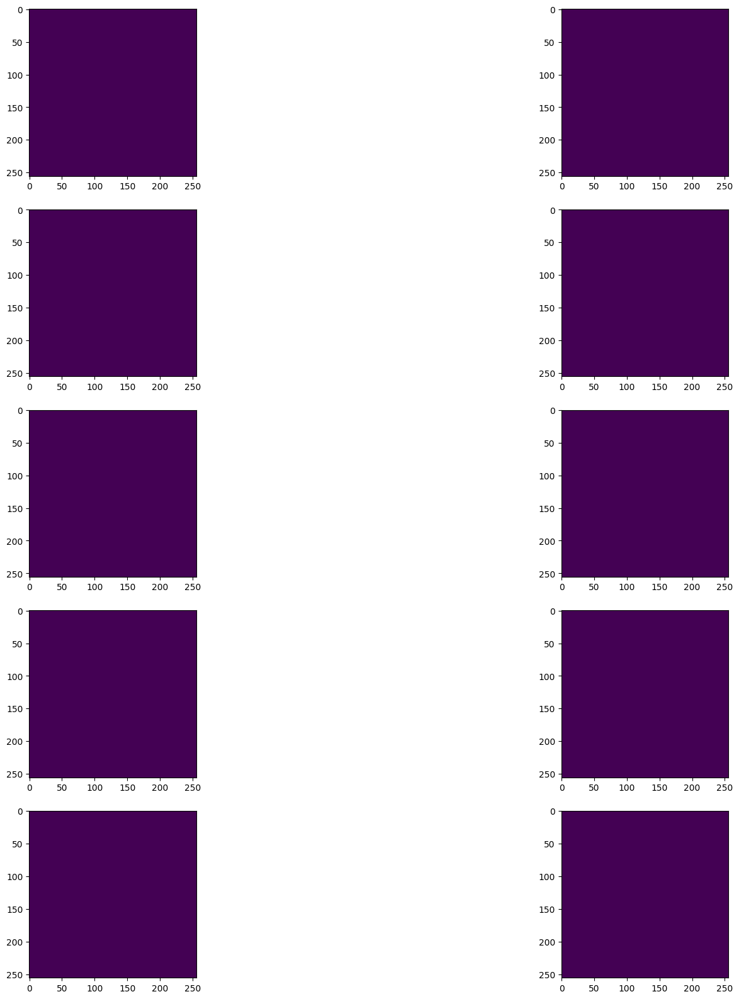

(160, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_04_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_04_RTN/Resize_seg/Segmentation.nii.gz


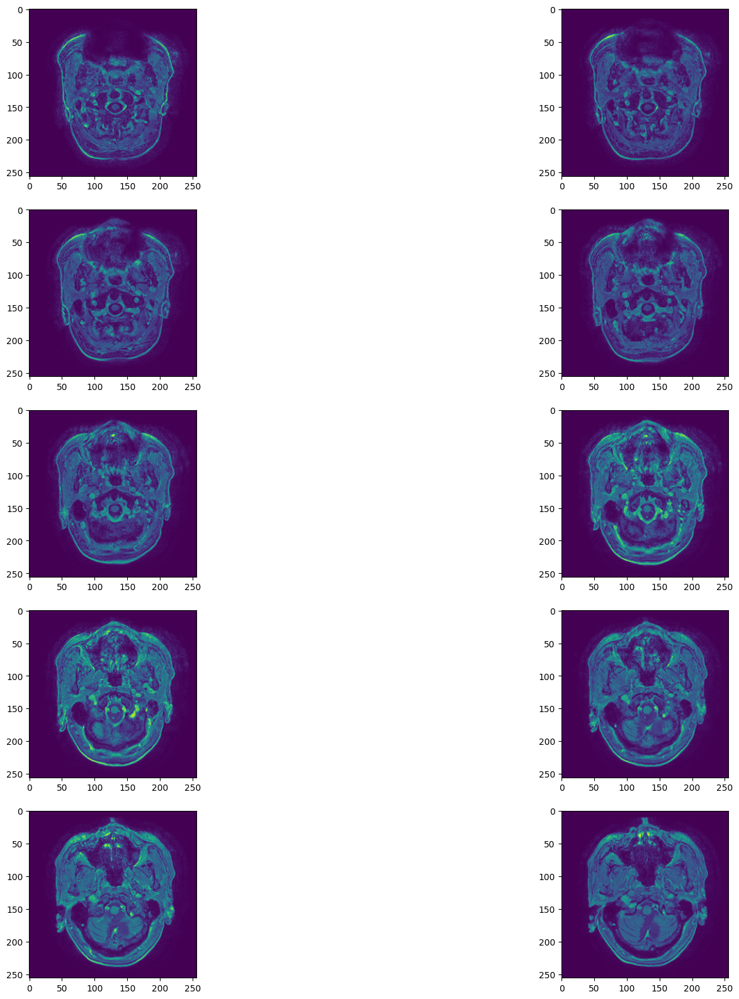

(82, 256, 256)


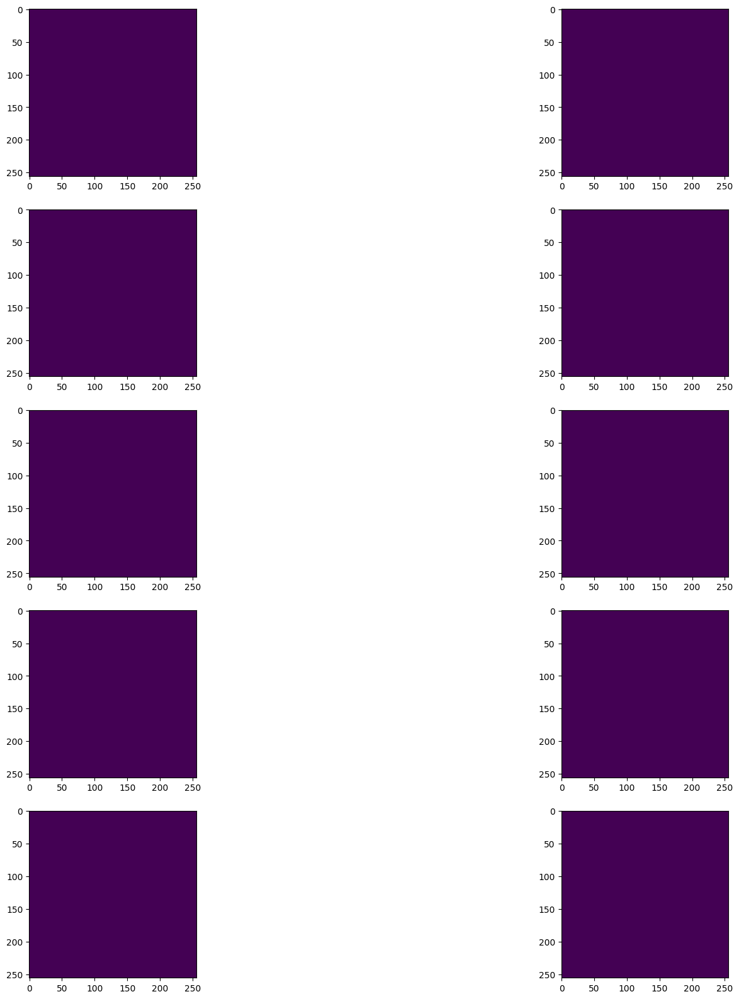

(82, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_08_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_08_PROG/Resize_seg/Segmentation.nii.gz


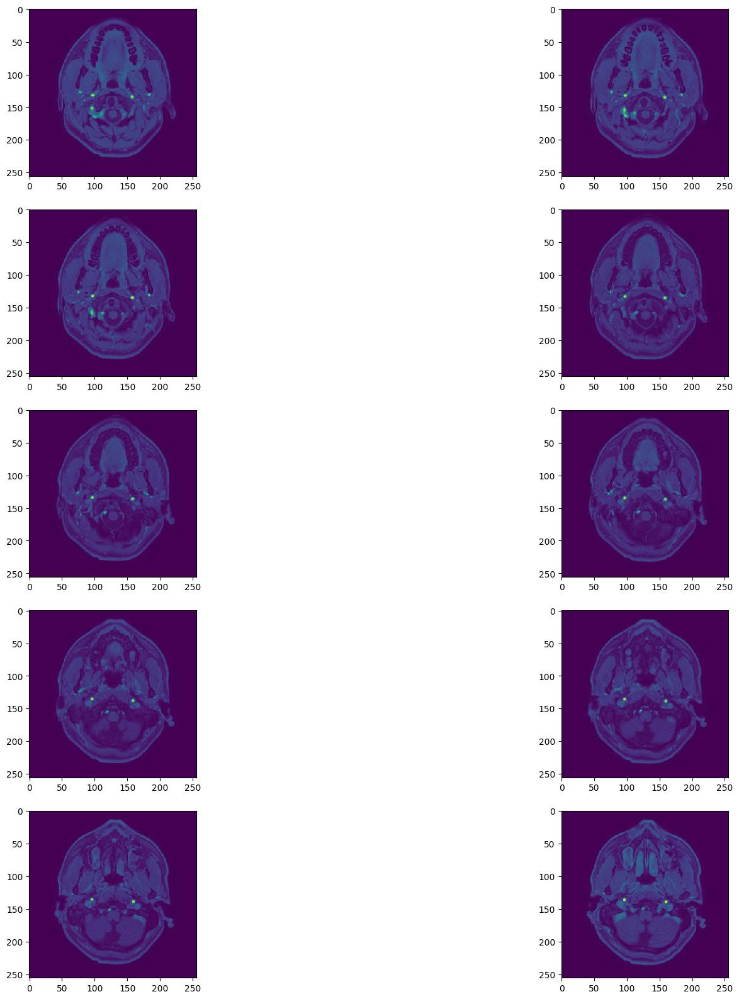

(75, 256, 256)


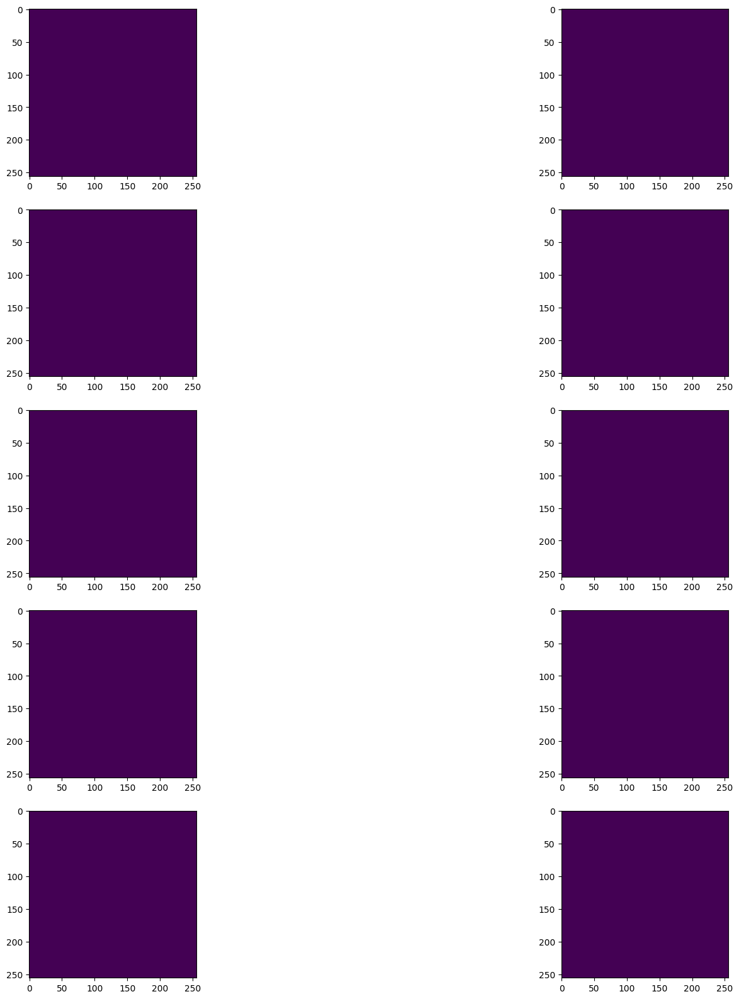

(75, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_09_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_09_PROG/Resize_seg/Segmentation.nii.gz


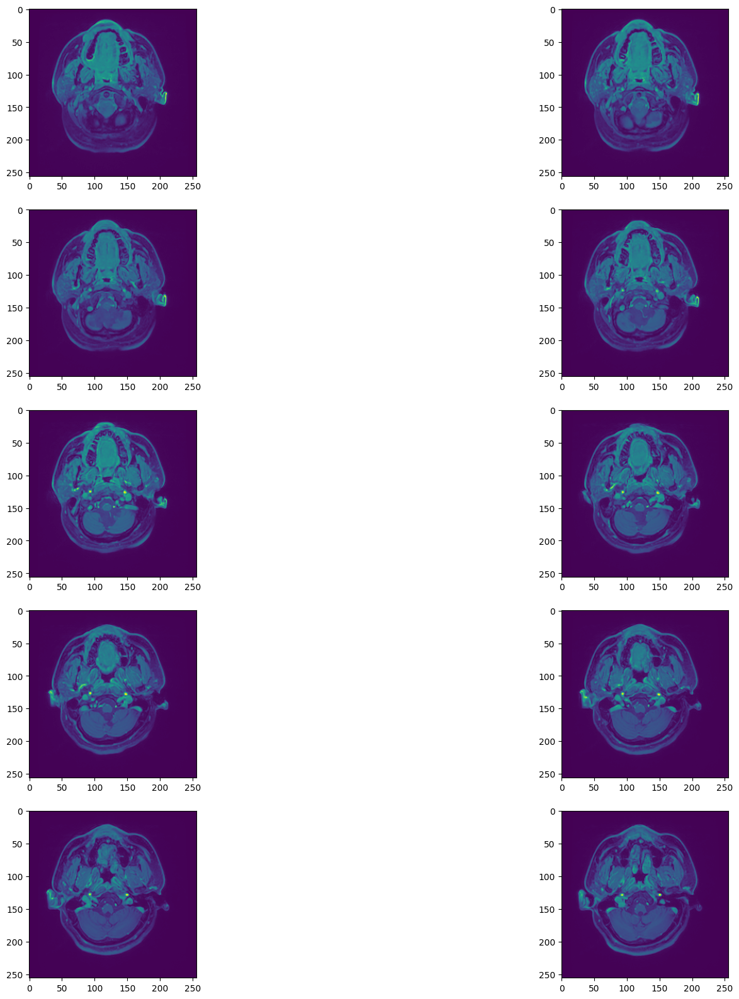

(78, 256, 256)


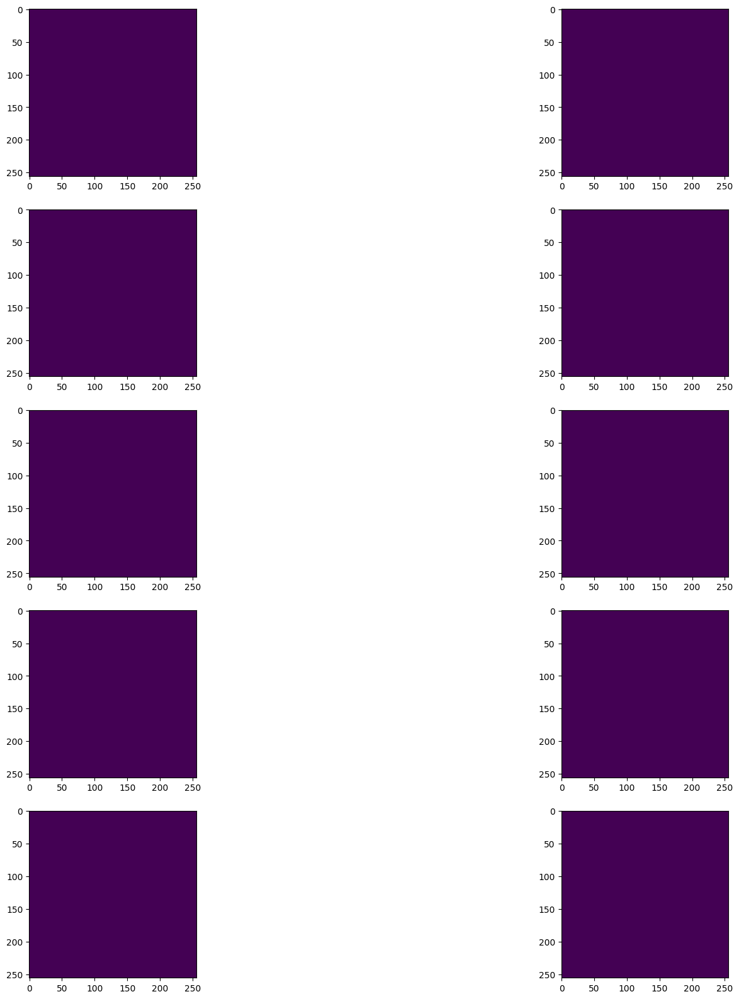

(78, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_10_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_10_PROG/Resize_seg/Segmentation.nii.gz


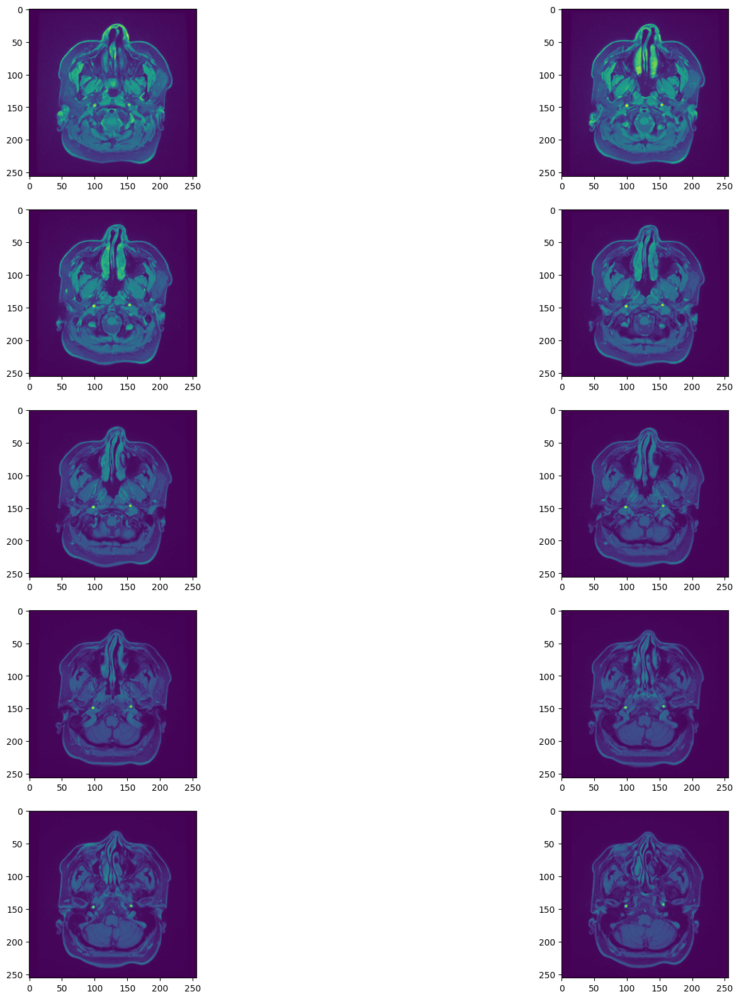

(66, 256, 256)


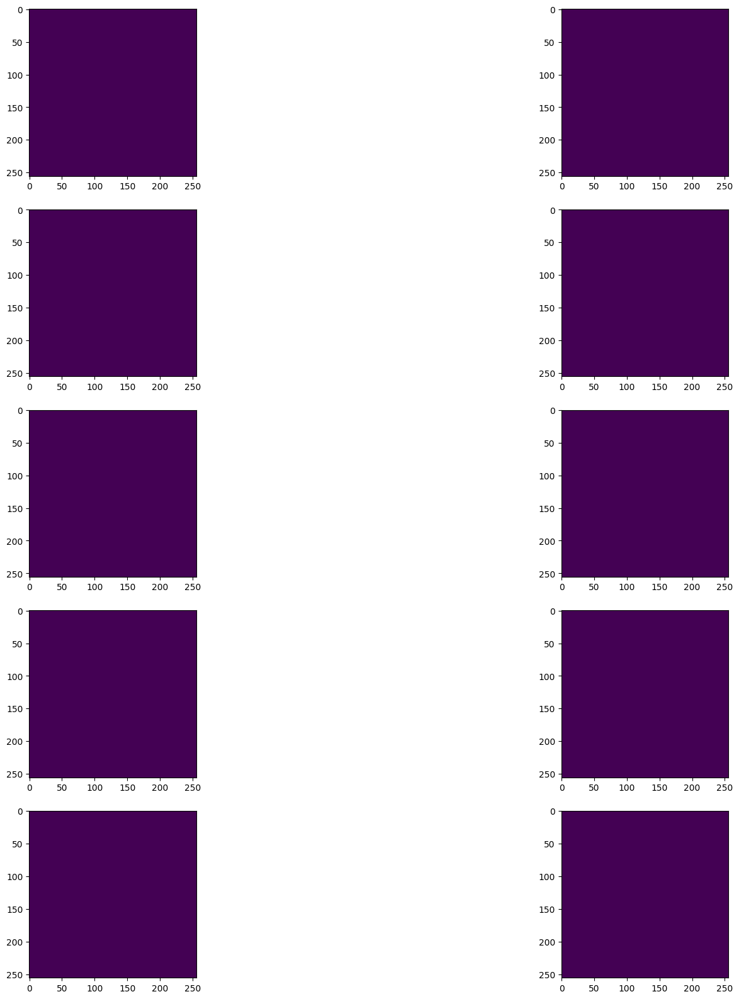

(66, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_12_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_12_RTN/Resize_seg/Segmentation.nii.gz


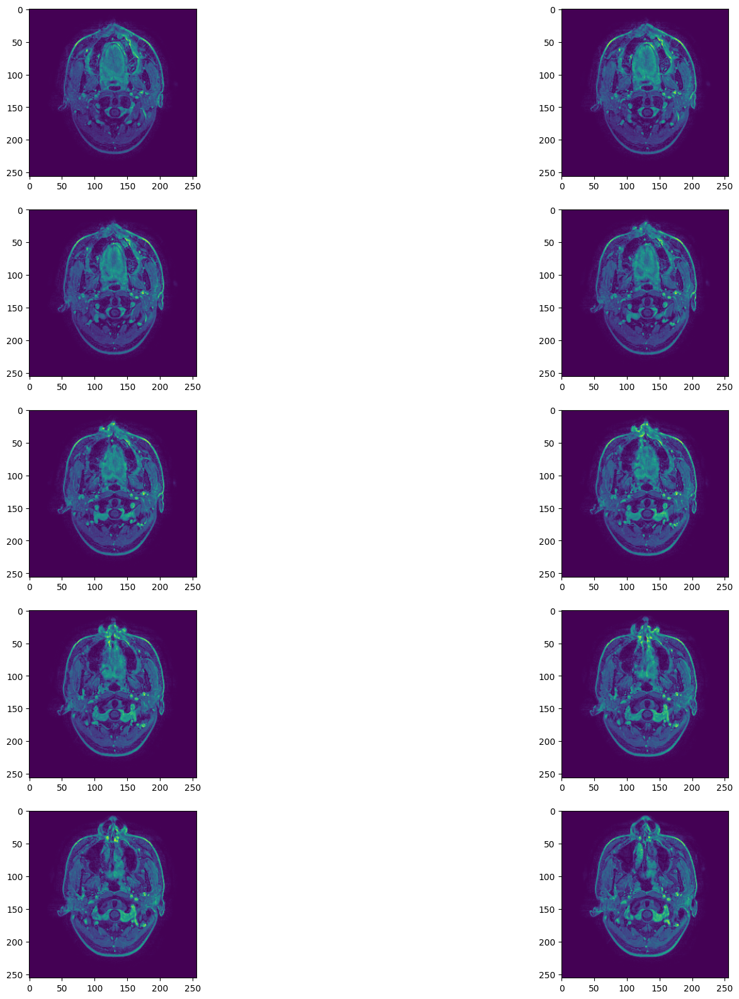

(172, 256, 256)


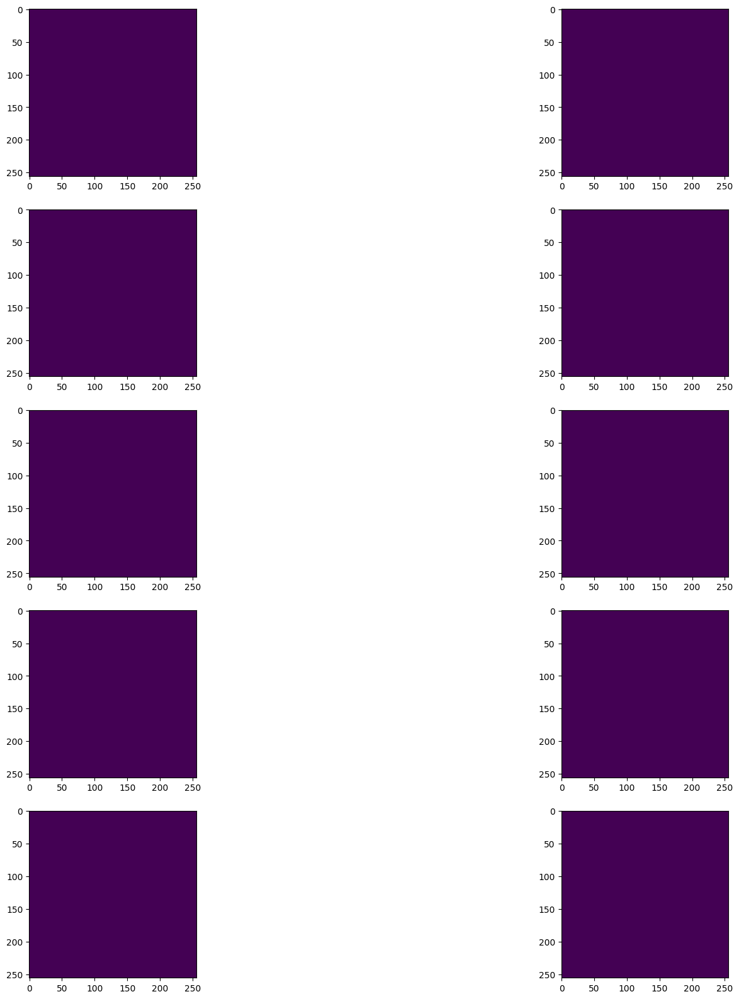

(172, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_13_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_13_RTN/Resize_seg/Segmentation.nii.gz


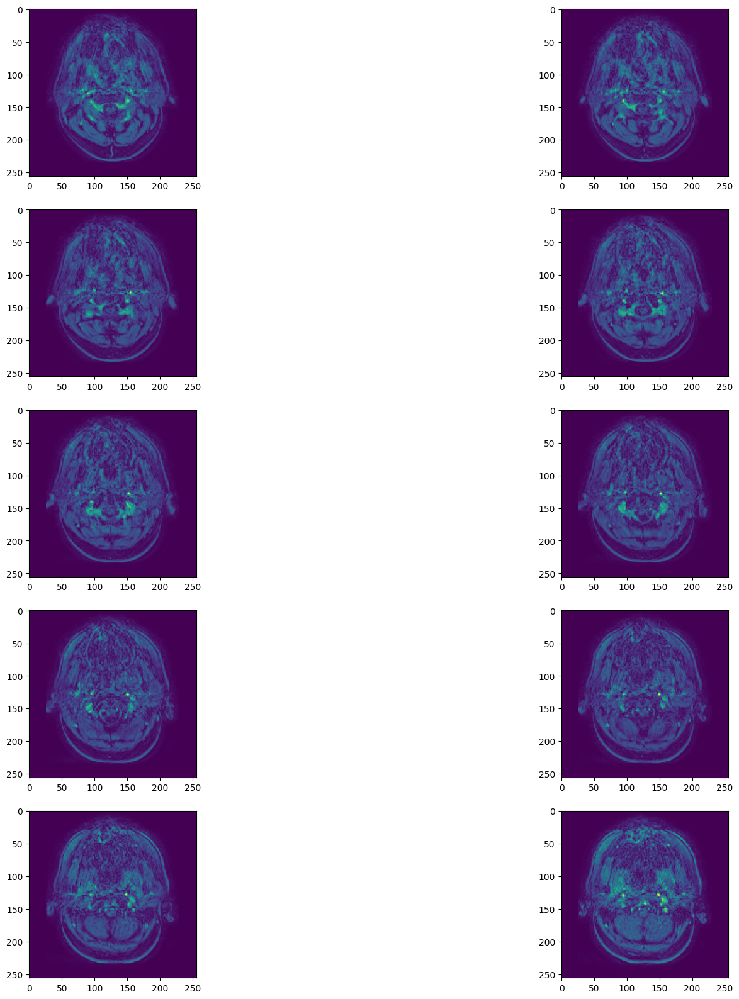

(75, 256, 256)


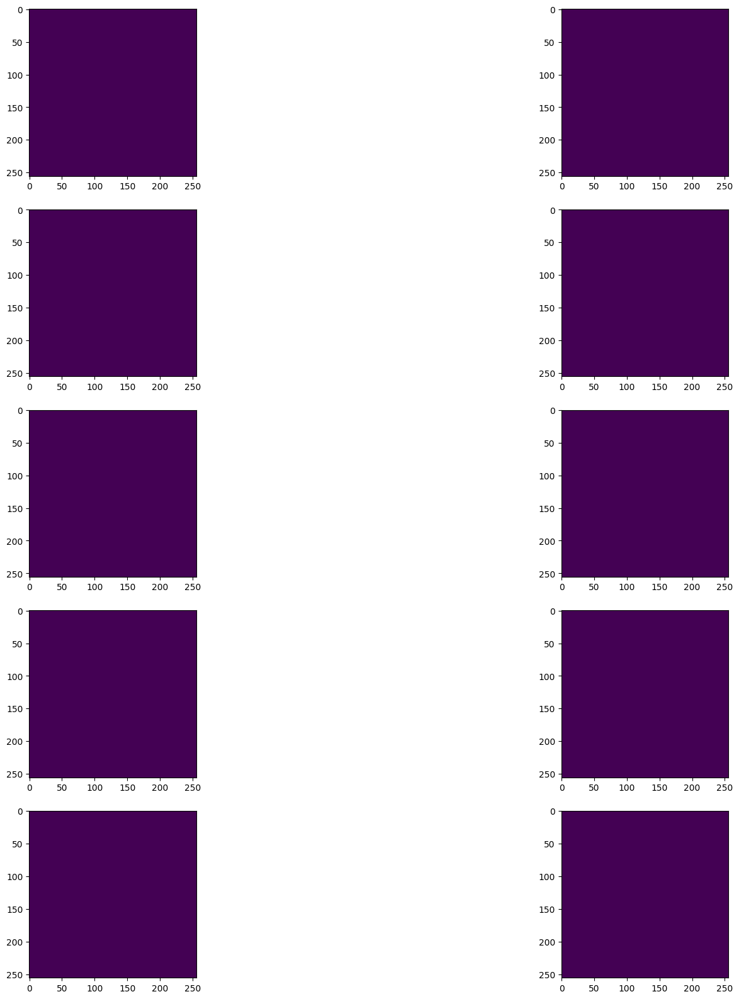

(75, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_16_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_16_RTN/Resize_seg/Segmentation.nii.gz


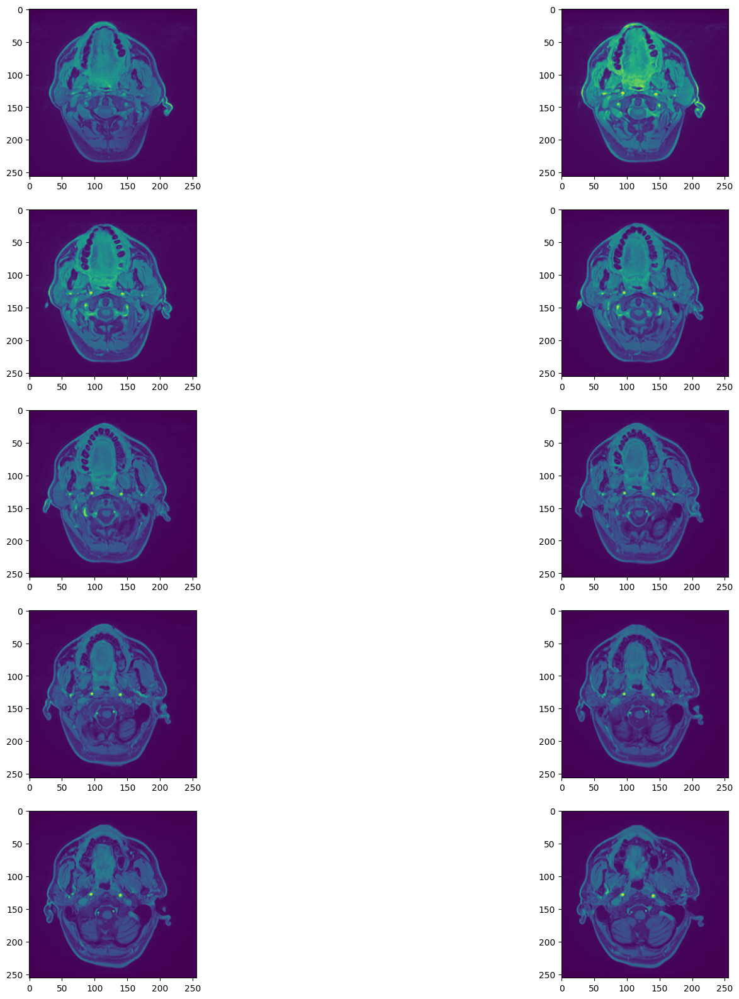

(76, 256, 256)


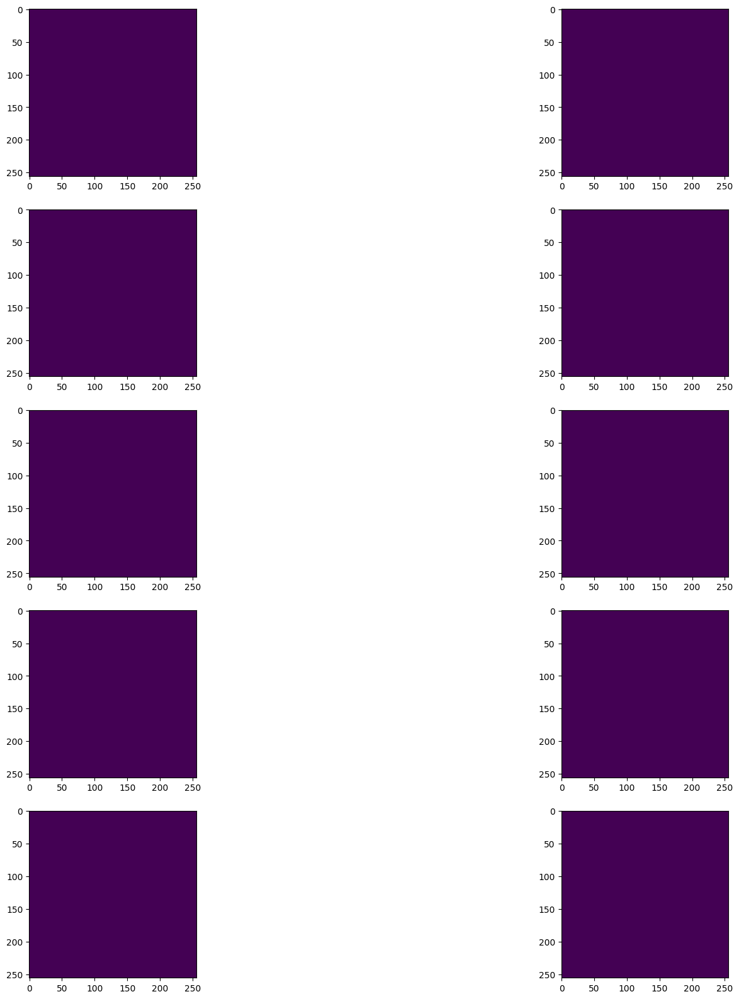

(76, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_17_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_17_RTN/Resize_seg/Segmentation.nii.gz


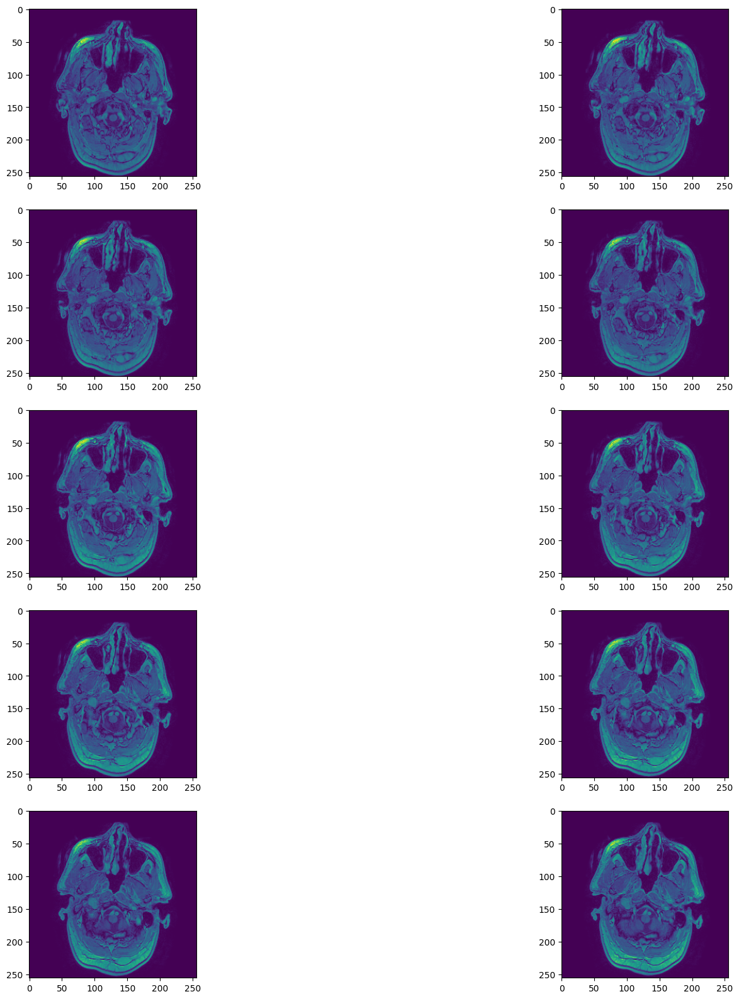

(152, 256, 256)


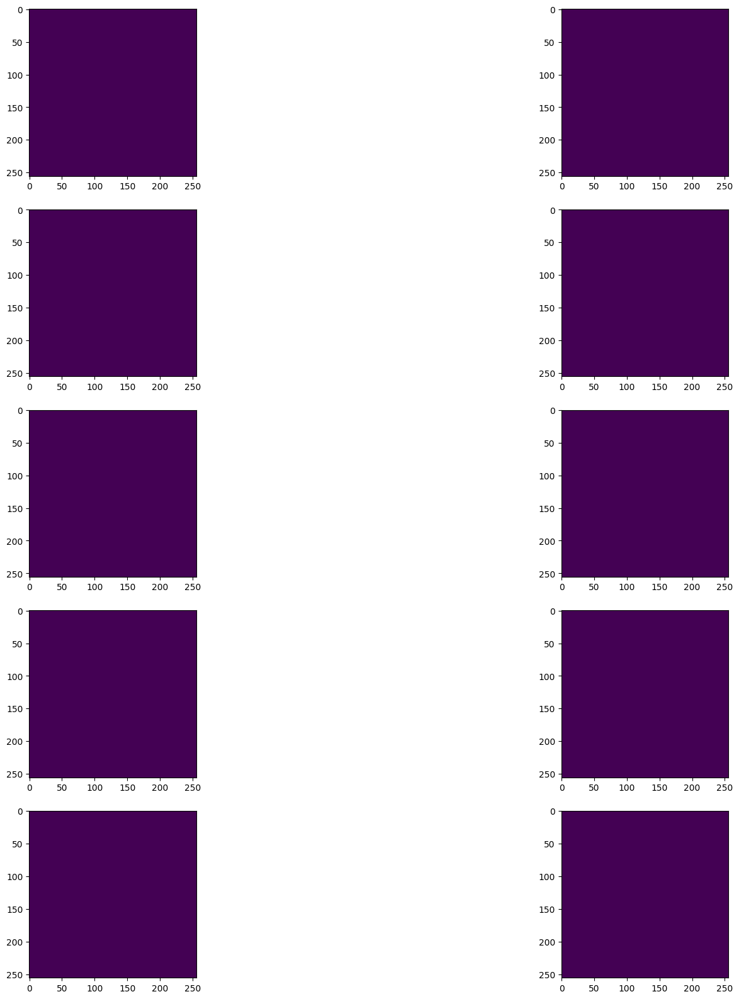

(152, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_18_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_18_PROG/Resize_seg/Segmentation.nii.gz


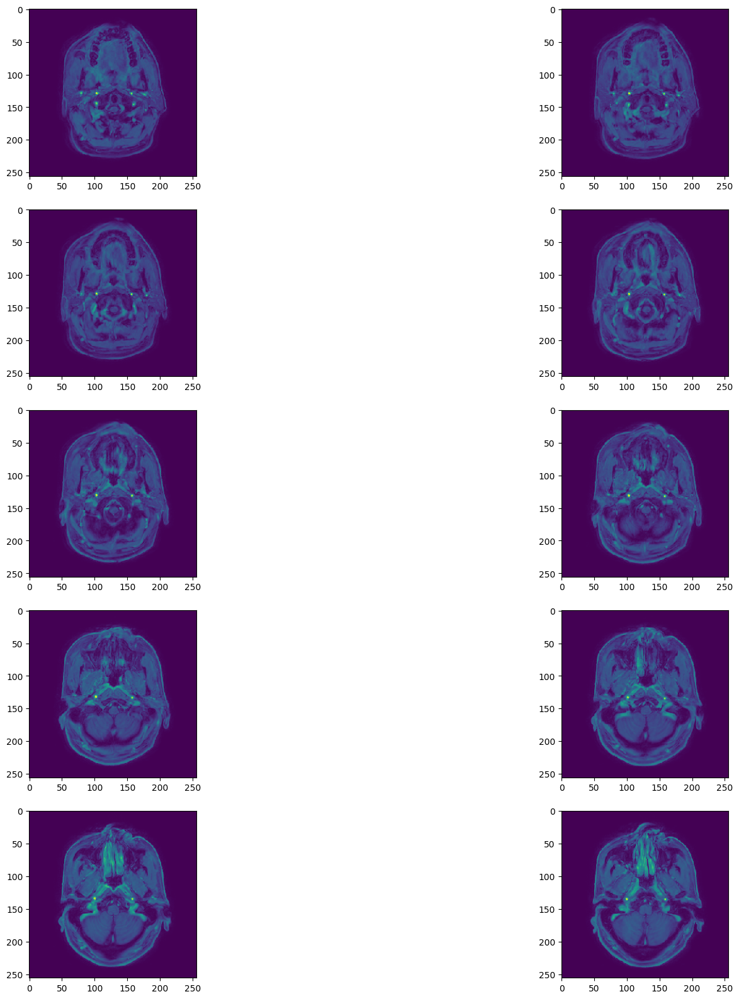

(52, 256, 256)


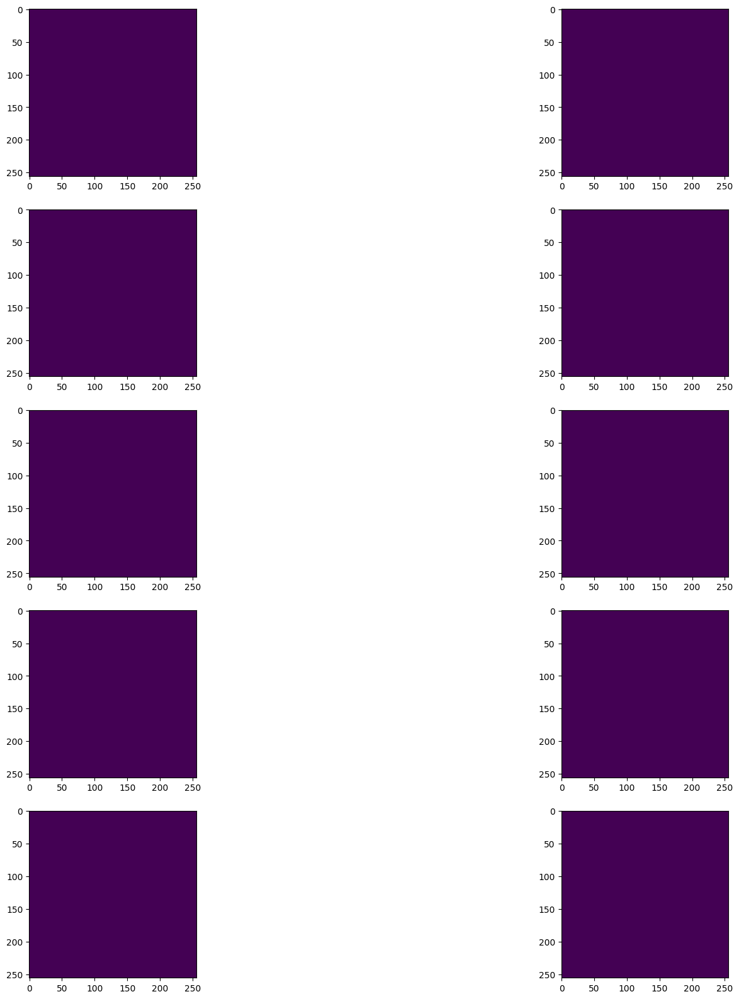

(52, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_19_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_19_PROG/Resize_seg/Segmentation.nii.gz


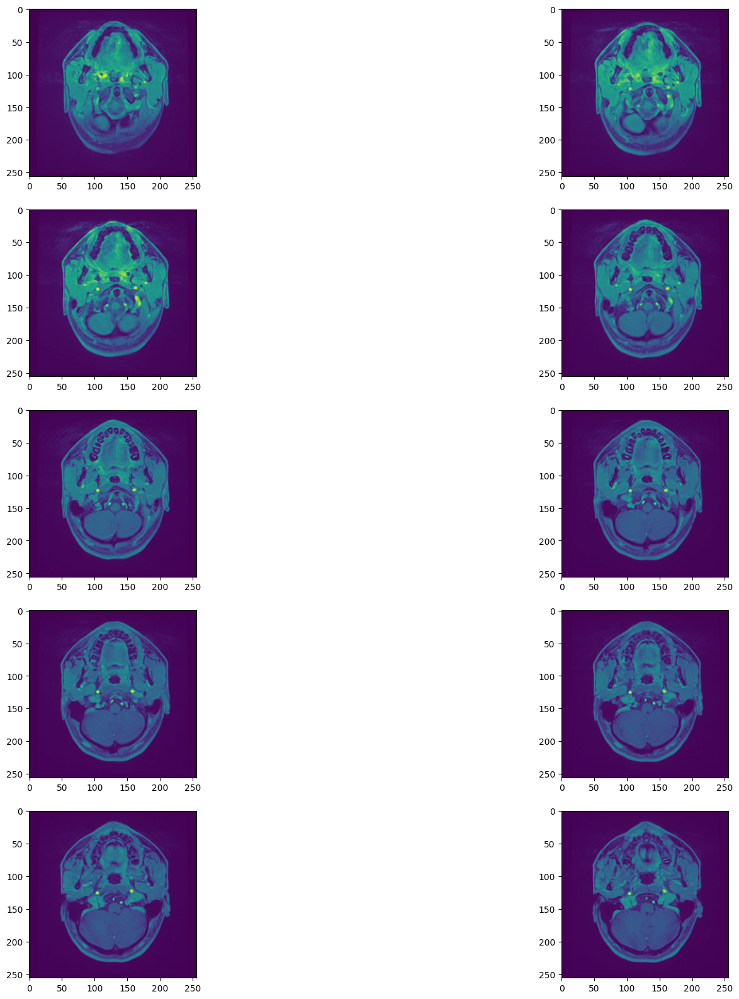

(76, 256, 256)


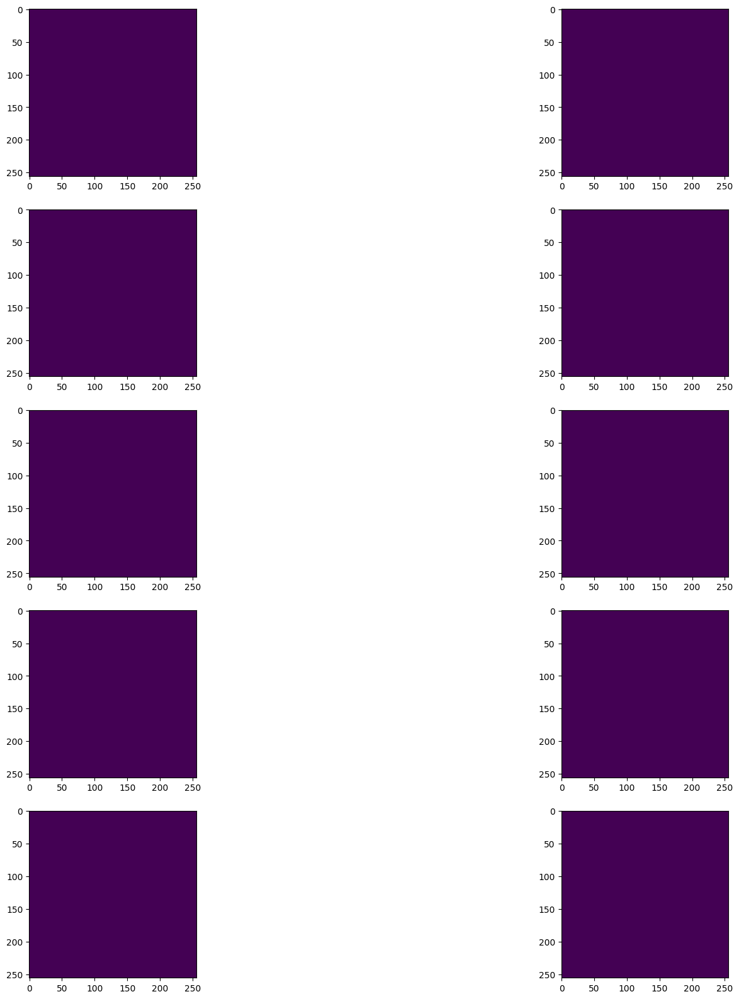

(76, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_24_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_24_PROG/Resize_seg/Segmentation.nii.gz


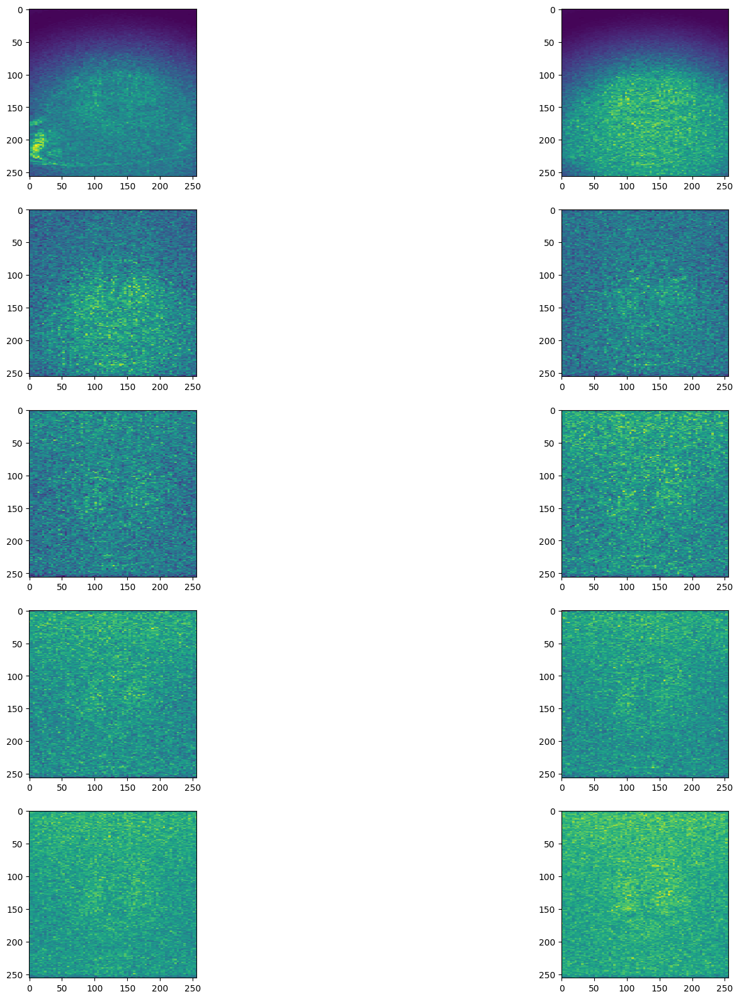

(256, 256, 256)


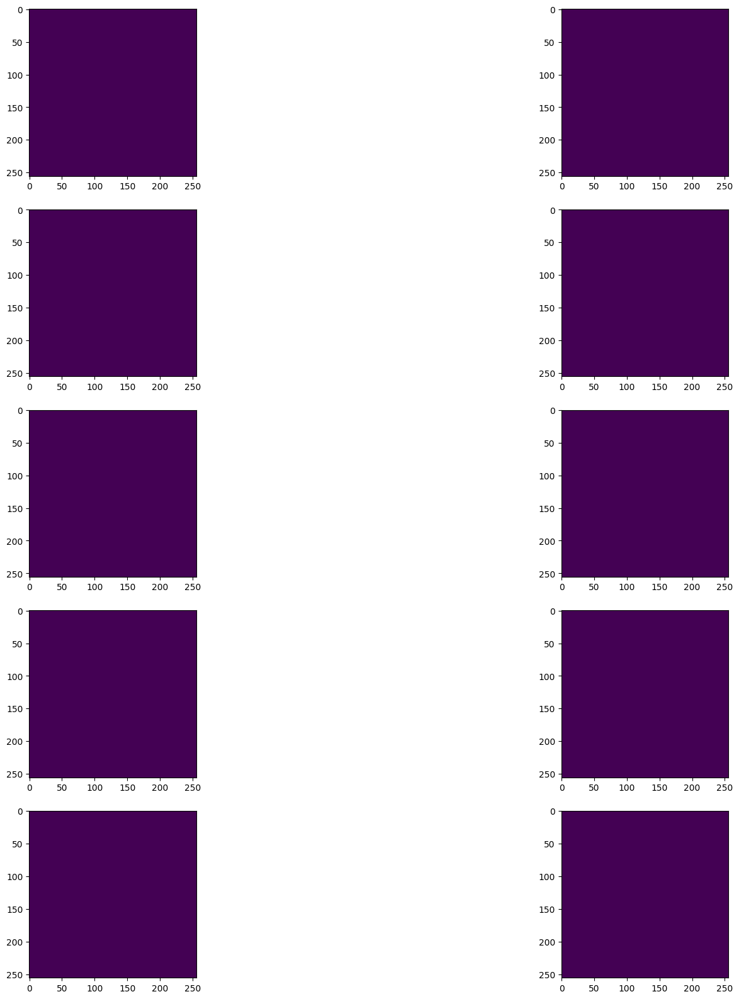

(256, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_25_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_25_PROG/Resize_seg/Segmentation.nii.gz


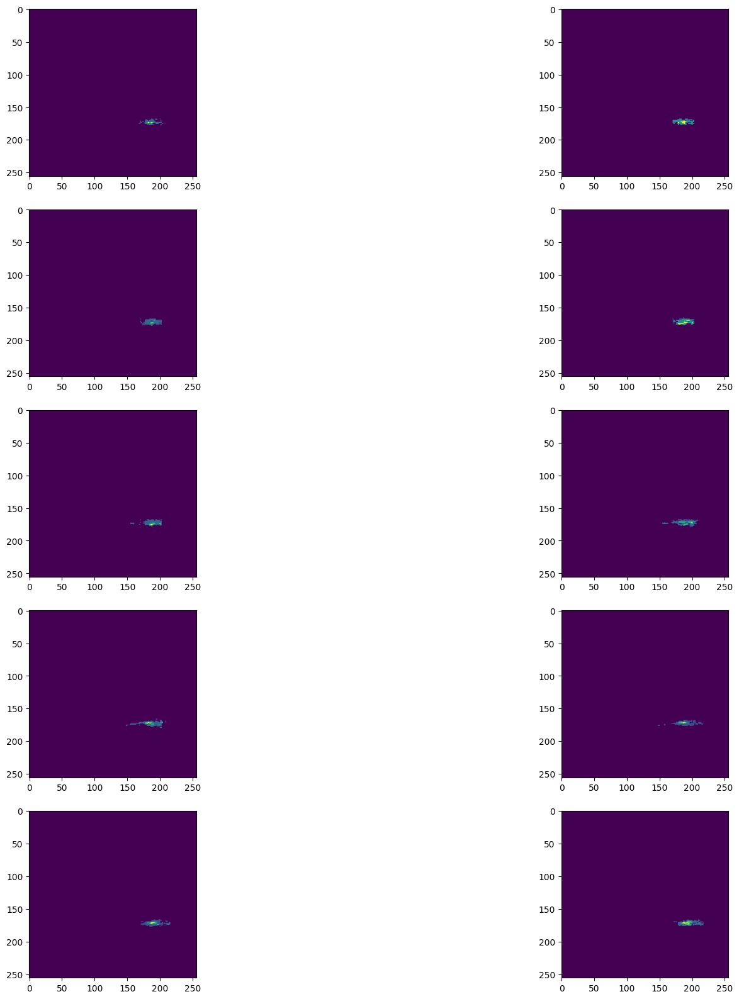

(400, 256, 256)


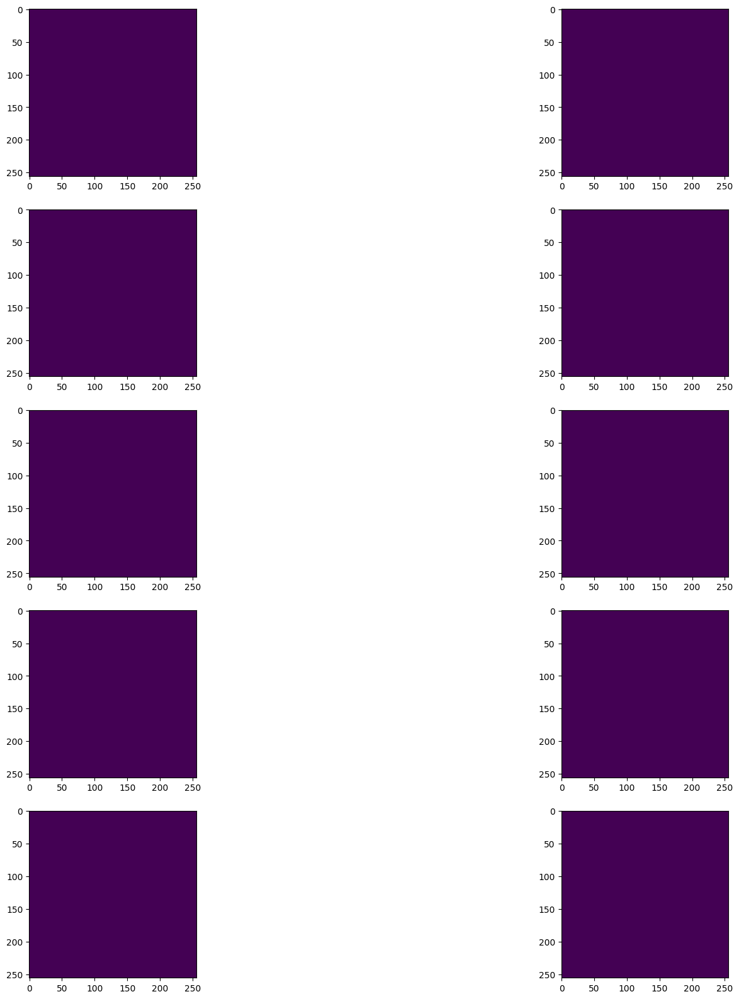

(400, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_26_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_26_PROG/Resize_seg/Segmentation.nii.gz


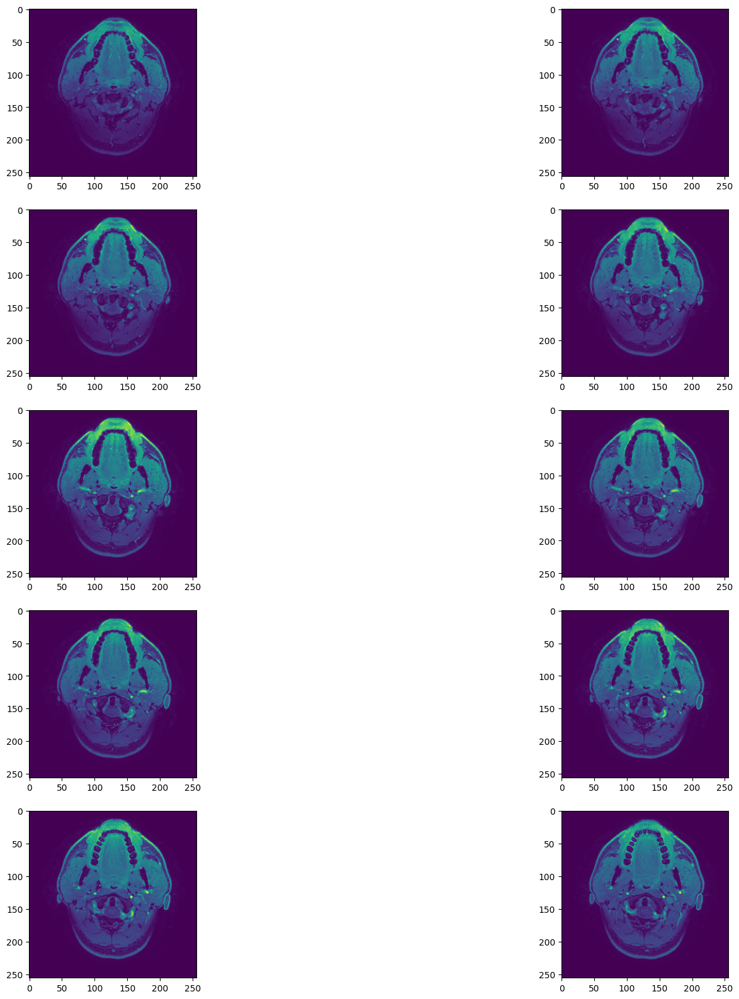

(172, 256, 256)


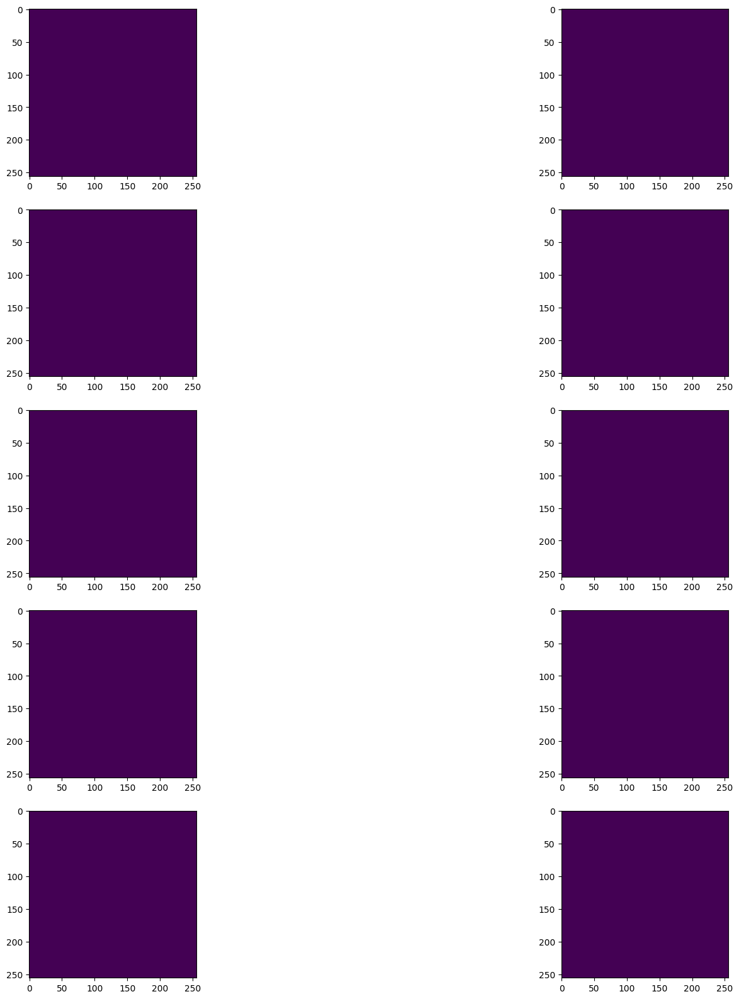

(172, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_27_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_27_RTN/Resize_seg/Segmentation.nii.gz


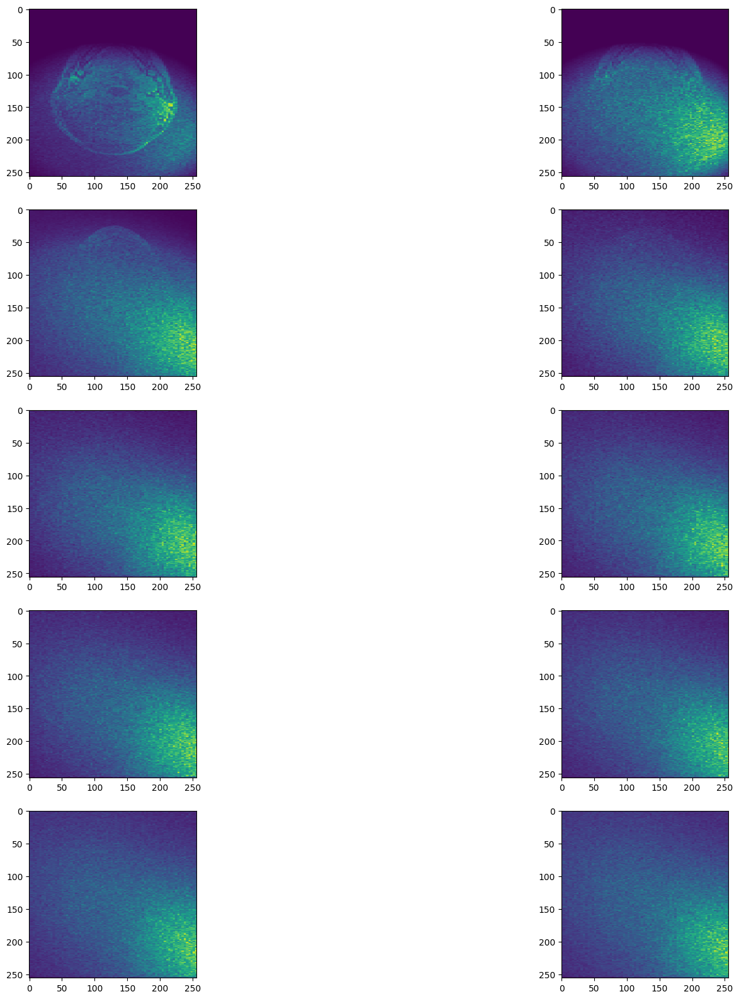

(512, 256, 256)


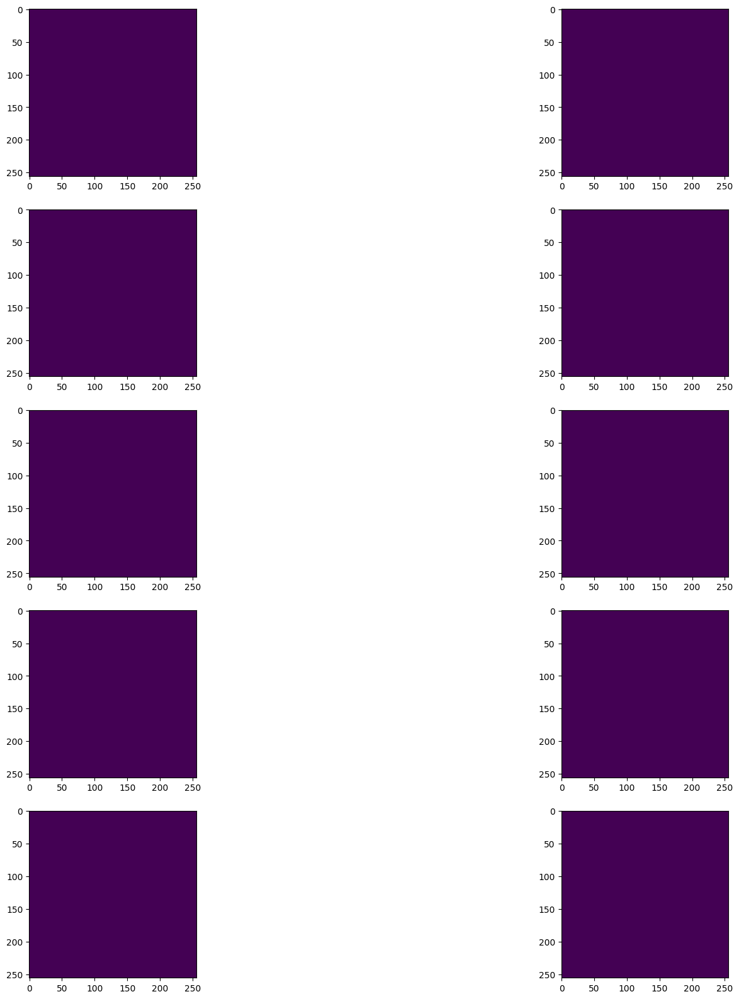

(512, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_28_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_28_PROG/Resize_seg/Segmentation.nii.gz


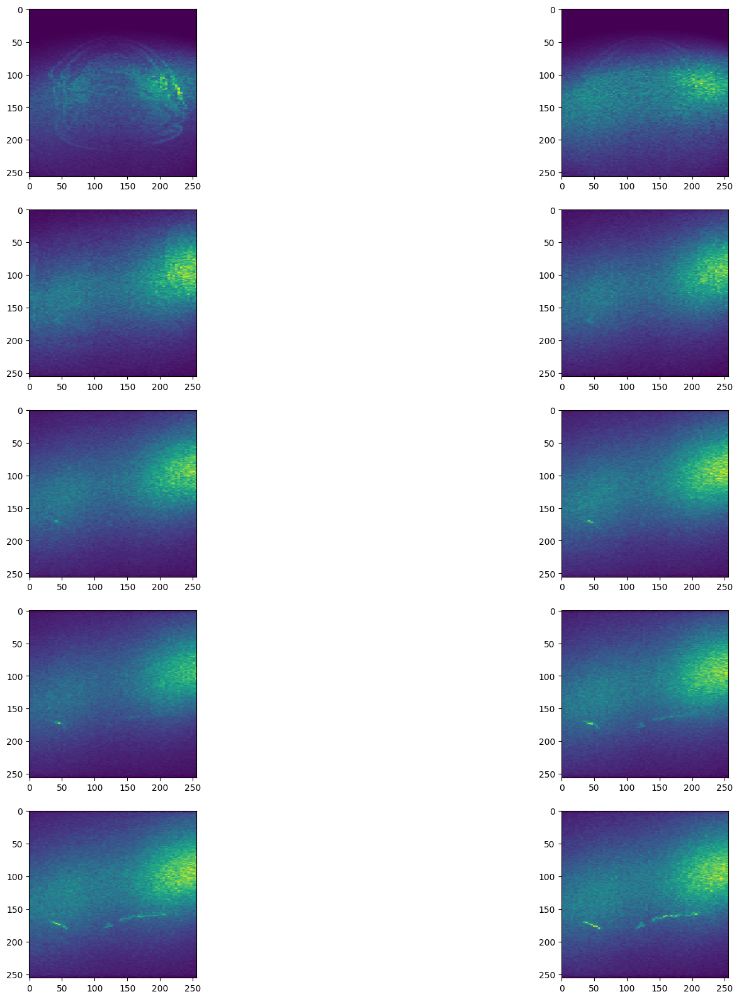

(256, 256, 256)


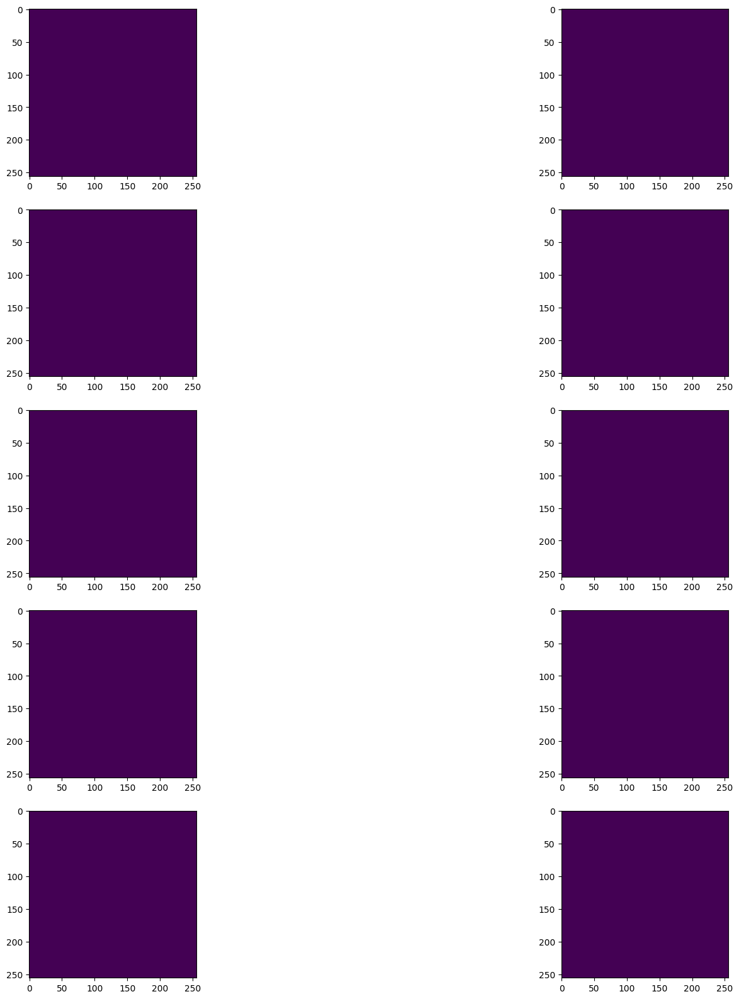

(256, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_29_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_29_PROG/Resize_seg/Segmentation.nii.gz


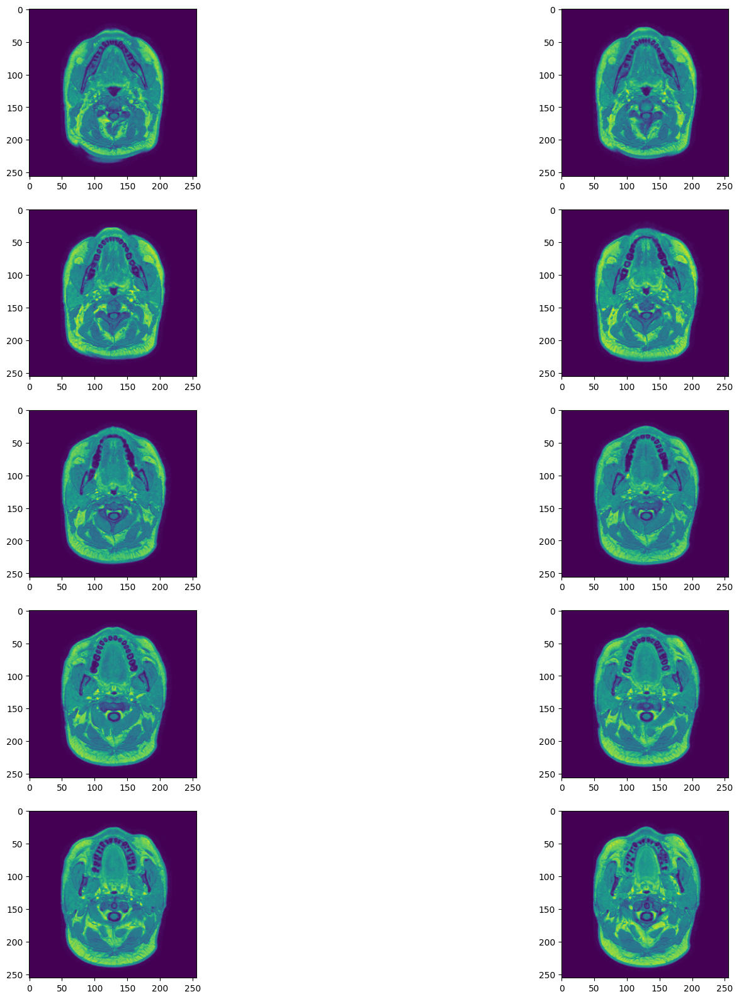

(62, 256, 256)


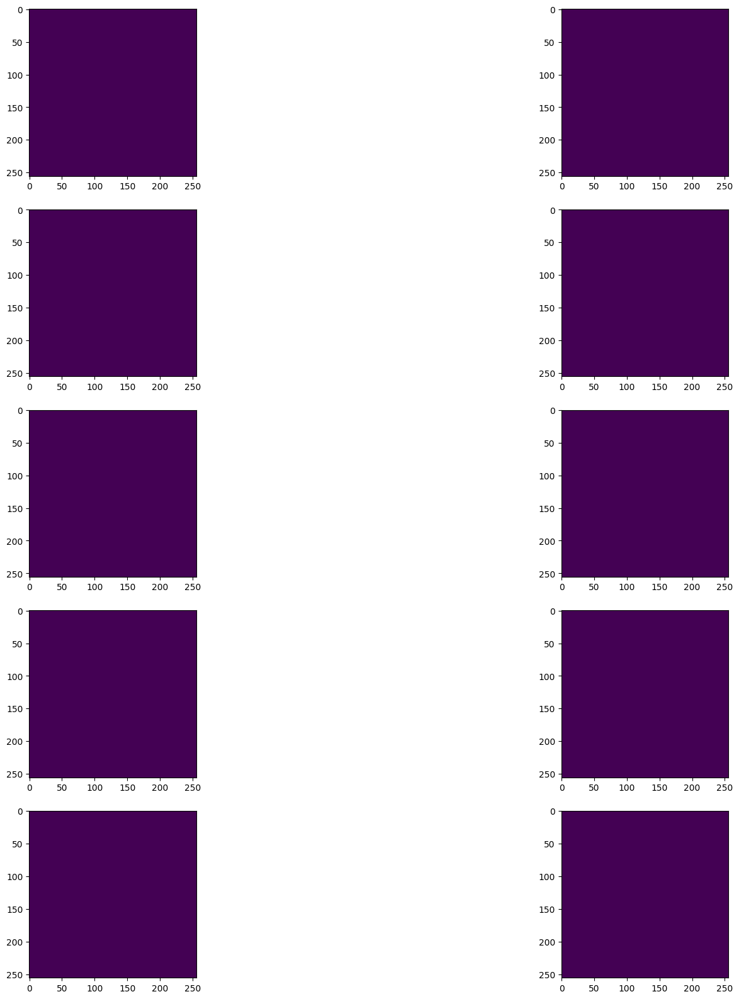

(62, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_30_RTN/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_30_RTN/Resize_seg/Segmentation.nii.gz


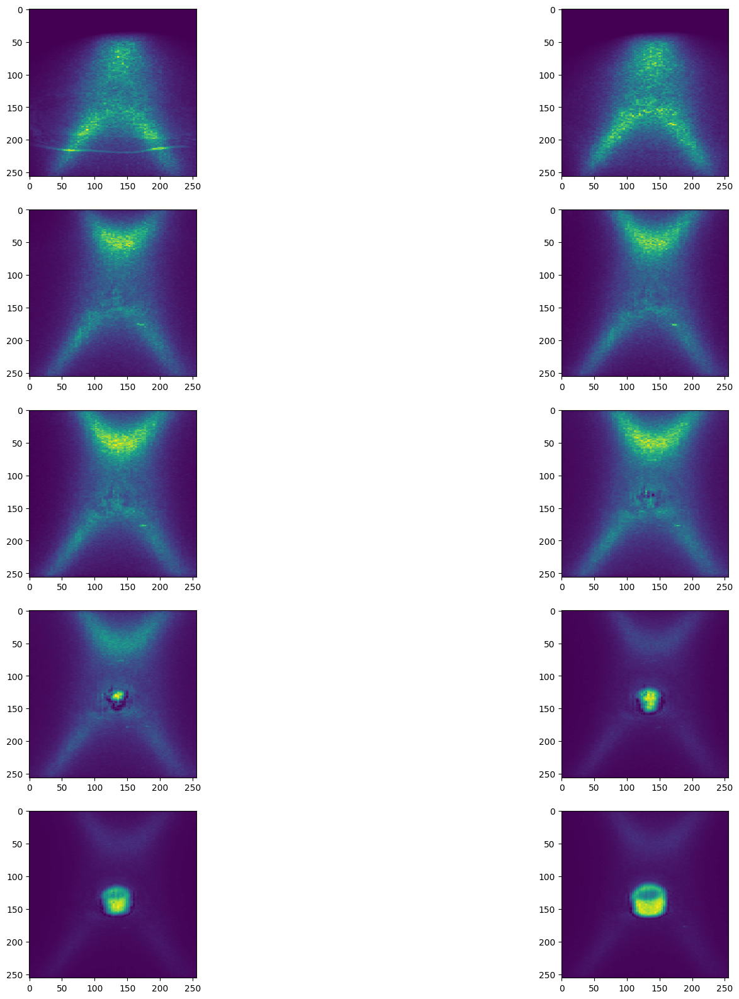

(256, 256, 256)


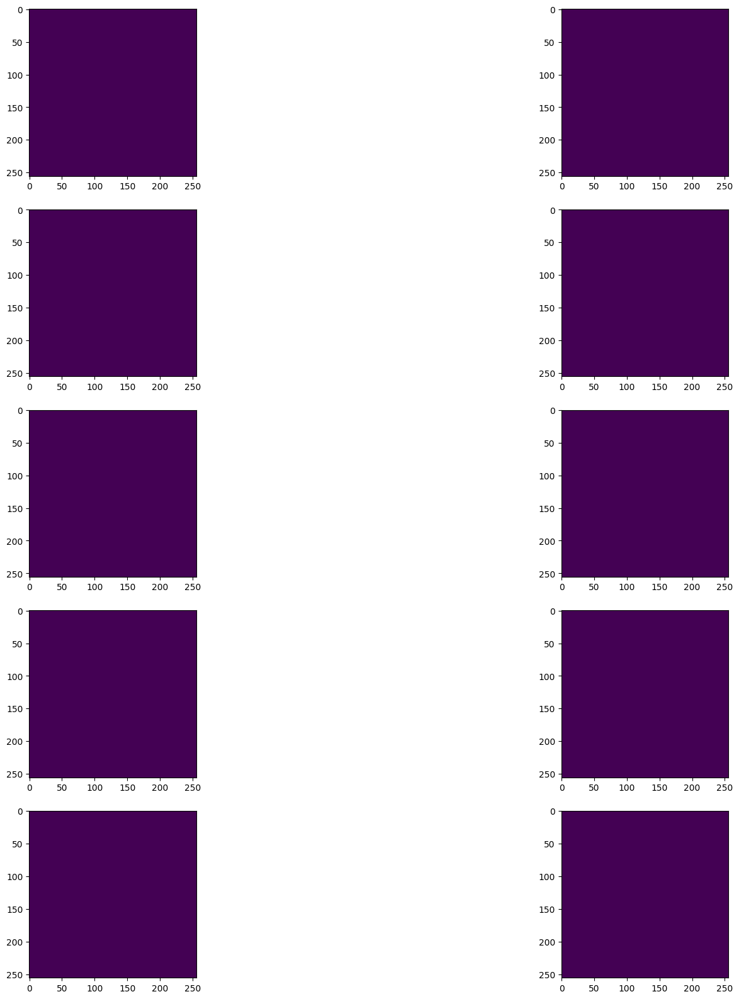

(256, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_31_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_31_PROG/Resize_seg/Segmentation.nii.gz


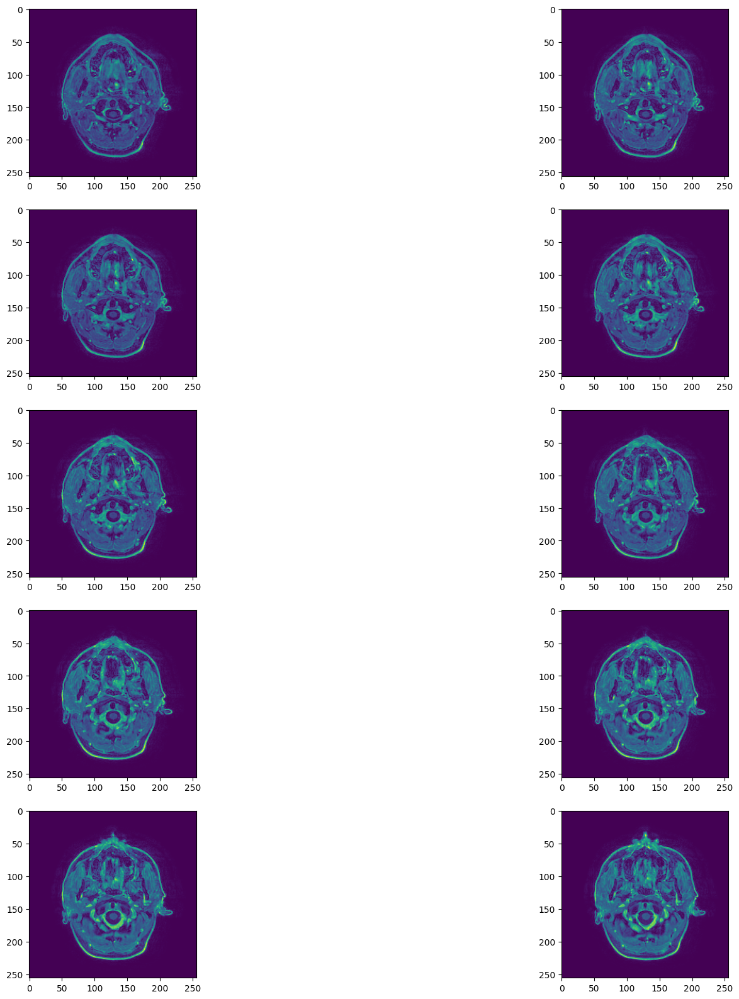

(156, 256, 256)


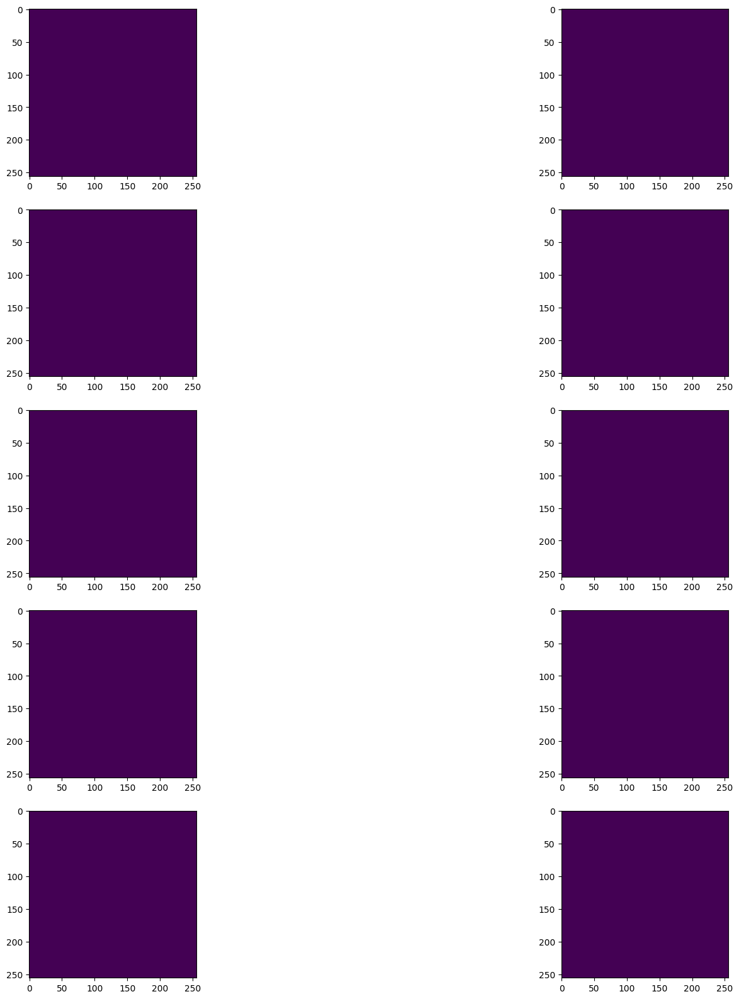

(156, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_32_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_32_PROG/Resize_seg/Segmentation.nii.gz


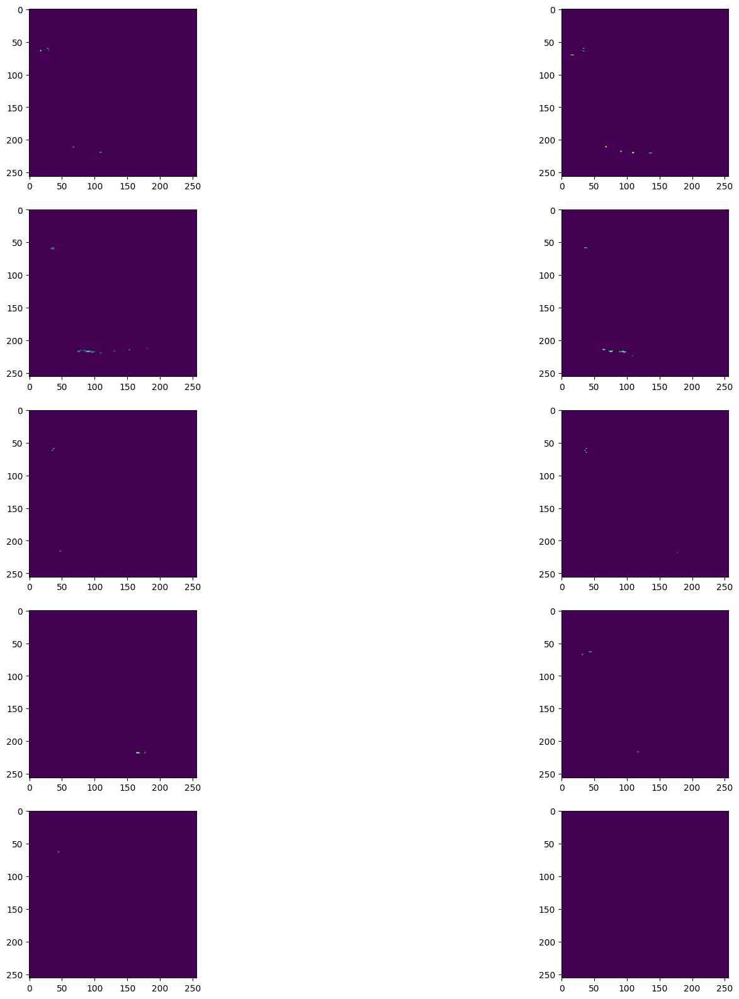

(400, 256, 256)


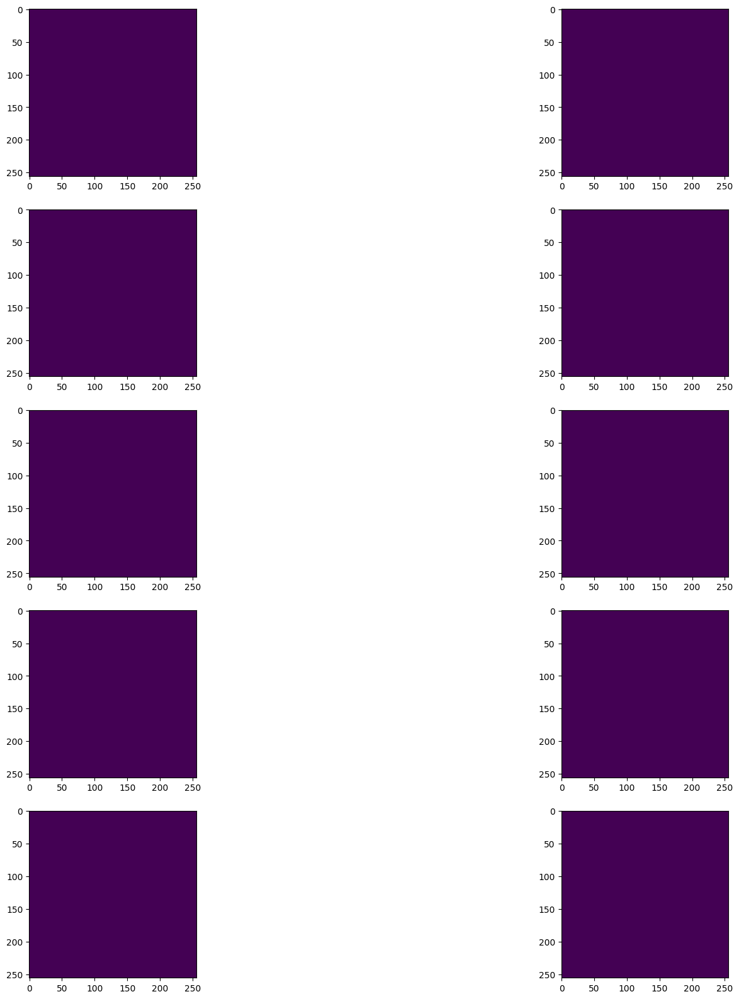

(400, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_33_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_33_PROG/Resize_seg/Segmentation.nii.gz


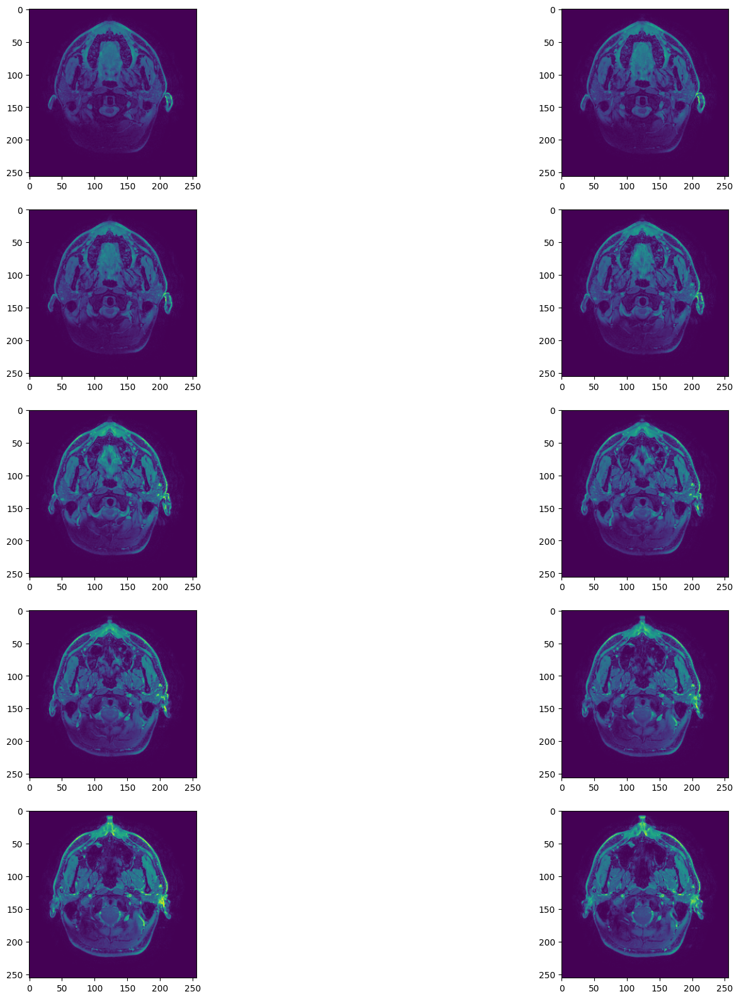

(172, 256, 256)


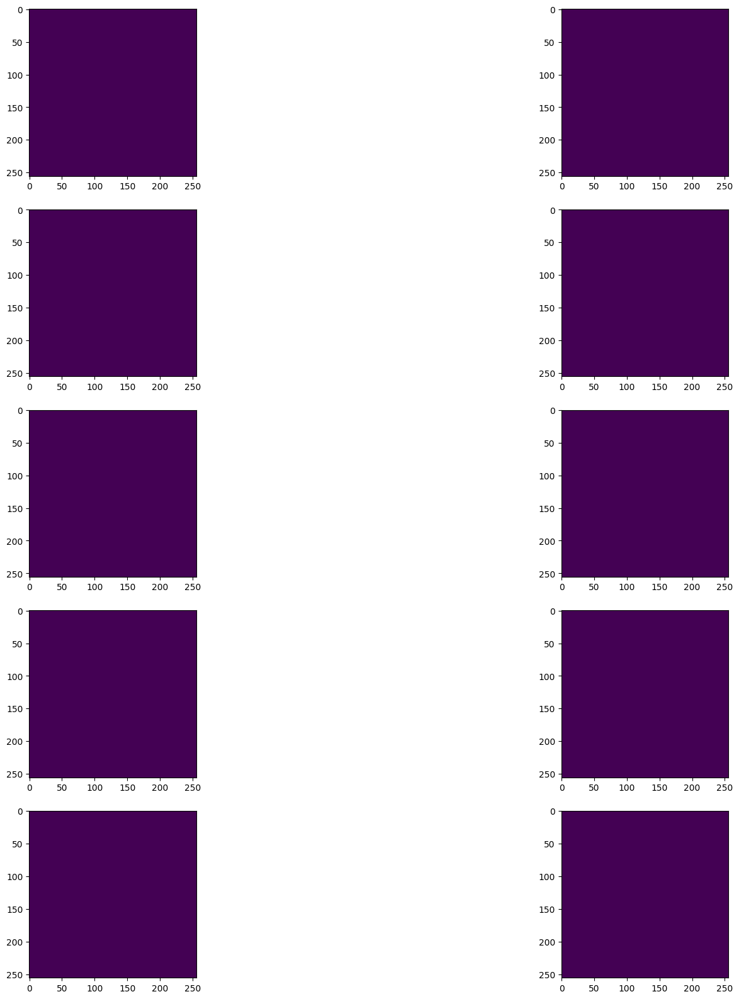

(172, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_35_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_35_PROG/Resize_seg/Segmentation.nii.gz


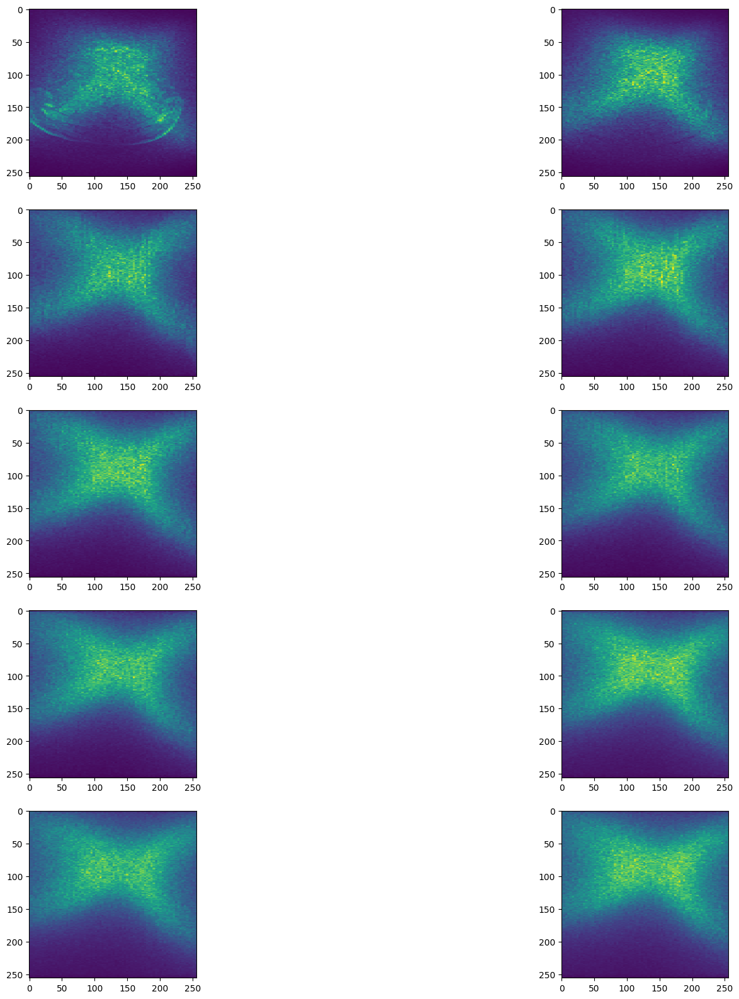

(256, 256, 256)


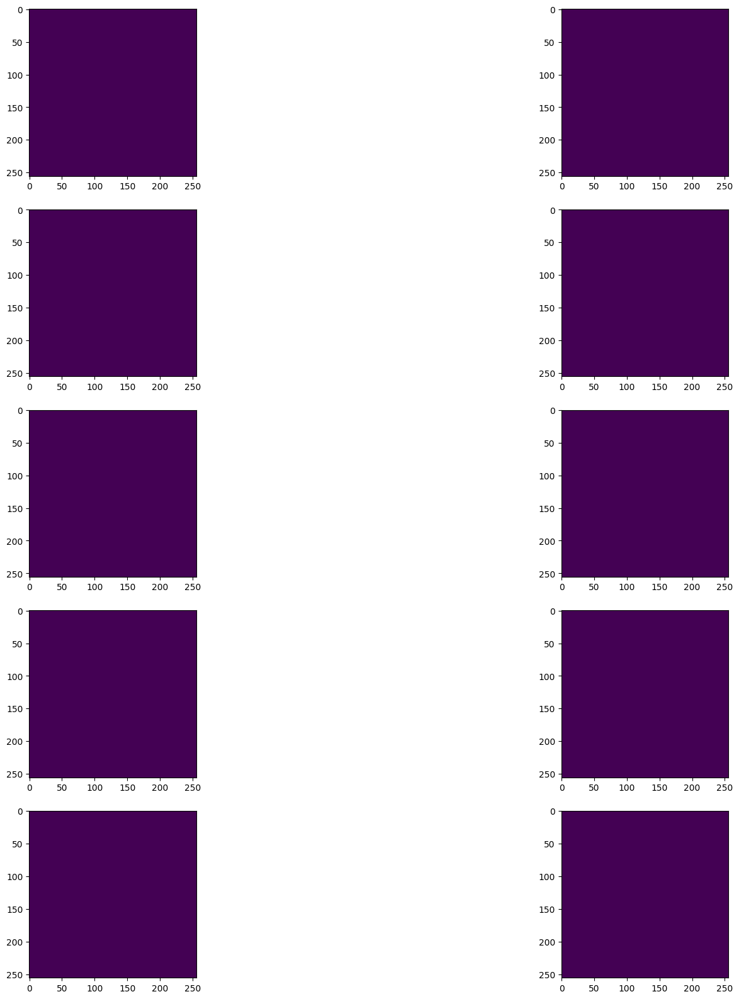

(256, 256, 256)
/content/final_data1/RADIOMICS/new_folder/RADIOMICS_36_PROG/Resize/3DFSPGR.nii.gz /content/final_data1/RADIOMICS/new_folder/RADIOMICS_36_PROG/Resize_seg/Segmentation.nii.gz


KeyboardInterrupt: 

In [ ]:
# settings = {}
# settings['binWidth'] = 25
# settings['resampledPixelSpacing'] = None  # [3,3,3]
# settings['interpolator'] = sitk.sitkBSpline
# settings['enableCExtensions'] = True

params= "/content/tumor.yaml"

texture_extractor = featureextractor.RadiomicsFeatureExtractor(params)

# texture_extractor = featureextractor.RadiomicsFeatureExtractor(verbose= False)
texture_extractor.disableAllFeatures()
_text_feat= {ckey: [] for ckey in getFeatureClasses().keys()}
texture_extractor.enableFeaturesByName(**_text_feat)

final_df= pd.DataFrame()
comb_df=  pd.DataFrame()



for num in range(len(df_res.index)):

  print(df_res['Image_Path'][num], df_res['Mask_Path'][num])


  img_sitk = df_res['Image_Path'][num]

  # Read the .nii image containing the volume with SimpleITK:
  img_sitk = sitk.ReadImage(img_sitk)

  # and access the numpy array:
  img_sitk = sitk.GetArrayFromImage(img_sitk)

  # ncols = 2
  # nrows = 5
  # fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize= (20, 20))
  # for index, axi in enumerate(ax.flat):
  #   train = img_sitk[index, :, :]
  #   axi.imshow(train)
  # plt.show()


  print(img_sitk.shape)
# ====================================================

  mask_sitk = df_res['Mask_Path'][num]

  # Read the .nii image containing the volume with SimpleITK:
  mask_sitk = sitk.ReadImage(mask_sitk)

  # and access the numpy array:
  mask_sitk = sitk.GetArrayFromImage(mask_sitk)

  mask_sitk= mask_sitk.clip(0,1).astype(np.uint8)

  # ncols = 2
  # nrows = 5
  # fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize= (20, 20))
  # for index, axi in enumerate(ax.flat):
  #   train = mask_sitk[index, :, :]
  #   axi.imshow(train)
  # plt.show()

  print(mask_sitk.shape)

  results= texture_extractor.execute(GetImageFromArray(img_sitk), GetImageFromArray(mask_sitk))

  df_rad= pd.DataFrame([results])

  comb_df= pd.concat([comb_df, df_rad], axis=0)

  # break





In [ ]:
pd.set_option('display.max_rows', None)
comb_df.reset_index(inplace=True, drop=True)

In [ ]:
pd.set_option('display.max_rows', None)
final_df= pd.concat([df_res, comb_df], axis= 1)

In [ ]:
final_df

,Id,Sequence,Image_Path,Mask_Path,Outcome,diagnostics_Versions_PyRadiomics,diagnostics_Versions_Numpy,diagnostics_Versions_SimpleITK,diagnostics_Versions_PyWavelet,diagnostics_Versions_Python,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,01,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,PROG,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,4.562039322585308,0.09263162306124287,4.268979848434517,0.0019306480920654148,23152920.645520955,233.91743080253124,0.000540836080259318,1.0854401830015294,0.0007502947012947362,0.014924008528260268
1,02,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,RTN,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,105.69551228740285,0.03436060399653136,6.385951064981061,0.01745163876614804,7392408.195283513,67.68857583846817,0.00010830461625182995,539.814205190745,0.00040823344870317865,3.7335110854728537
2,04,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,RTN,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,19.770165147857753,0.08961816857570247,5.183942956833266,0.0037164930352335244,31863457.587103974,177.52516047092607,0.00011521435803249074,54.960135915019244,0.00018552969487808224,0.35046073912139164
3,08,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,PROG,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,14.003181918418635,0.0990827096259591,5.319850892435356,0.00660279160761986,9644528.08046652,306.4243678699734,6.152241898096823e-05,91.52653228954487,0.0004900388474437996,0.14269474919815453
4,09,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,PROG,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,54.799493353195814,0.06566637600124296,6.351063160259502,0.01738172049183151,1768053.8341996057,45.80013103528575,0.00012598965494296145,450.30373139256466,0.0018092191604491988,0.7046461034564027
5,10,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,PROG,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,12.149036043549568,0.16511334359556942,5.687755511535822,0.002811984165242415,19151571.409438357,305.87135615328214,7.746416554970883e-05,51.445438679044685,0.0017168909096980998,0.06709806540021691
6,12,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,RTN,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,24.133275324800174,0.052183559715646484,5.929636357439105,0.005143931861470824,60481869.16762399,261.666948754469,5.636997582435248e-05,98.89786134548245,0.0001482590053335227,0.37690845081830776
7,13,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,RTN,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,16.703713288534498,0.06925220149745169,5.418932782617308,0.003951696920242439,82875471.45792039,314.2009064421854,7.334191644546043e-05,35.03902692273733,0.00010630092233775794,0.21586924165338425
8,16,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,RTN,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,16.956329730359517,0.06521476363416838,5.865699652328199,0.007731601185596267,4238446.142614212,157.57977701076163,0.00011968172539736884,71.88425698043574,0.0018853091391090124,0.11218496212648273
9,17,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,RTN,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,...,4.0731183826399855,0.07108109851728696,5.214742060580386,0.001487581570425892,74922344.10085161,159.6253230222056,0.00044097202104128474,1.84173

In [ ]:
pd.set_option('display.max_rows', None)
final_df.T

,0,1,2,3,4,5,6,7,8,9,...,125,126,127,128,129,130,131,132,133,134
Id,01,02,04,08,09,10,12,13,16,17,...,241,242,243,244,245,246,247,248,249,250
Sequence,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,...,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR,3DFSPGR
Image_Path,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...
Mask_Path,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...
Outcome,PROG,RTN,RTN,PROG,PROG,PROG,RTN,RTN,RTN,RTN,...,RTN,RTN,RTN,RTN,RTN,RTN,RTN,RTN,RTN,RTN
diagnostics_Versions_PyRadiomics,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,...,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1,v3.0.1
diagnostics_Versions_Numpy,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,...,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4,1.26.4
diagnostics_Versions_SimpleITK,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,...,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1,2.3.1
diagnostics_Versions_PyWavelet,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,...,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0,1.6.0
diagnostics_Versions_Python,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,...,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12,3.10.12


In [ ]:
%cd /content

/content


In [ ]:
final_df.to_csv('fin_data_imp.csv', index= False)

In [ ]:
#Skull Stripping block

!git clone https://github.com/FahimFBA/skull-stripping-3D-brain-mri.git

%cd /content/skull-stripping-3D-brain-mri/notebooks

import helpers
from helpers import *


Cloning into 'skull-stripping-3D-brain-mri'...
remote: Enumerating objects: 145, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 145 (delta 0), reused 3 (delta 0), pack-reused 141
Receiving objects: 100% (145/145), 856.03 MiB | 28.60 MiB/s, done.
Resolving deltas: 100% (7/7), done.
Updating files: 100% (70/70), done.
/content/skull-stripping-3D-brain-mri/notebooks


In [ ]:


# for fold_path in folder_list:
#   print(fold_path)
#   path_= os.path.join(fold_path, "Strip")
#   os.makedirs(path_)

/content/RADIOMICS/new_folder/RADIOMICS_01_PROG
/content/RADIOMICS/new_folder/RADIOMICS_02_RTN
/content/RADIOMICS/new_folder/RADIOMICS_03_PROG
/content/RADIOMICS/new_folder/RADIOMICS_04_RTN
/content/RADIOMICS/new_folder/RADIOMICS_08_PROG
/content/RADIOMICS/new_folder/RADIOMICS_09_PROG
/content/RADIOMICS/new_folder/RADIOMICS_10_PROG
/content/RADIOMICS/new_folder/RADIOMICS_12_RTN
/content/RADIOMICS/new_folder/RADIOMICS_13_RTN
/content/RADIOMICS/new_folder/RADIOMICS_16_RTN
/content/RADIOMICS/new_folder/RADIOMICS_17_RTN
/content/RADIOMICS/new_folder/RADIOMICS_18_PROG
/content/RADIOMICS/new_folder/RADIOMICS_19_PROG
/content/RADIOMICS/new_folder/RADIOMICS_24_PROG
/content/RADIOMICS/new_folder/RADIOMICS_25_PROG
/content/RADIOMICS/new_folder/RADIOMICS_26_PROG
/content/RADIOMICS/new_folder/RADIOMICS_27_RTN
/content/RADIOMICS/new_folder/RADIOMICS_28_PROG
/content/RADIOMICS/new_folder/RADIOMICS_29_PROG
/content/RADIOMICS/new_folder/RADIOMICS_30_RTN
/content/RADIOMICS/new_folder/RADIOMICS_31_PROG


In [ ]:
len(folder_list)

135

In [ ]:
import os
# out_folder= "/content/RADIOMICS/new_folder/RADIOMICS_04/strip/"

#


from antspynet.utilities import brain_extraction

# raw_img_path= "/content/RADIOMICS/data/RADIOMICS_04/NII/3DFSPGR.nii"

img_list= natsorted(img_list)

for idx, fold_path in enumerate(folder_list):

  img_p= "Resize/3DFSPGR.nii.gz"
  mid= "Strip"
  out_filename= "3DFSPGR.nii.gz"

  img_path= os.path.join(fold_path, img_p)
  out_path = os.path.join(fold_path, mid ,out_filename)

  raw_img_ants = ants.image_read(img_path, reorient='IAL')

  print(f'shape = {raw_img_ants.numpy().shape} -> (Z, X, Y)')

  # Display the 3D array using a custom function 'explore_3D_array' with the image array and a specified colormap
  # explore_3D_array(arr=raw_img_ants.numpy(), cmap='nipy_spectral')

  prob_brain_mask = brain_extraction(raw_img_ants, modality='bold', verbose=True)

  brain_mask = ants.get_mask(prob_brain_mask, low_thresh=0.3)

  brain_mask.to_file(out_path)

  masked = ants.mask_image(raw_img_ants, brain_mask)

  masked.to_file(out_path)

  break





shape = (50, 256, 256) -> (Z, X, Y)
Brain extraction:  retrieving model weights.
Brain extraction:  retrieving template.
Brain extraction:  normalizing image to the template.
Brain extraction:  prediction and decoding.
1/1 ━━━━━━━━━━━━━━━━━━━━ 25s 25s/step
Brain extraction:  renormalize probability mask to native space.


In [ ]:

!pip install xgboost
!pip install numpy Cython
!pip install pymrmr

In [ ]:


import io
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold
# from sklearn.model_selection import KFold
from xgboost import XGBClassifier
import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.pipeline import make_pipeline
import statistics
from sklearn.metrics import matthews_corrcoef
# import pymrmr
from sklearn.metrics import confusion_matrix

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import mutual_info_classif, f_classif, f_regression
from sklearn.metrics import roc_curve
from sklearn.preprocessing import LabelEncoder, MinMaxScaler

In [ ]:
# Plot ROC curve
def plot_crv(ns_fpr_lr, ns_tpr_lr, auc_lr ):
  plt.plot(ns_fpr_lr, ns_tpr_lr, label='ROC curve (area = %0.3f)' % auc_lr)
  plt.plot([0, 1], [0, 1], 'k--')  # random predictions curve
  plt.xlim([0.0, 1.0])
  plt.ylim([0.0, 1.0])
  plt.xlabel('False Positive Rate or (1 - Specifity)')
  plt.ylabel('True Positive Rate or (Sensitivity)')
  plt.title('Receiver Operating Characteristic')
  plt.legend(loc="lower right")


In [ ]:
final_df= pd.read_csv("/content/fin_data_imp.csv", index_col = 0)

In [ ]:

final_df.Outcome[final_df.Outcome == 'RTN'] = 0
final_df.Outcome[final_df.Outcome == 'PROG'] = 1


<ipython-input-184-c6c116268cc1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_df.Outcome[final_df.Outcome == 'RTN'] = 0
<ipython-input-184-c6c116268cc1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_df.Outcome[final_df.Outcome == 'PROG'] = 1


In [ ]:
final_df_test= final_df

In [ ]:
final_df_test= final_df_test.sample(frac=1, random_state=42).reset_index(drop=True)


In [ ]:
final_df_test

,Sequence,Image_Path,Mask_Path,Outcome,diagnostics_Versions_PyRadiomics,diagnostics_Versions_Numpy,diagnostics_Versions_SimpleITK,diagnostics_Versions_PyWavelet,diagnostics_Versions_Python,diagnostics_Configuration_Settings,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,34.976602,0.058110,6.047887,0.004430,1.156471e+08,320.453620,0.000037,130.068994,0.000220,0.322742
1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,10.576555,0.036192,6.305630,0.002728,2.662027e+07,200.847815,0.000114,41.992070,0.000444,0.163991
2,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,94.906167,0.028314,6.632794,0.008595,3.135983e+07,78.387075,0.000104,290.569602,0.000169,3.124939
4,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,65.700010,0.042535,5.844282,0.009695,9.174495e+06,48.972521,0.000274,107.679407,0.000149,3.340925
5,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,38.528908,0.036510,6.266945,0.022831,2.359021e+06,157.381952,0.000095,185.192211,0.003369,0.228586
6,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,4.622058,0.006544,6.890634,0.001004,5.567814e+08,288.068643,0.000060,40.476287,0.000093,0.267388
7,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,1,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,14.311853,0.077199,5.270793,0.004649,1.677153e+07,157.521112,0.000209,20.310049,0.000311,0.186880
8,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,0,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,131.156347,0.036131,6.523858,0.012821,1.293639e+07,84.226249,0.000078,657.517124,0.000310,3.289953
9,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,0,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,13.709832,0.085320,5.552939,0.005473,2.585576e+07,457.745720,0.000043,77.586860,0.000735,0.074170


In [ ]:
final_df_test= pd.concat([final_df_test["Outcome"], final_df_test.drop("Outcome", axis=1)], axis=1)


In [ ]:
final_df_test

,Outcome,Sequence,Image_Path,Mask_Path,diagnostics_Versions_PyRadiomics,diagnostics_Versions_Numpy,diagnostics_Versions_SimpleITK,diagnostics_Versions_PyWavelet,diagnostics_Versions_Python,diagnostics_Configuration_Settings,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,34.976602,0.058110,6.047887,0.004430,1.156471e+08,320.453620,0.000037,130.068994,0.000220,0.322742
1,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,10.576555,0.036192,6.305630,0.002728,2.662027e+07,200.847815,0.000114,41.992070,0.000444,0.163991
2,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,94.906167,0.028314,6.632794,0.008595,3.135983e+07,78.387075,0.000104,290.569602,0.000169,3.124939
4,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,65.700010,0.042535,5.844282,0.009695,9.174495e+06,48.972521,0.000274,107.679407,0.000149,3.340925
5,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,38.528908,0.036510,6.266945,0.022831,2.359021e+06,157.381952,0.000095,185.192211,0.003369,0.228586
6,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,4.622058,0.006544,6.890634,0.001004,5.567814e+08,288.068643,0.000060,40.476287,0.000093,0.267388
7,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,14.311853,0.077199,5.270793,0.004649,1.677153e+07,157.521112,0.000209,20.310049,0.000311,0.186880
8,0,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,131.156347,0.036131,6.523858,0.012821,1.293639e+07,84.226249,0.000078,657.517124,0.000310,3.289953
9,0,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.26.4,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,13.709832,0.085320,5.552939,0.005473,2.585576e+07,457.745720,0.000043,77.586860,0.000735,0.074170


In [ ]:
dataframe= final_df_test
dataframe= dataframe.drop(final_df_test.iloc[:, 1:26], axis=1)

In [ ]:
dataframe

,Outcome,original_shape_Elongation,original_shape_Flatness,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,1,0.624528,0.521462,78.025670,149.628692,118.869677,174.797025,173.933895,177.279440,7.167539e+05,...,34.976602,0.058110,6.047887,0.004430,1.156471e+08,320.453620,0.000037,130.068994,0.000220,0.322742
1,1,0.995773,0.613017,45.285882,73.873791,92.574294,91.285267,91.219515,96.648849,1.428078e+05,...,10.576555,0.036192,6.305630,0.002728,2.662027e+07,200.847815,0.000114,41.992070,0.000444,0.163991
2,1,0.473794,0.246831,30.223575,122.446496,65.122961,151.558570,137.931142,157.149610,1.268276e+05,...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,1,0.661283,0.406041,50.882804,125.314565,107.786827,140.602276,136.619911,141.936606,3.197438e+05,...,94.906167,0.028314,6.632794,0.008595,3.135983e+07,78.387075,0.000104,290.569602,0.000169,3.124939
4,1,0.710300,0.629382,44.283927,70.360983,66.528190,79.881162,75.471849,89.593527,9.869858e+04,...,65.700010,0.042535,5.844282,0.009695,9.174495e+06,48.972521,0.000274,107.679407,0.000149,3.340925
5,1,0.488750,0.279984,33.996481,121.423051,73.763134,132.098448,132.672529,135.871263,1.050918e+05,...,38.528908,0.036510,6.266945,0.022831,2.359021e+06,157.381952,0.000095,185.192211,0.003369,0.228586
6,1,0.898052,0.641583,82.962433,129.308914,133.958949,144.627107,148.448644,156.649290,7.168380e+05,...,4.622058,0.006544,6.890634,0.001004,5.567814e+08,288.068643,0.000060,40.476287,0.000093,0.267388
7,1,0.419813,0.273071,33.687543,123.365284,67.955868,150.119952,153.062079,158.647408,9.831871e+04,...,14.311853,0.077199,5.270793,0.004649,1.677153e+07,157.521112,0.000209,20.310049,0.000311,0.186880
8,0,0.561558,0.435584,51.751011,118.808338,83.737686,149.281613,142.593829,149.672977,2.362678e+05,...,131.156347,0.036131,6.523858,0.012821,1.293639e+07,84.226249,0.000078,657.517124,0.000310,3.289953
9,0,0.591579,0.440008,52.553214,119.436832,84.899941,133.660016,129.838361,139.402296,2.895000e+05,...,13.709832,0.085320,5.552939,0.005473,2.585576e+07,457.745720,0.000043,77.586860,0.000735,0.074170


In [ ]:
#1

Y=final_df_test["Outcome"].astype('int64')

Y

,Outcome
0,1
1,1
2,1
3,1
4,1
5,1
6,1
7,1
8,0
9,0


In [ ]:
#1

final_df_test= pd.concat([Y, final_df_test.drop("Outcome", axis=1)], axis=1)

In [ ]:
#1

final_df_test

,Outcome,Sequence,Image_Path,Mask_Path,diagnostics_Versions_PyRadiomics,diagnostics_Versions_Numpy,diagnostics_Versions_SimpleITK,diagnostics_Versions_PyWavelet,diagnostics_Versions_Python,diagnostics_Configuration_Settings,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,119.174342,0.033408,6.717589,0.013613,5.029246e+06,97.894693,0.000059,959.937233,0.000857,2.074167
1,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,4.235779,0.086929,4.644039,0.001369,5.119018e+07,346.500055,0.000365,1.033171,0.000700,0.010033
2,0,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,1.700277,0.051221,5.018662,0.000099,8.999855e+09,214.691961,0.000582,0.059649,0.000002,0.017361
3,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,54.799493,0.065666,6.351063,0.017382,1.768054e+06,45.800131,0.000126,450.303731,0.001809,0.704646
4,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,12.697690,0.105316,5.722294,0.006621,2.432923e+06,68.523440,0.000210,73.642911,0.002170,0.190490
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,37.066852,0.032701,7.355025,0.002352,4.479361e+08,740.983976,0.000019,74.838733,0.000416,0.066119
65,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,8.502646,0.067811,5.522638,0.001039,4.895216e+08,278.223099,0.000146,4.734596,0.000025,0.142830
66,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,46.411329,0.033359,6.523349,0.023621,5.896763e+05,48.586554,0.000164,284.299746,0.005803,0.300309
67,1,3DFSPGR,/content/final_data/RADIOMICS/new_folder/RADIO...,/content/final_data/RADIOMICS/new_folder/RADIO...,v3.0.1,1.25.2,2.3.1,1.6.0,3.10.12,"{'minimumROIDimensions': 2, 'minimumROISize': ...",...,6.187205,0.090125,6.022692,0.001010,4.291993e+08,761.663703,0.000050,10.145146,0.000135,0.030547


In [ ]:
#1

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

In [ ]:
#1
Y= pd.DataFrame(Y)

In [ ]:
#1

final_df_test= final_df_test.drop(final_df_test.iloc[:, :26], axis=1)
# final_df_test= final_df_test.drop(final_df_test.iloc[:, 1:26], axis=1)

In [ ]:
final_df_test

,original_shape_Elongation,original_shape_Flatness,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_MinorAxisLength,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,0.578695,0.285496,85.218468,298.492730,188.170136,349.322201,348.969913,354.506700,2.888481e+06,172.736245,...,34.120728,0.033252,6.990899,0.001592,1.338891e+09,779.780257,0.000015,88.802993,0.000110,0.138185
1,0.867044,0.521033,41.791257,80.208461,94.641429,84.528102,101.833197,102.985436,1.353419e+05,69.544252,...,18.100580,0.061443,6.218087,0.003277,2.099051e+07,193.817385,0.000118,42.702792,0.000448,0.169912
2,0.473794,0.246831,30.223575,122.446496,65.122961,151.558570,137.931142,157.149610,1.268276e+05,58.014385,...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,0.651864,0.205458,51.710768,251.685668,216.187419,280.301623,274.963634,283.273719,1.291204e+06,164.064883,...,106.529164,0.014700,7.183261,0.003942,2.770419e+08,164.770176,0.000041,268.478911,0.000069,1.700372
4,0.650361,0.378491,51.724134,136.658977,109.041277,146.123236,151.476071,162.228234,3.983875e+05,88.877717,...,82.386306,0.025874,6.497957,0.005436,6.625315e+07,101.119276,0.000116,93.166307,0.000071,1.792949
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130,0.615723,0.267597,21.045255,78.645367,98.412398,59.413803,101.123687,102.610916,4.746825e+04,48.423743,...,18.470273,0.038265,5.887952,0.017766,3.955270e+05,60.388002,0.000260,48.264047,0.018718,0.026148
131,0.593722,0.320946,46.102015,143.644048,125.063984,160.199875,158.256122,162.963186,3.516455e+05,85.284601,...,3.506744,0.090707,4.793363,0.000785,3.997117e+08,865.480461,0.000115,1.235002,0.000266,0.005846
132,0.803080,0.592127,78.819772,133.113006,136.740630,175.934647,176.465294,183.855922,5.739605e+05,106.900339,...,6.187205,0.090125,6.022692,0.001010,4.291993e+08,761.663703,0.000050,10.145146,0.000135,0.030547
133,0.498491,0.467463,43.559987,93.183781,62.369865,110.476242,108.903627,111.054041,1.017913e+05,46.451282,...,8.107437,0.107869,4.683852,0.002767,2.580085e+07,235.545363,0.000174,15.201087,0.000395,0.086741


In [ ]:
#1

final_df_test= final_df_test.dropna()

final_df_test= final_df_test.astype('float64')


final_df_cn= final_df_test._get_numeric_data().columns

In [ ]:
#1

pd.set_option('display.max_rows', None)
final_df_test.T

,0,1,2,3,4,5,6,7,8,9,...,125,126,127,128,129,130,131,132,133,134
original_shape_Elongation,5.786950e-01,8.670438e-01,4.737938e-01,6.518642e-01,6.503614e-01,4.887497e-01,8.260218e-01,4.198133e-01,4.469390e-01,5.162403e-01,...,5.630600e-01,8.529863e-01,3.919185e-01,7.817835e-01,6.563351e-01,6.157228e-01,5.937218e-01,8.030796e-01,4.984911e-01,6.370480e-01
original_shape_Flatness,2.854960e-01,5.210330e-01,2.468309e-01,2.054577e-01,3.784906e-01,2.799838e-01,2.250640e-01,2.730715e-01,3.140084e-01,3.250007e-01,...,2.745324e-01,2.626930e-01,2.665759e-01,5.265623e-01,2.080824e-01,2.675969e-01,3.209462e-01,5.921267e-01,4.674632e-01,3.834423e-01
original_shape_LeastAxisLength,8.521847e+01,4.179126e+01,3.022358e+01,5.171077e+01,5.172413e+01,3.399648e+01,2.795829e+01,3.368754e+01,6.531564e+01,6.055158e+01,...,2.828517e+01,2.639066e+01,5.429565e+01,4.116909e+01,4.487609e+01,2.104525e+01,4.610201e+01,7.881977e+01,4.355999e+01,7.942877e+01
original_shape_MajorAxisLength,2.984927e+02,8.020846e+01,1.224465e+02,2.516857e+02,1.366590e+02,1.214231e+02,1.242237e+02,1.233653e+02,2.080061e+02,1.863121e+02,...,1.030304e+02,1.004620e+02,2.036780e+02,7.818465e+01,2.156651e+02,7.864537e+01,1.436440e+02,1.331130e+02,9.318378e+01,2.071466e+02
original_shape_Maximum2DDiameterColumn,1.881701e+02,9.464143e+01,6.512296e+01,2.161874e+02,1.090413e+02,7.376313e+01,1.305527e+02,6.795587e+01,1.175457e+02,1.113059e+02,...,8.537564e+01,1.181059e+02,9.720082e+01,8.130191e+01,2.295583e+02,9.841240e+01,1.250640e+02,1.367406e+02,6.236986e+01,1.713972e+02
original_shape_Maximum2DDiameterRow,3.493222e+02,8.452810e+01,1.515586e+02,2.803016e+02,1.461232e+02,1.320984e+02,1.059056e+02,1.501200e+02,2.593068e+02,2.070676e+02,...,8.670063e+01,9.052072e+01,2.173684e+02,9.414882e+01,1.557081e+02,5.941380e+01,1.601999e+02,1.759346e+02,1.104762e+02,2.375395e+02
original_shape_Maximum2DDiameterSlice,3.489699e+02,1.018332e+02,1.379311e+02,2.749636e+02,1.514761e+02,1.326725e+02,1.446271e+02,1.530621e+02,2.498019e+02,2.029803e+02,...,1.155206e+02,1.204865e+02,2.041886e+02,9.082401e+01,2.314865e+02,1.011237e+02,1.582561e+02,1.764653e+02,1.089036e+02,2.277279e+02
original_shape_Maximum3DDiameter,3.545067e+02,1.029854e+02,1.571496e+02,2.832737e+02,1.622282e+02,1.358713e+02,1.448655e+02,1.586474e+02,2.606262e+02,2.163770e+02,...,1.156287e+02,1.223233e+02,2.190913e+02,9.448809e+01,2.347488e+02,1.026109e+02,1.629632e+02,1.838559e+02,1.110540e+02,2.461057e+02
original_shape_MeshVolume,2.888481e+06,1.353419e+05,1.268276e+05,1.291204e+06,3.983875e+05,1.050918e+05,2.050351e+05,9.831871e+04,7.276823e+05,7.083292e+05,...,1.054708e+05,1.375729e+05,4.658866e+05,1.250455e+05,5.500989e+05,4.746825e+04,3.516455e+05,5.739605e+05,1.017913e+05,1.233225e+06
original_shape_MinorAxisLength,1.727362e+02,6.954425e+01,5.801439e+01,1.640649e+02,8.887772e+01,5.934548e+01,1.026115e+02,5.179038e+01,9.296601e+01,9.618184e+01,...,5.801227e+01,8.569272e+01,7.982519e+01,6.112347e+01,1.415486e+02,4.842374e+01,8.528460e+01,1.069003e+02,4.645128e+01,1.319623e+02


In [ ]:
#1

final_df_test

,original_shape_Elongation,original_shape_Flatness,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_MinorAxisLength,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,0.578695,0.285496,85.218468,298.492730,188.170136,349.322201,348.969913,354.506700,2.888481e+06,172.736245,...,34.120728,0.033252,6.990899,0.001592,1.338891e+09,779.780257,0.000015,88.802993,0.000110,0.138185
1,0.867044,0.521033,41.791257,80.208461,94.641429,84.528102,101.833197,102.985436,1.353419e+05,69.544252,...,18.100580,0.061443,6.218087,0.003277,2.099051e+07,193.817385,0.000118,42.702792,0.000448,0.169912
2,0.473794,0.246831,30.223575,122.446496,65.122961,151.558570,137.931142,157.149610,1.268276e+05,58.014385,...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,0.651864,0.205458,51.710768,251.685668,216.187419,280.301623,274.963634,283.273719,1.291204e+06,164.064883,...,106.529164,0.014700,7.183261,0.003942,2.770419e+08,164.770176,0.000041,268.478911,0.000069,1.700372
4,0.650361,0.378491,51.724134,136.658977,109.041277,146.123236,151.476071,162.228234,3.983875e+05,88.877717,...,82.386306,0.025874,6.497957,0.005436,6.625315e+07,101.119276,0.000116,93.166307,0.000071,1.792949
5,0.488750,0.279984,33.996481,121.423051,73.763134,132.098448,132.672529,135.871263,1.050918e+05,59.345484,...,38.528908,0.036510,6.266945,0.022831,2.359021e+06,157.381952,0.000095,185.192211,0.003369,0.228586
6,0.826022,0.225064,27.958285,124.223728,130.552671,105.905618,144.627107,144.865455,2.050351e+05,102.611506,...,52.570037,0.073385,6.014269,0.003489,4.566030e+07,117.754172,0.000146,57.549748,0.000133,0.654464
7,0.419813,0.273071,33.687543,123.365284,67.955868,150.119952,153.062079,158.647408,9.831871e+04,51.790384,...,14.311853,0.077199,5.270793,0.004649,1.677153e+07,157.521112,0.000209,20.310049,0.000311,0.186880
8,0.446939,0.314008,65.315643,208.006058,117.545736,259.306768,249.801922,260.626169,7.276823e+05,92.966013,...,106.632158,0.025029,6.793742,0.006940,7.847049e+07,192.524346,0.000041,311.363420,0.000153,1.179988
9,0.516240,0.325001,60.551580,186.312139,111.305885,207.067622,202.980295,216.376986,7.083292e+05,96.181837,...,13.393046,0.068674,6.041981,0.003294,1.081580e+08,826.072085,0.000022,77.601943,0.000469,0.050115


In [ ]:
auc_lr=[]
pre_lr=[]
rec_lr=[]
acc_lr=[]
f1_lr=[]
sens_lr= []
specs_lr= []
auc_lrt=[]
pre_lrt=[]
rec_lrt=[]
acc_lrt=[]
f1_lrt=[]
sens_lrt= []
specs_lrt= []


cv = StratifiedKFold(n_splits=5, random_state=46, shuffle=True)
for train_index, test_index in cv.split(final_df_test, Y):

    X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
    Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]



    test = SelectKBest(score_func=f_classif, k=60)
    model = test.fit(X_train, Y_train.values.ravel())
    # mask = model.get_support()
    # new_features = X_train.columns[mask]
    # print(new_features)

    X_train = model.transform(X_train)
    X_test= model.transform(X_test)

    clf = XGBClassifier(n_estimators=300, max_depth=1, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)
#     clf = XGBClassifier(
#  learning_rate =0.001,
#  n_estimators=50,
#  max_depth=1,
#  min_child_weight=1,
#  gamma=0,
#  subsample=0.8,
#  colsample_bytree=0.85,
#  reg_alpha=1,
#  objective= 'binary:logistic',
#  nthread=4,
#  scale_pos_weight=1,
#  seed=27).fit(X_train, Y_train)
    pred = clf.predict(X_test)
    print(pred)
    print(Y_test.values.ravel())
    pre_l = precision_score(Y_test, pred)
    rec_l = recall_score(Y_test, pred)
    sens_l= recall_score(Y_test, pred, pos_label=1)
    specs_l= recall_score(Y_test, pred, pos_label=0)
    acc_l = accuracy_score(Y_test, pred)
    probs = clf.predict_proba(X_test)
    probs = probs[:, 1]
    auc_l = roc_auc_score(Y_test, probs)
    f1_l= f1_score(Y_test, pred)
    ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


    plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

    pred = clf.predict(X_train)
    pre_lt = precision_score(Y_train, pred)
    rec_lt = recall_score(Y_train, pred)
    sens_lt= recall_score(Y_train, pred, pos_label=1)
    specs_lt= recall_score(Y_train, pred, pos_label=0)
    acc_lt = accuracy_score(Y_train, pred)
    probs = clf.predict_proba(X_train)
    probs = probs[:, 1]
    auc_lt = roc_auc_score(Y_train, probs)
    f1_lt = f1_score(Y_train, pred)
    ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



    auc_lr.append(auc_l)
    pre_lr.append(pre_l)
    rec_lr.append(rec_l)
    acc_lr.append(acc_l)
    f1_lr.append(f1_l)
    sens_lr.append(sens_l)
    specs_lr.append(specs_l)



    auc_lrt.append(auc_lt)
    pre_lrt.append(pre_lt)
    rec_lrt.append(rec_lt)
    acc_lrt.append(acc_lt)
    f1_lrt.append(f1_lt)
    sens_lrt.append(sens_lt)
    specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", statistics.mean(pre_lrt))
print("REC:", statistics.mean(rec_lrt))
print("ACC:", statistics.mean(acc_lrt))
print("AUC:", statistics.mean(auc_lrt))
print("F1:", statistics.mean(f1_lrt))
print("Sensitivity:", statistics.mean(sens_lrt))
print("Specificity:", statistics.mean(specs_lrt))


print("TEST:")
print("PRE:", statistics.mean(pre_lr))
print("REC:", statistics.mean(rec_lr))
print("ACC:", statistics.mean(acc_lr))
print("AUC:", statistics.mean(auc_lr))
print("F1:", statistics.mean(f1_lr))
print("Sensitivity:", statistics.mean(sens_lr))
print("Specificity:", statistics.mean(specs_lr))





In [ ]:
from sklearn.model_selection import train_test_split



X_train, X_test, Y_train, Y_test = train_test_split(final_df_test, Y, test_size=0.25, random_state=42)

# X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
#     Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]


test = SelectKBest(score_func=f_classif, k=500)
model = test.fit(X_train, Y_train.values.ravel())

X_train = model.transform(X_train)
X_test= model.transform(X_test)

clf = XGBClassifier(n_estimators=150, max_depth=2, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)
pred = clf.predict(X_test)
print(pred)
print(Y_test.values.ravel())
pre_l = precision_score(Y_test, pred)
rec_l = recall_score(Y_test, pred)
sens_l= recall_score(Y_test, pred, pos_label=1)
specs_l= recall_score(Y_test, pred, pos_label=0)
acc_l = accuracy_score(Y_test, pred)
probs = clf.predict_proba(X_test)
probs = probs[:, 1]
auc_l = roc_auc_score(Y_test, probs)
f1_l= f1_score(Y_test, pred)
ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

pred = clf.predict(X_train)
pre_lt = precision_score(Y_train, pred)
rec_lt = recall_score(Y_train, pred)
sens_lt= recall_score(Y_train, pred, pos_label=1)
specs_lt= recall_score(Y_train, pred, pos_label=0)
acc_lt = accuracy_score(Y_train, pred)
probs = clf.predict_proba(X_train)
probs = probs[:, 1]
auc_lt = roc_auc_score(Y_train, probs)
f1_lt = f1_score(Y_train, pred)
ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



# auc_lr.append(auc_l)
# pre_lr.append(pre_l)
# rec_lr.append(rec_l)
# acc_lr.append(acc_l)
# f1_lr.append(f1_l)
# sens_lr.append(sens_l)
# specs_lr.append(specs_l)



# auc_lrt.append(auc_lt)
# pre_lrt.append(pre_lt)
# rec_lrt.append(rec_lt)
# acc_lrt.append(acc_lt)
# f1_lrt.append(f1_lt)
# sens_lrt.append(sens_lt)
# specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", pre_lt)
print("REC:", rec_lt)
print("ACC:", acc_lt)
print("AUC:", auc_lt)
print("F1:", f1_lt)
print("Sensitivity:", sens_lt)
print("Specificity:", specs_lt)


print("TEST:")
print("PRE:", pre_l)
print("REC:", rec_l)
print("ACC:", acc_l)
print("AUC:", auc_l)
print("F1:", f1_l)
print("Sensitivity:", sens_l)
print("Specificity:", specs_l)


ValueError: could not convert string to float: '3DFSPGR'

In [ ]:
#2

X = dataframe.iloc[:,1:]
y = dataframe.iloc[:,0]
X = pd.DataFrame(X)

In [ ]:
X

,original_shape_Elongation,original_shape_Flatness,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_MinorAxisLength,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,0.624528,0.521462,78.025670,149.628692,118.869677,174.797025,173.933895,177.279440,7.167539e+05,93.447240,...,34.976602,0.058110,6.047887,0.004430,1.156471e+08,320.453620,0.000037,130.068994,0.000220,0.322742
1,0.995773,0.613017,45.285882,73.873791,92.574294,91.285267,91.219515,96.648849,1.428078e+05,73.561503,...,10.576555,0.036192,6.305630,0.002728,2.662027e+07,200.847815,0.000114,41.992070,0.000444,0.163991
2,0.473794,0.246831,30.223575,122.446496,65.122961,151.558570,137.931142,157.149610,1.268276e+05,58.014385,...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,0.661283,0.406041,50.882804,125.314565,107.786827,140.602276,136.619911,141.936606,3.197438e+05,82.868381,...,94.906167,0.028314,6.632794,0.008595,3.135983e+07,78.387075,0.000104,290.569602,0.000169,3.124939
4,0.710300,0.629382,44.283927,70.360983,66.528190,79.881162,75.471849,89.593527,9.869858e+04,49.977374,...,65.700010,0.042535,5.844282,0.009695,9.174495e+06,48.972521,0.000274,107.679407,0.000149,3.340925
5,0.488750,0.279984,33.996481,121.423051,73.763134,132.098448,132.672529,135.871263,1.050918e+05,59.345484,...,38.528908,0.036510,6.266945,0.022831,2.359021e+06,157.381952,0.000095,185.192211,0.003369,0.228586
6,0.898052,0.641583,82.962433,129.308914,133.958949,144.627107,148.448644,156.649290,7.168380e+05,116.126112,...,4.622058,0.006544,6.890634,0.001004,5.567814e+08,288.068643,0.000060,40.476287,0.000093,0.267388
7,0.419813,0.273071,33.687543,123.365284,67.955868,150.119952,153.062079,158.647408,9.831871e+04,51.790384,...,14.311853,0.077199,5.270793,0.004649,1.677153e+07,157.521112,0.000209,20.310049,0.000311,0.186880
8,0.561558,0.435584,51.751011,118.808338,83.737686,149.281613,142.593829,149.672977,2.362678e+05,66.717734,...,131.156347,0.036131,6.523858,0.012821,1.293639e+07,84.226249,0.000078,657.517124,0.000310,3.289953
9,0.591579,0.440008,52.553214,119.436832,84.899941,133.660016,129.838361,139.402296,2.895000e+05,70.656279,...,13.709832,0.085320,5.552939,0.005473,2.585576e+07,457.745720,0.000043,77.586860,0.000735,0.074170


In [ ]:
from sklearn import preprocessing
scaler = preprocessing.MinMaxScaler().fit(X)
X_data_transformed = scaler.transform(X)
X_data_transformed=pd.DataFrame(X_data_transformed)
X_data_transformed.columns=X.columns
X=X_data_transformed

# scaler = preprocessing.MinMaxScaler().fit(X_test)
# X_test_transformed = scaler.transform(X_test)
# X_test_transformed=pd.DataFrame(X_test_transformed)
# X_test_transformed.columns=X_test.columns
# X_test=X_test_transformed

# scaler = preprocessing.MinMaxScaler().fit(X_val)
# X_val_transformed = scaler.transform(X_val)
# X_val_transformed=pd.DataFrame(X_val_transformed)
# X_val_transformed.columns=X_val.columns
# X_val=X_val_transformed

In [ ]:
import numpy as np
x_cols=[col for col in X.columns if X[col].dtype!='object']

labels=[]
values=[]
for col in x_cols:
    labels.append(col)
    values.append(abs(X[col].corr(y,'spearman')))#np.corrcoef(X[col].values,y.values)[0,1]

corr_df=pd.DataFrame({'col_labels':labels,'corr_values':values})

In [ ]:
corr_df


,col_labels,corr_values
0,original_shape_Elongation,0.129677
1,original_shape_Flatness,0.032718
2,original_shape_LeastAxisLength,0.085387
3,original_shape_MajorAxisLength,0.096160
4,original_shape_Maximum2DDiameterColumn,0.088779
5,original_shape_Maximum2DDiameterRow,0.133268
6,original_shape_Maximum2DDiameterSlice,0.021147
7,original_shape_Maximum3DDiameter,0.092569
8,original_shape_MeshVolume,0.105736
9,original_shape_MinorAxisLength,0.030324


In [ ]:
features = corr_df['col_labels']
feature_matrix = X[features]
corr_matrix =feature_matrix.corr(method='spearman')#method='spearman'
remove_features = []
mask = (corr_matrix.iloc[:,:].values>0.9) & (corr_matrix.iloc[:,:].values<1)
for idx_element in range(len(corr_matrix.columns)):
    for idy_element in range(len(corr_matrix.columns)):
        if mask[idx_element,idy_element]:
#             print(idx_element,idy_element)
            if list(corr_df['corr_values'])[idx_element] > list(corr_df['corr_values'])[idy_element]:
                remove_features.append(list(features)[idy_element])
            else:
#                 print(list(features)[idx_element])
                remove_features.append(list(features)[idx_element])
remove_features = set(remove_features)
print(len(remove_features))

print(type(features))
print(type(remove_features))
remain_features = set(features) - remove_features
print(remain_features)

1157
<class 'pandas.core.series.Series'>
<class 'set'>
{'wavelet-HHH_glcm_InverseVariance', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized', 'log-sigma-5-0-mm-3D_glszm_GrayLevelNonUniformityNormalized', 'wavelet-LLL_firstorder_Minimum', 'original_shape_Elongation', 'logarithm_glszm_SizeZoneNonUniformityNormalized', 'exponential_ngtdm_Contrast', 'log-sigma-5-0-mm-3D_glrlm_RunEntropy', 'wavelet-HLL_firstorder_Median', 'wavelet-LHL_ngtdm_Contrast', 'wavelet-LLL_glcm_Imc2', 'square_glszm_SizeZoneNonUniformity', 'log-sigma-5-0-mm-3D_glszm_ZoneEntropy', 'exponential_glszm_SizeZoneNonUniformity', 'log-sigma-1-0-mm-3D_gldm_DependenceEntropy', 'wavelet-HLL_glcm_MCC', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis', 'logarithm_glcm_Correlation', 'wavelet-HLL_ngtdm_Complexity', 'logarithm_gldm_LargeDependenceLowGrayLevelEmphasis', 'logarithm_ngtdm_Coarseness', 'wavelet-HLH_gldm_LargeDependenceLowGrayLevelEmphasis', 'square_glszm_HighGrayLevelZoneEmphasis', 'wavelet-HHH_glcm_Imc2', '

In [ ]:
# E
corr_lst= corr_df.index[corr_df['col_labels'].isin(list(remain_features))].tolist()

In [ ]:
# E

corr_df_cp= corr_df

corr_df_cp= corr_df_cp.iloc[corr_lst]

corr_df_cp= corr_df_cp.sort_values(by=['corr_values'],ascending=False)

corr_df_t25= corr_df_cp[:25]

corr_df_t25

,col_labels,corr_values
64,original_gldm_LargeDependenceHighGrayLevelEmph...,0.344341
896,wavelet-HHL_gldm_DependenceVariance,0.342745
510,wavelet-LHL_glcm_Imc1,0.335563
417,wavelet-LLH_glcm_Imc1,0.325987
603,wavelet-LHH_glcm_Imc1,0.325987
703,wavelet-HLL_glcm_MaximumProbability,0.324790
789,wavelet-HLH_glcm_Imc1,0.318406
152,log-sigma-1-0-mm-3D_gldm_DependenceVariance,0.307633
855,wavelet-HHL_firstorder_InterquartileRange,0.307633
138,log-sigma-1-0-mm-3D_glcm_Imc1,0.306037


In [ ]:
# X = X.loc[:,list(remain_features)]

corr_df_t25_lab=corr_df_t25.col_labels

corr_df_t25_lab

,col_labels
64,original_gldm_LargeDependenceHighGrayLevelEmph...
896,wavelet-HHL_gldm_DependenceVariance
510,wavelet-LHL_glcm_Imc1
417,wavelet-LLH_glcm_Imc1
603,wavelet-LHH_glcm_Imc1
703,wavelet-HLL_glcm_MaximumProbability
789,wavelet-HLH_glcm_Imc1
152,log-sigma-1-0-mm-3D_gldm_DependenceVariance
855,wavelet-HHL_firstorder_InterquartileRange
138,log-sigma-1-0-mm-3D_glcm_Imc1


In [ ]:
# E
X = X.loc[:,list(corr_df_t25_lab)]

,original_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-HHL_gldm_DependenceVariance,wavelet-LHL_glcm_Imc1,wavelet-LLH_glcm_Imc1,wavelet-LHH_glcm_Imc1,wavelet-HLL_glcm_MaximumProbability,wavelet-HLH_glcm_Imc1,log-sigma-1-0-mm-3D_gldm_DependenceVariance,wavelet-HHL_firstorder_InterquartileRange,log-sigma-1-0-mm-3D_glcm_Imc1,...,logarithm_glcm_Imc1,wavelet-LLL_glcm_MaximumProbability,wavelet-HLL_glcm_Imc1,wavelet-HHL_glrlm_ShortRunHighGrayLevelEmphasis,log-sigma-1-0-mm-3D_firstorder_RootMeanSquared,wavelet-HHL_gldm_DependenceNonUniformityNormalized,wavelet-HHH_glszm_SizeZoneNonUniformity,wavelet-LHL_firstorder_RootMeanSquared,square_glrlm_LongRunHighGrayLevelEmphasis,squareroot_glcm_Idn
0,0.359460,0.741188,0.658235,0.359193,0.480941,0.342012,0.395747,0.802882,0.293732,0.288872,...,0.333053,0.415755,0.747304,0.287005,0.915508,0.034894,0.264906,0.549091,0.227042,0.939838
1,0.310383,0.805242,0.384450,0.241951,0.241538,0.317043,0.330380,0.579130,0.206109,0.219511,...,0.443749,0.238199,0.514059,0.052717,0.871411,0.019077,0.019207,0.541032,0.098136,0.715785
2,0.253191,0.694713,0.690106,0.296975,0.545863,0.568745,0.307938,0.662552,0.123020,0.312313,...,0.595788,0.402437,0.675231,0.047789,0.839699,0.090050,0.075256,0.462290,0.196084,0.696218
3,0.125706,0.681089,0.744356,0.276344,0.417409,0.148829,0.171264,0.385937,0.350371,0.531445,...,0.719786,0.187232,0.703211,0.332973,0.905336,0.052083,0.184624,0.603139,0.156632,0.810149
4,0.031619,0.227034,0.781882,0.754679,0.674255,0.049742,0.711988,0.230103,0.684689,0.822941,...,0.805707,0.138135,0.843263,0.288660,1.000000,0.406613,0.102169,0.804862,0.030111,0.434869
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130,0.635946,0.519898,0.633525,0.118038,0.333726,1.000000,0.039104,1.000000,0.074369,0.000000,...,0.438452,0.762180,0.527706,0.001333,0.819130,0.185875,0.009663,0.431344,0.425628,0.811207
131,0.271042,0.683786,0.574696,0.391027,0.411035,0.626722,0.258557,0.780475,0.119678,0.242872,...,0.659622,0.254800,0.660359,0.054282,0.872278,0.127697,0.211821,0.486494,0.075208,0.772083
132,0.282572,0.582680,0.767501,0.610423,0.708073,0.266733,0.699863,0.626875,0.326833,0.645496,...,0.495052,0.455023,0.855520,0.084607,0.849043,0.075004,0.056792,0.504265,0.081867,0.916139
133,0.131152,0.341308,0.887584,0.811523,0.801101,0.113755,0.730689,0.341689,0.483755,0.595119,...,0.643754,0.126401,0.846605,0.331097,0.838415,0.237779,0.147769,0.499617,0.068648,0.685725


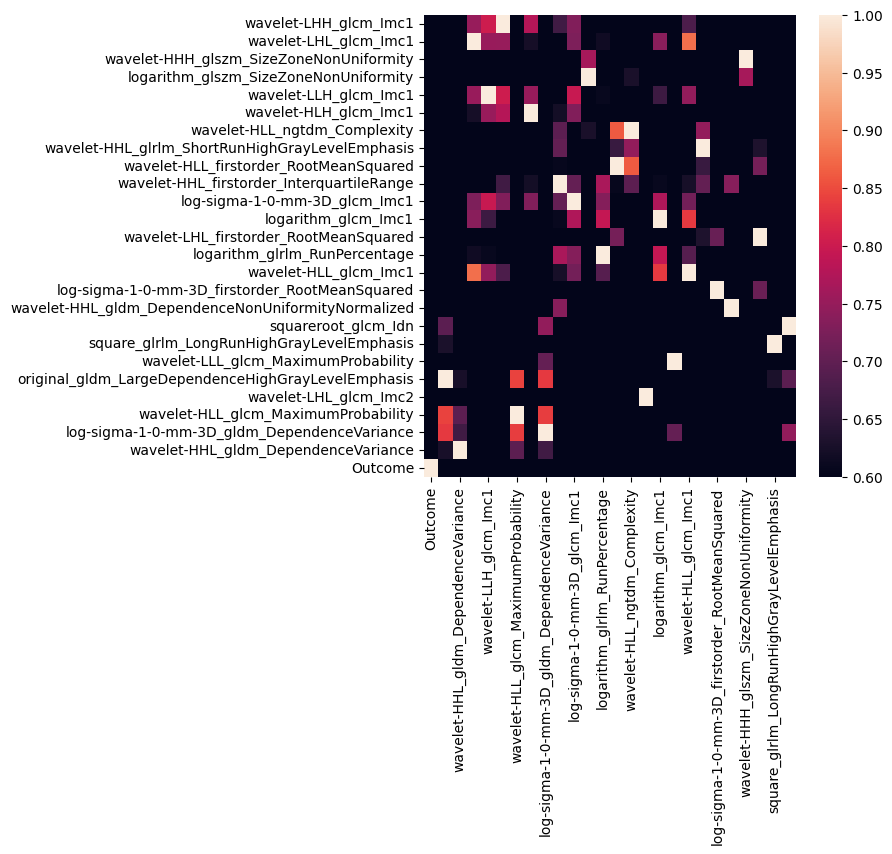

In [ ]:
#E

import seaborn as sb
import matplotlib.pyplot as plt

plt.figure(figsize=(6,6))

dataplot=sb.heatmap(data1.corr().sort_values(by=['Outcome'],ascending=True), vmin=0.6, )

# displaying heatmap
plt.show()



In [ ]:
X = X.loc[:,list(remain_features)]

In [ ]:
data1 = pd.concat([y,X],axis=1)


In [ ]:
data1

,Outcome,wavelet-HHH_glcm_InverseVariance,wavelet-HLH_gldm_DependenceNonUniformityNormalized,log-sigma-5-0-mm-3D_glszm_GrayLevelNonUniformityNormalized,wavelet-LLL_firstorder_Minimum,original_shape_Elongation,logarithm_glszm_SizeZoneNonUniformityNormalized,exponential_ngtdm_Contrast,log-sigma-5-0-mm-3D_glrlm_RunEntropy,wavelet-HLL_firstorder_Median,...,wavelet-LLL_gldm_SmallDependenceHighGrayLevelEmphasis,original_gldm_SmallDependenceLowGrayLevelEmphasis,original_firstorder_Maximum,log-sigma-1-0-mm-3D_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneEntropy,original_shape_MajorAxisLength,wavelet-LHH_ngtdm_Strength,log-sigma-5-0-mm-3D_firstorder_Maximum,squareroot_firstorder_Minimum,square_gldm_DependenceNonUniformityNormalized
0,1,0.898664,0.026936,0.234197,0.111158,0.483319,0.596987,0.002794,0.914120,0.678576,...,0.285746,0.071709,0.623160,0.436774,0.838502,0.763928,0.031639,0.439309,0.129184,0.012760
1,1,0.928364,0.051396,0.386746,0.106534,1.000000,0.255937,0.005667,0.572458,0.532277,...,0.176121,0.089518,0.230099,0.062227,0.623224,0.248429,0.108685,0.599541,0.196530,0.101019
2,1,0.970117,0.111269,0.405598,0.082477,0.273534,0.718089,0.028316,0.602946,0.569559,...,0.413886,0.130235,0.385372,0.151215,0.699084,0.578958,0.052208,0.450550,0.121551,0.140713
3,1,0.806006,0.013985,0.034627,0.191576,0.534473,0.612711,0.002129,0.786786,0.773444,...,0.414276,0.127346,1.000000,0.408944,0.641608,0.598475,0.133520,0.492976,0.110154,0.049974
4,1,0.732394,0.194088,0.273843,0.260537,0.602692,1.000000,0.001874,0.634654,1.000000,...,0.146405,0.411979,0.625861,0.133195,0.502231,0.224525,0.083503,0.524854,0.168041,0.023946
5,1,0.567974,0.565787,0.292941,0.224100,0.294349,0.702775,0.043171,0.627174,0.832611,...,0.673798,0.158958,0.604219,0.330464,0.628703,0.571994,0.176828,0.464194,0.119529,0.296093
6,1,0.873433,0.041922,0.152526,0.066563,0.863997,0.084162,0.001161,0.794243,0.588039,...,0.241485,0.013122,0.571694,0.255764,1.000000,0.625656,0.017385,0.638922,0.094033,0.121009
7,1,0.814897,0.391615,0.375698,0.272328,0.198407,0.787138,0.003959,0.603818,0.402363,...,0.273700,0.144864,0.491671,0.127008,0.308299,0.585210,0.165497,0.367955,0.164759,0.184102
8,0,0.679979,0.340615,0.269808,0.206070,0.395680,0.762170,0.003942,0.784766,0.683906,...,0.278967,0.362492,0.693006,0.286918,0.811683,0.554201,0.174893,0.585897,0.189993,0.074253
9,0,0.699693,0.377113,0.274744,0.262157,0.437462,0.537290,0.009399,0.585304,0.638649,...,0.277914,0.160536,0.371334,0.230129,0.586455,0.558478,0.061153,0.541380,0.224227,0.205741


In [ ]:
Y= data1["Outcome"].astype('int64')

data1= pd.concat([Y, data1.drop("Outcome", axis=1)], axis=1)

In [ ]:
data_exp= data1

In [ ]:
df_drop = data_exp.dropna(axis=0)
df_drop.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 135 entries, 0 to 134
Columns: 346 entries, Outcome to square_gldm_DependenceNonUniformityNormalized
dtypes: float64(345), int64(1)
memory usage: 365.0 KB


In [ ]:
df_drop.shape

(135, 346)

In [ ]:
data_out= df_drop
data_out= data1

In [ ]:
#TTS

class_mapping = {label: idx for idx, label in enumerate(np.unique(data_out['Outcome']))}
class_mapping

{0: 0, 1: 1}

In [ ]:
ratio= float(data_out['Outcome'].value_counts()[0])/float(data_out['Outcome'].value_counts()[1])

ratio

0.5340909090909091

In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import label_binarize

data_out['Outcome'] = data_out['Outcome'].map(class_mapping)
y = LabelEncoder().fit_transform(data_out['Outcome'].values)
X = data_out.iloc[:,1:]
print(y.shape)
print(X.shape)

# data_fil['Outcome'] = data_fil['Outcome'].map(class_mapping)
# y = LabelEncoder().fit_transform(data_fil['Outcome'].values)
# X = data_fil.iloc[:,1:]
# print(y.shape)
# print(X.shape)

(135,)
(135, 345)


In [ ]:
X

,wavelet-HHH_glcm_InverseVariance,wavelet-HLH_gldm_DependenceNonUniformityNormalized,log-sigma-5-0-mm-3D_glszm_GrayLevelNonUniformityNormalized,wavelet-LLL_firstorder_Minimum,original_shape_Elongation,logarithm_glszm_SizeZoneNonUniformityNormalized,exponential_ngtdm_Contrast,log-sigma-5-0-mm-3D_glrlm_RunEntropy,wavelet-HLL_firstorder_Median,wavelet-LHL_ngtdm_Contrast,...,wavelet-LLL_gldm_SmallDependenceHighGrayLevelEmphasis,original_gldm_SmallDependenceLowGrayLevelEmphasis,original_firstorder_Maximum,log-sigma-1-0-mm-3D_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneEntropy,original_shape_MajorAxisLength,wavelet-LHH_ngtdm_Strength,log-sigma-5-0-mm-3D_firstorder_Maximum,squareroot_firstorder_Minimum,square_gldm_DependenceNonUniformityNormalized
0,0.898664,0.026936,0.234197,0.111158,0.483319,0.596987,0.002794,0.914120,0.678576,0.014866,...,0.285746,0.071709,0.623160,0.436774,0.838502,0.763928,0.031639,0.439309,0.129184,0.012760
1,0.928364,0.051396,0.386746,0.106534,1.000000,0.255937,0.005667,0.572458,0.532277,0.046755,...,0.176121,0.089518,0.230099,0.062227,0.623224,0.248429,0.108685,0.599541,0.196530,0.101019
2,0.970117,0.111269,0.405598,0.082477,0.273534,0.718089,0.028316,0.602946,0.569559,0.019999,...,0.413886,0.130235,0.385372,0.151215,0.699084,0.578958,0.052208,0.450550,0.121551,0.140713
3,0.806006,0.013985,0.034627,0.191576,0.534473,0.612711,0.002129,0.786786,0.773444,0.030813,...,0.414276,0.127346,1.000000,0.408944,0.641608,0.598475,0.133520,0.492976,0.110154,0.049974
4,0.732394,0.194088,0.273843,0.260537,0.602692,1.000000,0.001874,0.634654,1.000000,0.116441,...,0.146405,0.411979,0.625861,0.133195,0.502231,0.224525,0.083503,0.524854,0.168041,0.023946
5,0.567974,0.565787,0.292941,0.224100,0.294349,0.702775,0.043171,0.627174,0.832611,0.096710,...,0.673798,0.158958,0.604219,0.330464,0.628703,0.571994,0.176828,0.464194,0.119529,0.296093
6,0.873433,0.041922,0.152526,0.066563,0.863997,0.084162,0.001161,0.794243,0.588039,0.002969,...,0.241485,0.013122,0.571694,0.255764,1.000000,0.625656,0.017385,0.638922,0.094033,0.121009
7,0.814897,0.391615,0.375698,0.272328,0.198407,0.787138,0.003959,0.603818,0.402363,0.013199,...,0.273700,0.144864,0.491671,0.127008,0.308299,0.585210,0.165497,0.367955,0.164759,0.184102
8,0.679979,0.340615,0.269808,0.206070,0.395680,0.762170,0.003942,0.784766,0.683906,0.021660,...,0.278967,0.362492,0.693006,0.286918,0.811683,0.554201,0.174893,0.585897,0.189993,0.074253
9,0.699693,0.377113,0.274744,0.262157,0.437462,0.537290,0.009399,0.585304,0.638649,0.048818,...,0.277914,0.160536,0.371334,0.230129,0.586455,0.558478,0.061153,0.541380,0.224227,0.205741


In [ ]:
y

array([1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1,
       1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0,
       1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1,
       0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1,
       0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1])

In [ ]:
##SSS

Y=data1["Outcome"].astype('int64')

In [ ]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(Y)

In [ ]:
data_out

,Outcome,wavelet-HHH_glcm_InverseVariance,wavelet-HLH_gldm_DependenceNonUniformityNormalized,log-sigma-5-0-mm-3D_glszm_GrayLevelNonUniformityNormalized,wavelet-LLL_firstorder_Minimum,original_shape_Elongation,logarithm_glszm_SizeZoneNonUniformityNormalized,exponential_ngtdm_Contrast,log-sigma-5-0-mm-3D_glrlm_RunEntropy,wavelet-HLL_firstorder_Median,...,wavelet-LLL_gldm_SmallDependenceHighGrayLevelEmphasis,original_gldm_SmallDependenceLowGrayLevelEmphasis,original_firstorder_Maximum,log-sigma-1-0-mm-3D_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneEntropy,original_shape_MajorAxisLength,wavelet-LHH_ngtdm_Strength,log-sigma-5-0-mm-3D_firstorder_Maximum,squareroot_firstorder_Minimum,square_gldm_DependenceNonUniformityNormalized
0,1,0.898664,0.026936,0.234197,0.111158,0.483319,0.596987,0.002794,0.914120,0.678576,...,0.285746,0.071709,0.623160,0.436774,0.838502,0.763928,0.031639,0.439309,0.129184,0.012760
1,1,0.928364,0.051396,0.386746,0.106534,1.000000,0.255937,0.005667,0.572458,0.532277,...,0.176121,0.089518,0.230099,0.062227,0.623224,0.248429,0.108685,0.599541,0.196530,0.101019
2,1,0.970117,0.111269,0.405598,0.082477,0.273534,0.718089,0.028316,0.602946,0.569559,...,0.413886,0.130235,0.385372,0.151215,0.699084,0.578958,0.052208,0.450550,0.121551,0.140713
3,1,0.806006,0.013985,0.034627,0.191576,0.534473,0.612711,0.002129,0.786786,0.773444,...,0.414276,0.127346,1.000000,0.408944,0.641608,0.598475,0.133520,0.492976,0.110154,0.049974
4,1,0.732394,0.194088,0.273843,0.260537,0.602692,1.000000,0.001874,0.634654,1.000000,...,0.146405,0.411979,0.625861,0.133195,0.502231,0.224525,0.083503,0.524854,0.168041,0.023946
5,1,0.567974,0.565787,0.292941,0.224100,0.294349,0.702775,0.043171,0.627174,0.832611,...,0.673798,0.158958,0.604219,0.330464,0.628703,0.571994,0.176828,0.464194,0.119529,0.296093
6,1,0.873433,0.041922,0.152526,0.066563,0.863997,0.084162,0.001161,0.794243,0.588039,...,0.241485,0.013122,0.571694,0.255764,1.000000,0.625656,0.017385,0.638922,0.094033,0.121009
7,1,0.814897,0.391615,0.375698,0.272328,0.198407,0.787138,0.003959,0.603818,0.402363,...,0.273700,0.144864,0.491671,0.127008,0.308299,0.585210,0.165497,0.367955,0.164759,0.184102
8,0,0.679979,0.340615,0.269808,0.206070,0.395680,0.762170,0.003942,0.784766,0.683906,...,0.278967,0.362492,0.693006,0.286918,0.811683,0.554201,0.174893,0.585897,0.189993,0.074253
9,0,0.699693,0.377113,0.274744,0.262157,0.437462,0.537290,0.009399,0.585304,0.638649,...,0.277914,0.160536,0.371334,0.230129,0.586455,0.558478,0.061153,0.541380,0.224227,0.205741


In [ ]:
#1
Y= pd.DataFrame(Y)

data_out= data_out.drop(data_out.iloc[:, :1], axis=1)

# df_test.drop(final_df_test.iloc[:, :26], axis=1)

data_out

,wavelet-HHH_glcm_InverseVariance,wavelet-HLH_gldm_DependenceNonUniformityNormalized,log-sigma-5-0-mm-3D_glszm_GrayLevelNonUniformityNormalized,wavelet-LLL_firstorder_Minimum,original_shape_Elongation,logarithm_glszm_SizeZoneNonUniformityNormalized,exponential_ngtdm_Contrast,log-sigma-5-0-mm-3D_glrlm_RunEntropy,wavelet-HLL_firstorder_Median,wavelet-LHL_ngtdm_Contrast,...,wavelet-LLL_gldm_SmallDependenceHighGrayLevelEmphasis,original_gldm_SmallDependenceLowGrayLevelEmphasis,original_firstorder_Maximum,log-sigma-1-0-mm-3D_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneEntropy,original_shape_MajorAxisLength,wavelet-LHH_ngtdm_Strength,log-sigma-5-0-mm-3D_firstorder_Maximum,squareroot_firstorder_Minimum,square_gldm_DependenceNonUniformityNormalized
0,0.898664,0.026936,0.234197,0.111158,0.483319,0.596987,0.002794,0.914120,0.678576,0.014866,...,0.285746,0.071709,0.623160,0.436774,0.838502,0.763928,0.031639,0.439309,0.129184,0.012760
1,0.928364,0.051396,0.386746,0.106534,1.000000,0.255937,0.005667,0.572458,0.532277,0.046755,...,0.176121,0.089518,0.230099,0.062227,0.623224,0.248429,0.108685,0.599541,0.196530,0.101019
2,0.970117,0.111269,0.405598,0.082477,0.273534,0.718089,0.028316,0.602946,0.569559,0.019999,...,0.413886,0.130235,0.385372,0.151215,0.699084,0.578958,0.052208,0.450550,0.121551,0.140713
3,0.806006,0.013985,0.034627,0.191576,0.534473,0.612711,0.002129,0.786786,0.773444,0.030813,...,0.414276,0.127346,1.000000,0.408944,0.641608,0.598475,0.133520,0.492976,0.110154,0.049974
4,0.732394,0.194088,0.273843,0.260537,0.602692,1.000000,0.001874,0.634654,1.000000,0.116441,...,0.146405,0.411979,0.625861,0.133195,0.502231,0.224525,0.083503,0.524854,0.168041,0.023946
5,0.567974,0.565787,0.292941,0.224100,0.294349,0.702775,0.043171,0.627174,0.832611,0.096710,...,0.673798,0.158958,0.604219,0.330464,0.628703,0.571994,0.176828,0.464194,0.119529,0.296093
6,0.873433,0.041922,0.152526,0.066563,0.863997,0.084162,0.001161,0.794243,0.588039,0.002969,...,0.241485,0.013122,0.571694,0.255764,1.000000,0.625656,0.017385,0.638922,0.094033,0.121009
7,0.814897,0.391615,0.375698,0.272328,0.198407,0.787138,0.003959,0.603818,0.402363,0.013199,...,0.273700,0.144864,0.491671,0.127008,0.308299,0.585210,0.165497,0.367955,0.164759,0.184102
8,0.679979,0.340615,0.269808,0.206070,0.395680,0.762170,0.003942,0.784766,0.683906,0.021660,...,0.278967,0.362492,0.693006,0.286918,0.811683,0.554201,0.174893,0.585897,0.189993,0.074253
9,0.699693,0.377113,0.274744,0.262157,0.437462,0.537290,0.009399,0.585304,0.638649,0.048818,...,0.277914,0.160536,0.371334,0.230129,0.586455,0.558478,0.061153,0.541380,0.224227,0.205741


In [ ]:
X= data_out

In [ ]:
Y

,0
0,1
1,1
2,1
3,1
4,1
5,1
6,1
7,1
8,0
9,0


Index(['wavelet-HHH_glcm_InverseVariance',
       'wavelet-HLH_gldm_DependenceNonUniformityNormalized',
       'original_shape_Elongation',
       'logarithm_glszm_SizeZoneNonUniformityNormalized',
       'log-sigma-5-0-mm-3D_glrlm_RunEntropy', 'wavelet-HLL_firstorder_Median',
       'square_glszm_SizeZoneNonUniformity',
       'log-sigma-5-0-mm-3D_glszm_ZoneEntropy', 'wavelet-HLL_ngtdm_Complexity',
       'logarithm_ngtdm_Coarseness',
       ...
       'wavelet-HHH_glcm_ClusterShade', 'square_glcm_MaximumProbability',
       'logarithm_ngtdm_Busyness',
       'log-sigma-3-0-mm-3D_firstorder_90Percentile',
       'wavelet-LHL_glcm_ClusterShade', 'wavelet-HHH_firstorder_Minimum',
       'log-sigma-1-0-mm-3D_glcm_Imc2', 'original_firstorder_Maximum',
       'log-sigma-1-0-mm-3D_glszm_SizeZoneNonUniformity',
       'square_gldm_DependenceNonUniformityNormalized'],
      dtype='object', length=150)
[1 0 1 1 0 1 1 0 1 0 1 0 1 0 1 1 1 0 0 0 1 1 1 1 1 1 1 1 0 1 1 0 1 1 0 1 1
 0 1 1 1]
[0 0 0 

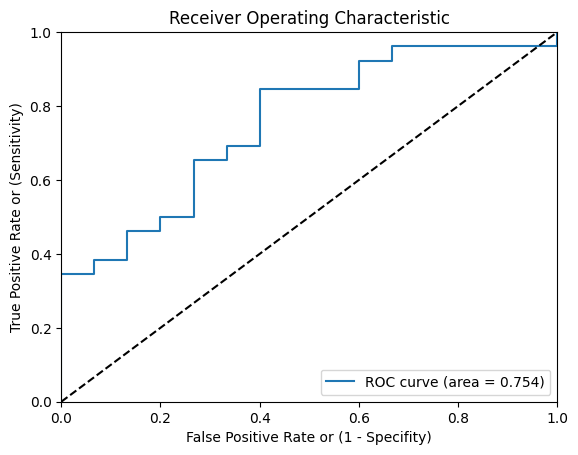

In [ ]:
#Best final_imp Initial

from sklearn.model_selection import train_test_split



X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

# X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
#     Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]


test = SelectKBest(score_func=f_classif, k=150)
model = test.fit(X_train, Y_train.ravel())

# mask = model.get_support()
# new_features = X_train.columns[mask]
# new_fdf= Y= pd.DataFrame(new_features)

X_train = model.transform(X_train)
X_test= model.transform(X_test)

# clf = XGBClassifier(n_estimators=127, max_depth=3, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)

clf=  XGBClassifier(learning_rate =0.01,
 n_estimators=450,
 max_depth=5,
 min_child_weight=1,
 gamma=0.2,
 subsample=0.75,
 colsample_bytree=0.8,
 reg_alpha=1e-03,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=0.54,
 seed=27).fit(X_train, Y_train)

pred = clf.predict(X_test)
print(pred)
print(Y_test.ravel())
pre_l = precision_score(Y_test, pred)
rec_l = recall_score(Y_test, pred)
sens_l= recall_score(Y_test, pred, pos_label=1)
specs_l= recall_score(Y_test, pred, pos_label=0)
acc_l = accuracy_score(Y_test, pred)
probs = clf.predict_proba(X_test)
probs = probs[:, 1]
auc_l = roc_auc_score(Y_test, probs)
f1_l= f1_score(Y_test, pred)
ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

pred = clf.predict(X_train)
pre_lt = precision_score(Y_train, pred)
rec_lt = recall_score(Y_train, pred)
sens_lt= recall_score(Y_train, pred, pos_label=1)
specs_lt= recall_score(Y_train, pred, pos_label=0)
acc_lt = accuracy_score(Y_train, pred)
probs = clf.predict_proba(X_train)
probs = probs[:, 1]
auc_lt = roc_auc_score(Y_train, probs)
f1_lt = f1_score(Y_train, pred)
ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



# auc_lr.append(auc_l)
# pre_lr.append(pre_l)
# rec_lr.append(rec_l)
# acc_lr.append(acc_l)
# f1_lr.append(f1_l)
# sens_lr.append(sens_l)
# specs_lr.append(specs_l)



# auc_lrt.append(auc_lt)
# pre_lrt.append(pre_lt)
# rec_lrt.append(rec_lt)
# acc_lrt.append(acc_lt)
# f1_lrt.append(f1_lt)
# sens_lrt.append(sens_lt)
# specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", pre_lt)
print("REC:", rec_lt)
print("ACC:", acc_lt)
print("AUC:", auc_lt)
print("F1:", f1_lt)
print("Sensitivity:", sens_lt)
print("Specificity:", specs_lt)


print("TEST:")
print("PRE:", pre_l)
print("REC:", rec_l)
print("ACC:", acc_l)
print("AUC:", auc_l)
print("F1:", f1_l)
print("Sensitivity:", sens_l)
print("Specificity:", specs_l)


[1 1 1 1 0 1 1 0 1 0 1 1 1 0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1
 0 1 1 1]
[0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1
 0 1 1 1]
TRAIN:
PRE: 1.0
REC: 1.0
ACC: 1.0
AUC: 1.0
F1: 1.0
Sensitivity: 1.0
Specificity: 1.0
TEST:
PRE: 0.7272727272727273
REC: 0.9230769230769231
ACC: 0.7317073170731707
AUC: 0.6615384615384616
F1: 0.8135593220338984
Sensitivity: 0.9230769230769231
Specificity: 0.4


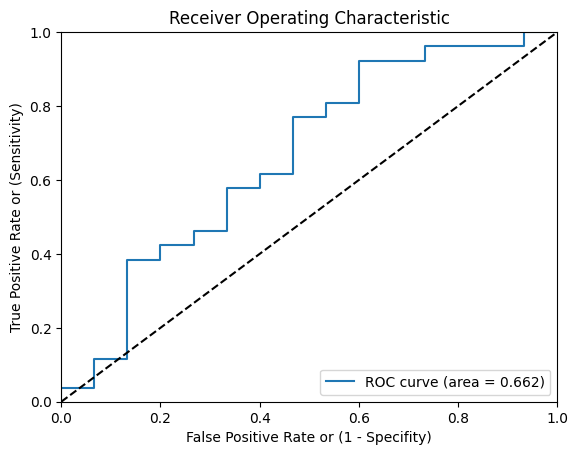

In [ ]:
"#Best Initial

from sklearn.model_selection import train_test_split



X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
#     Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]


test = SelectKBest(score_func=f_classif, k=300)
model = test.fit(X_train, Y_train.ravel())

# mask = model.get_support()
# new_features = X_train.columns[mask]
# print(new_features)

X_train = model.transform(X_train)
X_test= model.transform(X_test)

# clf = XGBClassifier(n_estimators=127, max_depth=3, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)

clf=  XGBClassifier(learning_rate =0.105,
 n_estimators=450,
 max_depth=3,
 min_child_weight=3,
 gamma=0.2,
 subsample=0.75,
 colsample_bytree=0.75,
 reg_alpha=1e-05,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27).fit(X_train, Y_train)

pred = clf.predict(X_test)
print(pred)
print(Y_test.ravel())
pre_l = precision_score(Y_test, pred)
rec_l = recall_score(Y_test, pred)
sens_l= recall_score(Y_test, pred, pos_label=1)
specs_l= recall_score(Y_test, pred, pos_label=0)
acc_l = accuracy_score(Y_test, pred)
probs = clf.predict_proba(X_test)
probs = probs[:, 1]
auc_l = roc_auc_score(Y_test, probs)
f1_l= f1_score(Y_test, pred)
ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

pred = clf.predict(X_train)
pre_lt = precision_score(Y_train, pred)
rec_lt = recall_score(Y_train, pred)
sens_lt= recall_score(Y_train, pred, pos_label=1)
specs_lt= recall_score(Y_train, pred, pos_label=0)
acc_lt = accuracy_score(Y_train, pred)
probs = clf.predict_proba(X_train)
probs = probs[:, 1]
auc_lt = roc_auc_score(Y_train, probs)
f1_lt = f1_score(Y_train, pred)
ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



# auc_lr.append(auc_l)
# pre_lr.append(pre_l)
# rec_lr.append(rec_l)
# acc_lr.append(acc_l)
# f1_lr.append(f1_l)
# sens_lr.append(sens_l)
# specs_lr.append(specs_l)



# auc_lrt.append(auc_lt)
# pre_lrt.append(pre_lt)
# rec_lrt.append(rec_lt)
# acc_lrt.append(acc_lt)
# f1_lrt.append(f1_lt)
# sens_lrt.append(sens_lt)
# specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", pre_lt)
print("REC:", rec_lt)
print("ACC:", acc_lt)
print("AUC:", auc_lt)
print("F1:", f1_lt)
print("Sensitivity:", sens_lt)
print("Specificity:", specs_lt)


print("TEST:")
print("PRE:", pre_l)
print("REC:", rec_l)
print("ACC:", acc_l)
print("AUC:", auc_l)
print("F1:", f1_l)
print("Sensitivity:", sens_l)
print("Specificity:", specs_l)


[0 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1
 0 1 1 1]
[0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1
 0 1 1 1]
TRAIN:
PRE: 1.0
REC: 1.0
ACC: 1.0
AUC: 1.0
F1: 1.0
Sensitivity: 1.0
Specificity: 1.0
TEST:
PRE: 0.7666666666666667
REC: 0.8846153846153846
ACC: 0.7560975609756098
AUC: 0.7256410256410257
F1: 0.8214285714285715
Sensitivity: 0.8846153846153846
Specificity: 0.5333333333333333


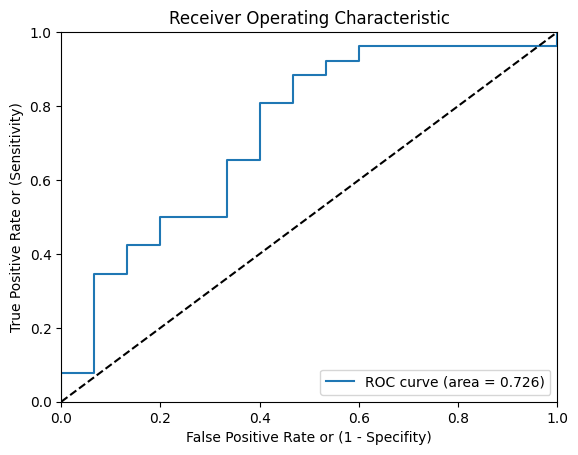

In [ ]:
from sklearn.model_selection import train_test_split



X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
#     Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]


test = SelectKBest(score_func=f_classif, k=300)
model = test.fit(X_train, Y_train.ravel())

# mask = model.get_support()
# new_features = X_train.columns[mask]
# print(new_features)

X_train = model.transform(X_train)
X_test= model.transform(X_test)

# clf = XGBClassifier(n_estimators=127, max_depth=3, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)

clf=  XGBClassifier(learning_rate =0.105,
 n_estimators=450,
 max_depth=3,
 min_child_weight=3,
 gamma=0.2,
 subsample=0.75,
 colsample_bytree=0.8,
 reg_alpha=1e-03,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27).fit(X_train, Y_train)

pred = clf.predict(X_test)
print(pred)
print(Y_test.ravel())
pre_l = precision_score(Y_test, pred)
rec_l = recall_score(Y_test, pred)
sens_l= recall_score(Y_test, pred, pos_label=1)
specs_l= recall_score(Y_test, pred, pos_label=0)
acc_l = accuracy_score(Y_test, pred)
probs = clf.predict_proba(X_test)
probs = probs[:, 1]
auc_l = roc_auc_score(Y_test, probs)
f1_l= f1_score(Y_test, pred)
ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

pred = clf.predict(X_train)
pre_lt = precision_score(Y_train, pred)
rec_lt = recall_score(Y_train, pred)
sens_lt= recall_score(Y_train, pred, pos_label=1)
specs_lt= recall_score(Y_train, pred, pos_label=0)
acc_lt = accuracy_score(Y_train, pred)
probs = clf.predict_proba(X_train)
probs = probs[:, 1]
auc_lt = roc_auc_score(Y_train, probs)
f1_lt = f1_score(Y_train, pred)
ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



# auc_lr.append(auc_l)
# pre_lr.append(pre_l)
# rec_lr.append(rec_l)
# acc_lr.append(acc_l)
# f1_lr.append(f1_l)
# sens_lr.append(sens_l)
# specs_lr.append(specs_l)



# auc_lrt.append(auc_lt)
# pre_lrt.append(pre_lt)
# rec_lrt.append(rec_lt)
# acc_lrt.append(acc_lt)
# f1_lrt.append(f1_lt)
# sens_lrt.append(sens_lt)
# specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", pre_lt)
print("REC:", rec_lt)
print("ACC:", acc_lt)
print("AUC:", auc_lt)
print("F1:", f1_lt)
print("Sensitivity:", sens_lt)
print("Specificity:", specs_lt)


print("TEST:")
print("PRE:", pre_l)
print("REC:", rec_l)
print("ACC:", acc_l)
print("AUC:", auc_l)
print("F1:", f1_l)
print("Sensitivity:", sens_l)
print("Specificity:", specs_l)


[0 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1
 0 1 1 1]
[0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1
 0 1 1 1]
TRAIN:
PRE: 1.0
REC: 1.0
ACC: 1.0
AUC: 1.0
F1: 1.0
Sensitivity: 1.0
Specificity: 1.0
TEST:
PRE: 0.7741935483870968
REC: 0.9230769230769231
ACC: 0.7804878048780488
AUC: 0.7846153846153847
F1: 0.8421052631578947
Sensitivity: 0.9230769230769231
Specificity: 0.5333333333333333


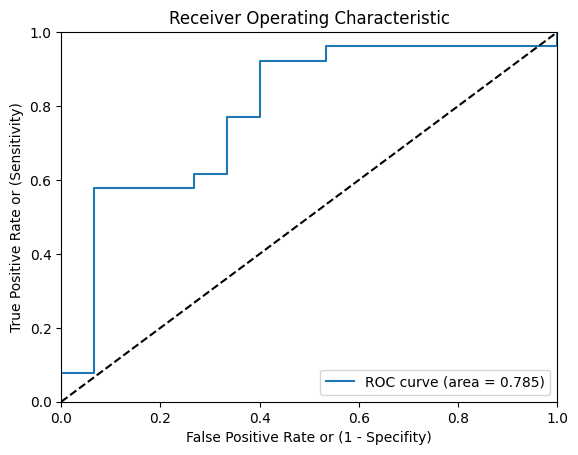

In [ ]:
#Final best1

from sklearn.model_selection import train_test_split



X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
#     Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]


test = SelectKBest(score_func=f_classif, k=300)
model = test.fit(X_train, Y_train.ravel())

# mask = model.get_support()
# new_features = X_train.columns[mask]
# print(new_features)

X_train = model.transform(X_train)
X_test= model.transform(X_test)

# clf = XGBClassifier(n_estimators=127, max_depth=3, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)

clf=  XGBClassifier(learning_rate =0.105,
 n_estimators=550,
 max_depth=3,
 min_child_weight=3,
 gamma=0.2,
 subsample=0.8,
 colsample_bytree=0.8,
 reg_alpha=1e-03,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27).fit(X_train, Y_train)

pred = clf.predict(X_test)
print(pred)
print(Y_test.ravel())
pre_l = precision_score(Y_test, pred)
rec_l = recall_score(Y_test, pred)
sens_l= recall_score(Y_test, pred, pos_label=1)
specs_l= recall_score(Y_test, pred, pos_label=0)
acc_l = accuracy_score(Y_test, pred)
probs = clf.predict_proba(X_test)
probs = probs[:, 1]
auc_l = roc_auc_score(Y_test, probs)
f1_l= f1_score(Y_test, pred)
ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

pred = clf.predict(X_train)
pre_lt = precision_score(Y_train, pred)
rec_lt = recall_score(Y_train, pred)
sens_lt= recall_score(Y_train, pred, pos_label=1)
specs_lt= recall_score(Y_train, pred, pos_label=0)
acc_lt = accuracy_score(Y_train, pred)
probs = clf.predict_proba(X_train)
probs = probs[:, 1]
auc_lt = roc_auc_score(Y_train, probs)
f1_lt = f1_score(Y_train, pred)
ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



# auc_lr.append(auc_l)
# pre_lr.append(pre_l)
# rec_lr.append(rec_l)
# acc_lr.append(acc_l)
# f1_lr.append(f1_l)
# sens_lr.append(sens_l)
# specs_lr.append(specs_l)



# auc_lrt.append(auc_lt)
# pre_lrt.append(pre_lt)
# rec_lrt.append(rec_lt)
# acc_lrt.append(acc_lt)
# f1_lrt.append(f1_lt)
# sens_lrt.append(sens_lt)
# specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", pre_lt)
print("REC:", rec_lt)
print("ACC:", acc_lt)
print("AUC:", auc_lt)
print("F1:", f1_lt)
print("Sensitivity:", sens_lt)
print("Specificity:", specs_lt)


print("TEST:")
print("PRE:", pre_l)
print("REC:", rec_l)
print("ACC:", acc_l)
print("AUC:", auc_l)
print("F1:", f1_l)
print("Sensitivity:", sens_l)
print("Specificity:", specs_l)


In [ ]:
# from sklearn.preprocessing import StandardScaler

# std = StandardScaler()
# X_std = std.fit_transform(X)
# print(X_std.shape)


[0 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 0 1 1 0 0 1 0 1 0 0 1 1
 0 1 1 1]
[0 0 0 1 0 1 1 0 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 0 0 1 0 1 1 0 1 1
 0 1 1 1]
TRAIN:
PRE: 1.0
REC: 1.0
ACC: 1.0
AUC: 1.0
F1: 1.0
Sensitivity: 1.0
Specificity: 1.0
TEST:
PRE: 0.7931034482758621
REC: 0.8846153846153846
ACC: 0.7804878048780488
AUC: 0.735897435897436
F1: 0.8363636363636363
Sensitivity: 0.8846153846153846
Specificity: 0.6


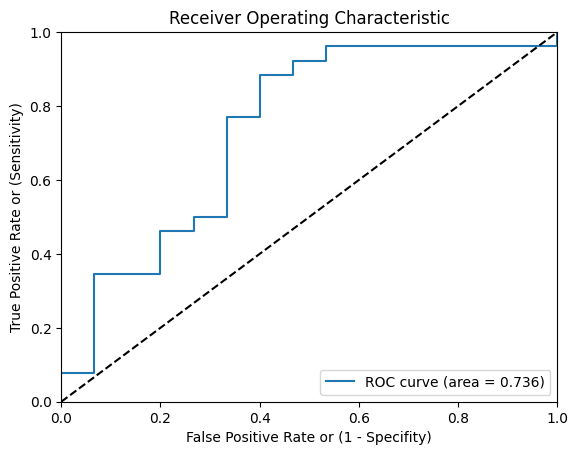

In [ ]:
#Final best 2

from sklearn.model_selection import train_test_split



X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# X_train, X_test = final_df_test.iloc[train_index], final_df_test.iloc[test_index]
#     Y_train, Y_test= Y.iloc[train_index], Y.iloc[test_index]


test = SelectKBest(score_func=f_classif, k=300)
model = test.fit(X_train, Y_train.ravel())

# mask = model.get_support()
# new_features = X_train.columns[mask]
# print(new_features)

X_train = model.transform(X_train)
X_test= model.transform(X_test)

# clf = XGBClassifier(n_estimators=127, max_depth=3, learning_rate=0.1, min_child_weight=1, objective= "binary:logistic" ).fit(X_train, Y_train)

clf=  XGBClassifier(learning_rate =0.105,
 n_estimators=500,
 max_depth=3,
 min_child_weight=3,
 gamma=0.3,
 subsample=0.75,
 colsample_bytree=0.75,
 reg_alpha=1e-03,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27).fit(X_train, Y_train)

pred = clf.predict(X_test)
print(pred)
print(Y_test.ravel())
pre_l = precision_score(Y_test, pred)
rec_l = recall_score(Y_test, pred)
sens_l= recall_score(Y_test, pred, pos_label=1)
specs_l= recall_score(Y_test, pred, pos_label=0)
acc_l = accuracy_score(Y_test, pred)
probs = clf.predict_proba(X_test)
probs = probs[:, 1]
auc_l = roc_auc_score(Y_test, probs)
f1_l= f1_score(Y_test, pred)
ns_fpr_l, ns_tpr_l, _ = roc_curve(Y_test, probs)


plot_crv(ns_fpr_l, ns_tpr_l, auc_l)

pred = clf.predict(X_train)
pre_lt = precision_score(Y_train, pred)
rec_lt = recall_score(Y_train, pred)
sens_lt= recall_score(Y_train, pred, pos_label=1)
specs_lt= recall_score(Y_train, pred, pos_label=0)
acc_lt = accuracy_score(Y_train, pred)
probs = clf.predict_proba(X_train)
probs = probs[:, 1]
auc_lt = roc_auc_score(Y_train, probs)
f1_lt = f1_score(Y_train, pred)
ns_fpr_lt, ns_tpr_lt, _ = roc_curve(Y_train, probs)



# auc_lr.append(auc_l)
# pre_lr.append(pre_l)
# rec_lr.append(rec_l)
# acc_lr.append(acc_l)
# f1_lr.append(f1_l)
# sens_lr.append(sens_l)
# specs_lr.append(specs_l)



# auc_lrt.append(auc_lt)
# pre_lrt.append(pre_lt)
# rec_lrt.append(rec_lt)
# acc_lrt.append(acc_lt)
# f1_lrt.append(f1_lt)
# sens_lrt.append(sens_lt)
# specs_lrt.append(specs_lt)

print("TRAIN:")
print("PRE:", pre_lt)
print("REC:", rec_lt)
print("ACC:", acc_lt)
print("AUC:", auc_lt)
print("F1:", f1_lt)
print("Sensitivity:", sens_lt)
print("Specificity:", specs_lt)


print("TEST:")
print("PRE:", pre_l)
print("REC:", rec_l)
print("ACC:", acc_l)
print("AUC:", auc_l)
print("F1:", f1_l)
print("Sensitivity:", sens_l)
print("Specificity:", specs_l)


In [ ]:
print(X.shape, y.shape)

(92, 337) (92,)


In [ ]:
def modelfit(alg, dtrain, predictors,useTrainCV=True, cv_folds=5, early_stopping_rounds=100):

    if useTrainCV:
        xgb_param = alg.get_xgb_params()
        xgtrain = xgb.DMatrix(dtrain[predictors].values, label=dtrain[target].values)
        cvresult = xgb.cv(xgb_param, xgtrain, num_boost_round=alg.get_params()['n_estimators'], nfold=cv_folds,
            metrics='auc', early_stopping_rounds=early_stopping_rounds, verbose_eval= True)
        alg.set_params(n_estimators=cvresult.shape[0])


    #Fit the algorithm on the data
    alg.fit(dtrain[predictors], dtrain['Outcome'])

    #Predict training set:
    dtrain_predictions = alg.predict(dtrain[predictors])
    dtrain_predprob = alg.predict_proba(dtrain[predictors])[:,1]

    #Print model report:
    print("\nModel Report")
    print("Accuracy : %.4g" % metrics.accuracy_score(dtrain['Outcome'].values, dtrain_predictions))
    print("AUC Score (Train): %f" % metrics.roc_auc_score(dtrain['Outcome'], dtrain_predprob))

    feat_imp = pd.Series(alg.get_booster().get_fscore()).sort_values(ascending=False)
    feat_imp.plot(kind='bar', title='Feature Importances')
    plt.ylabel('Feature Importance Score')

[0]	train-auc:0.90236+0.02019	test-auc:0.54720+0.08508
[1]	train-auc:0.96072+0.01200	test-auc:0.55292+0.10030
[2]	train-auc:0.97863+0.00861	test-auc:0.54849+0.08620
[3]	train-auc:0.98863+0.00379	test-auc:0.53217+0.08295
[4]	train-auc:0.99509+0.00276	test-auc:0.56492+0.08948
[5]	train-auc:0.99665+0.00241	test-auc:0.58654+0.09839
[6]	train-auc:0.99854+0.00156	test-auc:0.60398+0.09621
[7]	train-auc:0.99909+0.00074	test-auc:0.62411+0.10300
[8]	train-auc:0.99901+0.00082	test-auc:0.62586+0.09084
[9]	train-auc:0.99984+0.00031	test-auc:0.63469+0.08581
[10]	train-auc:0.99985+0.00018	test-auc:0.62493+0.08185
[11]	train-auc:0.99985+0.00030	test-auc:0.62162+0.09033
[12]	train-auc:0.99992+0.00015	test-auc:0.63001+0.07495
[13]	train-auc:1.00000+0.00000	test-auc:0.63010+0.08136
[14]	train-auc:1.00000+0.00000	test-auc:0.62255+0.07355
[15]	train-auc:1.00000+0.00000	test-auc:0.61862+0.07342
[16]	train-auc:1.00000+0.00000	test-auc:0.62318+0.08359
[17]	train-auc:1.00000+0.00000	test-auc:0.62713+0.08404
[1

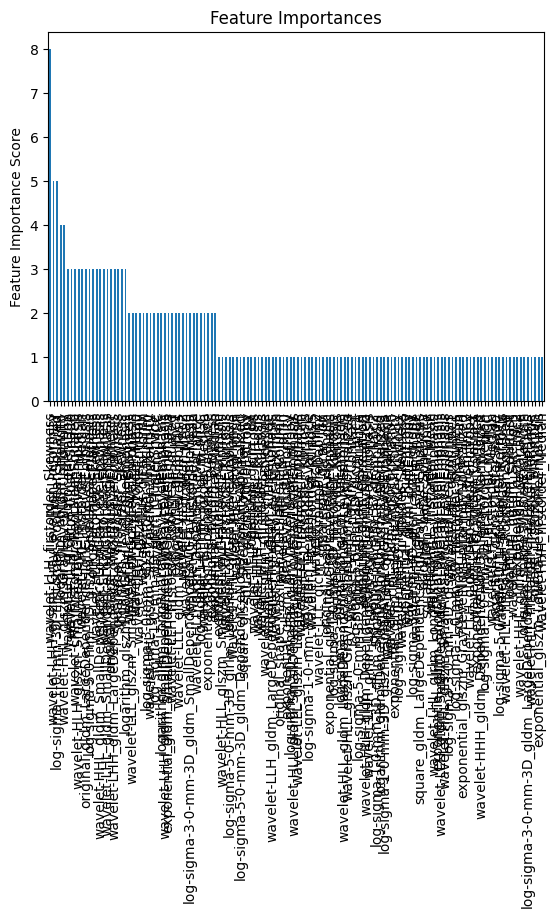

In [ ]:
import xgboost as xgb

target = 'Outcome'
predictors = [x for x in data1.columns if x not in [target]]

# X_train, X_test, Y_train, Y_test = train_test_split(final_df_test, Y, test_size=0.25, random_state=42)



xgb1 = XGBClassifier(
 learning_rate =0.1,
 n_estimators=1000,
 max_depth=5,
 min_child_weight=1,
 gamma=0,
 subsample=0.8,
#  eval_metric='auc',
 colsample_bytree=0.8,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27)
modelfit(xgb1, data1,predictors)

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
# model = XGBClassifier()

# n_estimators = range(50, 400, 10)

# param_grid = dict(n_estimators=n_estimators)

# kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=7)

# grid_search = GridSearchCV(model, param_grid, scoring="neg_log_loss", n_jobs=-1, cv=kfold)
# grid_search.fit(final_df_test[predictors],final_df_test[target])
# grid_search.cv_results_, grid_search.best_params_, grid_search.best_score_

In [ ]:
param_test1 = {
 'max_depth':range(1,10,1),
 'min_child_weight':range(1,6,1)
}
gsearch1 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=128, max_depth=5,
 min_child_weight=1, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1, seed=27),
 param_grid = param_test1, scoring='roc_auc',n_jobs=4, cv=5)
gsearch1.fit(data1[predictors],data1[target])
gsearch1.cv_results_, gsearch1.best_params_, gsearch1.best_score_

({'mean_fit_time': array([2.00058799, 3.64190831, 2.7008956 , 2.07324519, 2.1272284 ,
         4.86170845, 2.75622525, 2.34373679, 2.77643714, 3.60772085,
         3.29560165, 2.38785834, 3.23702712, 2.60694394, 1.77816262,
         2.72698054, 2.85800004, 3.43096743, 1.94640079, 1.72594619,
         2.83284702, 3.54791851, 2.47150774, 1.98141789, 1.77827587,
         3.8773634 , 2.99377584, 2.00807023, 1.87254243, 2.22186379,
         4.33641586, 2.23243666, 1.93282971, 1.84992757, 3.03294296,
         3.45228558, 2.21596961, 1.98166103, 3.59889293, 2.13222237,
         2.77110257, 2.35913534, 2.96243896, 2.62604733, 1.66811194]),
  'std_fit_time': array([0.68751665, 0.12140698, 0.5413795 , 0.20183194, 0.2524076 ,
         0.6687684 , 0.18949206, 0.1408798 , 0.62339615, 0.37403185,
         0.14220013, 0.40409032, 0.48620618, 0.36792434, 0.12646461,
         0.10439386, 0.60478893, 0.12737039, 0.17240795, 0.21535261,
         0.24183118, 0.34686105, 0.59085452, 0.17598146, 0.28265846,

In [ ]:
param_test2 = {
 'max_depth':[2,3,4],
}
gsearch2 = GridSearchCV(estimator = XGBClassifier( learning_rate=0.1, n_estimators=128, max_depth=3,
 min_child_weight=1, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27),
 param_grid = param_test2, scoring='roc_auc',n_jobs=4, cv=5)
gsearch2.fit(data1[predictors],data1[target])
gsearch2.cv_results_, gsearch2.best_params_, gsearch2.best_score_

({'mean_fit_time': array([4.60640974, 3.35007162, 3.11873221]),
  'std_fit_time': array([0.49215385, 0.1325245 , 0.46135595]),
  'mean_score_time': array([0.87917476, 0.46001492, 0.37464876]),
  'std_score_time': array([0.24778738, 0.12434162, 0.05983688]),
  'param_max_depth': masked_array(data=[2, 3, 4],
               mask=[False, False, False],
         fill_value='?',
              dtype=object),
  'params': [{'max_depth': 2}, {'max_depth': 3}, {'max_depth': 4}],
  'split0_test_score': array([0.62962963, 0.64814815, 0.62962963]),
  'split1_test_score': array([0.61111111, 0.65432099, 0.61728395]),
  'split2_test_score': array([0.57407407, 0.54320988, 0.55555556]),
  'split3_test_score': array([0.45294118, 0.51764706, 0.49411765]),
  'split4_test_score': array([0.64117647, 0.65882353, 0.64705882]),
  'mean_test_score': array([0.58178649, 0.60442992, 0.58872912]),
  'std_test_score': array([0.06831788, 0.06105444, 0.05646663]),
  'rank_test_score': array([3, 1, 2], dtype=int32)},
 {'

In [ ]:
param_test3 = {
 'gamma':[i/10.0 for i in range(0,5)]
}
gsearch3 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=128, max_depth=3,
 min_child_weight=1, gamma=0, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27),
 param_grid = param_test3, scoring='roc_auc',n_jobs=4, cv=5)
gsearch3.fit(data1[predictors],data1[target])
gsearch3.cv_results_, gsearch3.best_params_, gsearch3.best_score_

({'mean_fit_time': array([2.50899596, 2.67285838, 4.46875539, 4.22127743, 2.72889032]),
  'std_fit_time': array([0.11313605, 0.18659012, 1.37898723, 0.90110721, 0.50861296]),
  'mean_score_time': array([0.3617867 , 0.4377284 , 0.83912158, 0.61375966, 0.47056146]),
  'std_score_time': array([0.04451819, 0.10442058, 0.29378824, 0.11089804, 0.16659385]),
  'param_gamma': masked_array(data=[0.0, 0.1, 0.2, 0.3, 0.4],
               mask=[False, False, False, False, False],
         fill_value='?',
              dtype=object),
  'params': [{'gamma': 0.0},
   {'gamma': 0.1},
   {'gamma': 0.2},
   {'gamma': 0.3},
   {'gamma': 0.4}],
  'split0_test_score': array([0.64814815, 0.66666667, 0.62962963, 0.66666667, 0.64814815]),
  'split1_test_score': array([0.65432099, 0.62962963, 0.66666667, 0.65432099, 0.62962963]),
  'split2_test_score': array([0.54320988, 0.51851852, 0.58641975, 0.58641975, 0.61111111]),
  'split3_test_score': array([0.51764706, 0.51764706, 0.52352941, 0.47647059, 0.47647059]),

[0]	train-auc:0.87369+0.02402	test-auc:0.59023+0.04924
[1]	train-auc:0.92605+0.02526	test-auc:0.58909+0.06522
[2]	train-auc:0.95947+0.01945	test-auc:0.54209+0.05860
[3]	train-auc:0.97333+0.01454	test-auc:0.53065+0.04755
[4]	train-auc:0.98326+0.01065	test-auc:0.52338+0.04822
[5]	train-auc:0.98941+0.00902	test-auc:0.58258+0.04259
[6]	train-auc:0.99175+0.00745	test-auc:0.58915+0.04158
[7]	train-auc:0.99395+0.00653	test-auc:0.60091+0.06481
[8]	train-auc:0.99464+0.00530	test-auc:0.59659+0.08761
[9]	train-auc:0.99606+0.00503	test-auc:0.60199+0.08181
[10]	train-auc:0.99630+0.00495	test-auc:0.61318+0.09604
[11]	train-auc:0.99630+0.00471	test-auc:0.61510+0.09245
[12]	train-auc:0.99745+0.00367	test-auc:0.61456+0.09487
[13]	train-auc:0.99767+0.00357	test-auc:0.60977+0.10309
[14]	train-auc:0.99836+0.00290	test-auc:0.61858+0.10798
[15]	train-auc:0.99938+0.00088	test-auc:0.62220+0.09852
[16]	train-auc:0.99922+0.00119	test-auc:0.62489+0.09141
[17]	train-auc:0.99954+0.00058	test-auc:0.61538+0.09412
[1

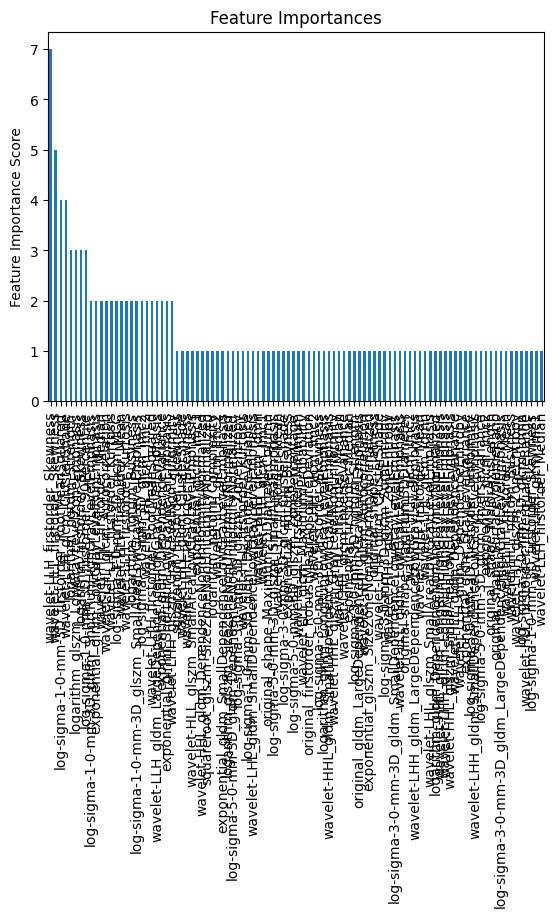

In [ ]:
xgb2 = XGBClassifier(
 learning_rate =0.1,
 n_estimators=1000,
 max_depth=3,
 min_child_weight=1,
 gamma=0.2,
 subsample=0.8,
 colsample_bytree=0.8,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27)
modelfit(xgb2, data1, predictors)

In [ ]:
param_test4 = {
 'subsample':[i/10.0 for i in range(6,10)],
 'colsample_bytree':[i/10.0 for i in range(6,10)]
}
gsearch4 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=128, max_depth=3,
 min_child_weight=1, gamma=0.2, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27),
 param_grid = param_test4, scoring='roc_auc',n_jobs=4, cv=5)
gsearch4.fit(data1[predictors],data1[target])
gsearch4.cv_results_, gsearch4.best_params_, gsearch4.best_score_


({'mean_fit_time': array([2.76647825, 3.51008239, 4.20460215, 2.42796192, 2.37207727,
         3.02953577, 3.62699165, 2.50910349, 2.46621795, 3.14760213,
         3.53506999, 2.62495089, 2.70747628, 3.79281998, 3.31971974,
         2.52423015]),
  'std_fit_time': array([0.14325205, 0.80388615, 0.65715653, 0.41434392, 0.07630117,
         0.83506424, 0.34396594, 0.26043871, 0.06076297, 0.82334767,
         0.56922536, 0.11796113, 0.18842435, 0.65554329, 1.04961262,
         0.13024994]),
  'mean_score_time': array([0.60219378, 0.72714796, 0.58021679, 0.38020597, 0.44987326,
         0.70581594, 0.65507159, 0.34612842, 0.43031392, 0.62246723,
         0.50408916, 0.36887822, 0.45422368, 0.59755039, 0.33868794,
         0.32415752]),
  'std_score_time': array([0.09701837, 0.24917318, 0.21848362, 0.09259434, 0.19520719,
         0.31821405, 0.28259278, 0.05279401, 0.10417968, 0.13610546,
         0.14569046, 0.0560962 , 0.19230482, 0.11264417, 0.06292064,
         0.15990802]),
  'param_c

In [ ]:
param_test5 = {
 'subsample':[i/100.0 for i in range(75,90,5)],
 'colsample_bytree':[i/100.0 for i in range(75,90,5)]
}
gsearch5 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=127, max_depth=3,
 min_child_weight=1, gamma=0.2, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27),
 param_grid = param_test5, scoring='roc_auc',n_jobs=4, cv=5)
gsearch5.fit(data1[predictors],data1[target])
gsearch5.cv_results_, gsearch5.best_params_, gsearch5.best_score_

({'mean_fit_time': array([2.88147783, 3.38070416, 4.48411088, 2.97379494, 3.23830709,
         4.05273046, 2.69886894, 2.54832597, 3.29222202]),
  'std_fit_time': array([0.17869447, 0.80578307, 0.73336594, 0.31697939, 0.49196949,
         0.51994524, 0.36981199, 0.17371186, 0.39828362]),
  'mean_score_time': array([0.49304042, 0.79877086, 0.77719121, 0.58773646, 0.78227015,
         0.68593054, 0.44452562, 0.43559675, 0.40718923]),
  'std_score_time': array([0.1081809 , 0.33590017, 0.20907096, 0.11346674, 0.2016647 ,
         0.16916034, 0.08648555, 0.02014657, 0.1822412 ]),
  'param_colsample_bytree': masked_array(data=[0.75, 0.75, 0.75, 0.8, 0.8, 0.8, 0.85, 0.85, 0.85],
               mask=[False, False, False, False, False, False, False, False,
                     False],
         fill_value='?',
              dtype=object),
  'param_subsample': masked_array(data=[0.75, 0.8, 0.85, 0.75, 0.8, 0.85, 0.75, 0.8, 0.85],
               mask=[False, False, False, False, False, False, Fals

In [ ]:
param_test6 = {
 'reg_alpha':[1e-5, 1e-2, 0.1, 1, 100]
}
gsearch6 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=127, max_depth=3,
 min_child_weight=1, gamma=0.2, subsample=0.8, colsample_bytree=0.8,
 objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27),
 param_grid = param_test6, scoring='roc_auc',n_jobs=4, cv=5)
gsearch6.fit(data1[predictors],data1[target])
gsearch6.cv_results_, gsearch6.best_params_, gsearch6.best_score_

({'mean_fit_time': array([4.95543823, 3.1145946 , 3.78375692, 4.20502601, 1.93741441]),
  'std_fit_time': array([0.99741663, 0.27767038, 0.799329  , 0.2779328 , 0.37700178]),
  'mean_score_time': array([0.53273659, 0.53017745, 0.79475513, 0.57679319, 0.43264256]),
  'std_score_time': array([0.13733011, 0.07030505, 0.23245963, 0.19129796, 0.16276449]),
  'param_reg_alpha': masked_array(data=[1e-05, 0.01, 0.1, 1, 100],
               mask=[False, False, False, False, False],
         fill_value='?',
              dtype=object),
  'params': [{'reg_alpha': 1e-05},
   {'reg_alpha': 0.01},
   {'reg_alpha': 0.1},
   {'reg_alpha': 1},
   {'reg_alpha': 100}],
  'split0_test_score': array([0.62962963, 0.60493827, 0.61728395, 0.69753086, 0.5       ]),
  'split1_test_score': array([0.66666667, 0.63580247, 0.61728395, 0.62962963, 0.5       ]),
  'split2_test_score': array([0.58641975, 0.57407407, 0.58024691, 0.54938272, 0.5       ]),
  'split3_test_score': array([0.52352941, 0.51764706, 0.46470588,

In [ ]:
# param_test7 = {
#  'reg_alpha':[ 0.01, 0.05, 1]
# }

# gsearch7 = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=50, max_depth=1,
#  min_child_weight=1, gamma=0, subsample=0.8, colsample_bytree=0.85,
#  objective= 'binary:logistic', nthread=4, scale_pos_weight=1,seed=27),
#  param_grid = param_test7, scoring='roc_auc',n_jobs=4, cv=5)
# gsearch7.fit(data1[predictors],data1[target])
# gsearch7.cv_results_, gsearch7.best_params_, gsearch7.best_score_

({'mean_fit_time': array([0.49812784, 0.51526437, 0.41316123]),
  'std_fit_time': array([0.04034643, 0.02593289, 0.09254075]),
  'mean_score_time': array([0.12016916, 0.11792607, 0.07006493]),
  'std_score_time': array([0.01123364, 0.01031789, 0.03402809]),
  'param_reg_alpha': masked_array(data=[0.01, 0.05, 1],
               mask=[False, False, False],
         fill_value='?',
              dtype=object),
  'params': [{'reg_alpha': 0.01}, {'reg_alpha': 0.05}, {'reg_alpha': 1}],
  'split0_test_score': array([0.52647059, 0.55882353, 0.57058824]),
  'split1_test_score': array([0.57352941, 0.57352941, 0.58529412]),
  'split2_test_score': array([0.56790123, 0.57407407, 0.57407407]),
  'split3_test_score': array([0.74509804, 0.74509804, 0.73202614]),
  'split4_test_score': array([0.58169935, 0.58169935, 0.60130719]),
  'mean_test_score': array([0.59893972, 0.60664488, 0.61265795]),
  'std_test_score': array([0.07552527, 0.06962174, 0.06063821]),
  'rank_test_score': array([3, 2, 1], dtype=

[0]	train-auc:0.90236+0.02019	test-auc:0.54720+0.08508
[1]	train-auc:0.96072+0.01200	test-auc:0.55292+0.10030
[2]	train-auc:0.97863+0.00861	test-auc:0.54849+0.08620
[3]	train-auc:0.98863+0.00379	test-auc:0.53217+0.08295
[4]	train-auc:0.99509+0.00276	test-auc:0.56492+0.08948
[5]	train-auc:0.99665+0.00241	test-auc:0.58654+0.09839
[6]	train-auc:0.99854+0.00156	test-auc:0.60398+0.09621
[7]	train-auc:0.99909+0.00074	test-auc:0.62411+0.10300
[8]	train-auc:0.99901+0.00082	test-auc:0.62586+0.09084
[9]	train-auc:0.99984+0.00031	test-auc:0.63469+0.08581
[10]	train-auc:0.99985+0.00018	test-auc:0.62493+0.08185
[11]	train-auc:0.99985+0.00030	test-auc:0.62162+0.09033
[12]	train-auc:0.99992+0.00015	test-auc:0.63001+0.07495
[13]	train-auc:1.00000+0.00000	test-auc:0.63010+0.08136
[14]	train-auc:1.00000+0.00000	test-auc:0.62255+0.07355
[15]	train-auc:1.00000+0.00000	test-auc:0.61862+0.07342
[16]	train-auc:1.00000+0.00000	test-auc:0.62318+0.08359
[17]	train-auc:1.00000+0.00000	test-auc:0.62713+0.08404
[1

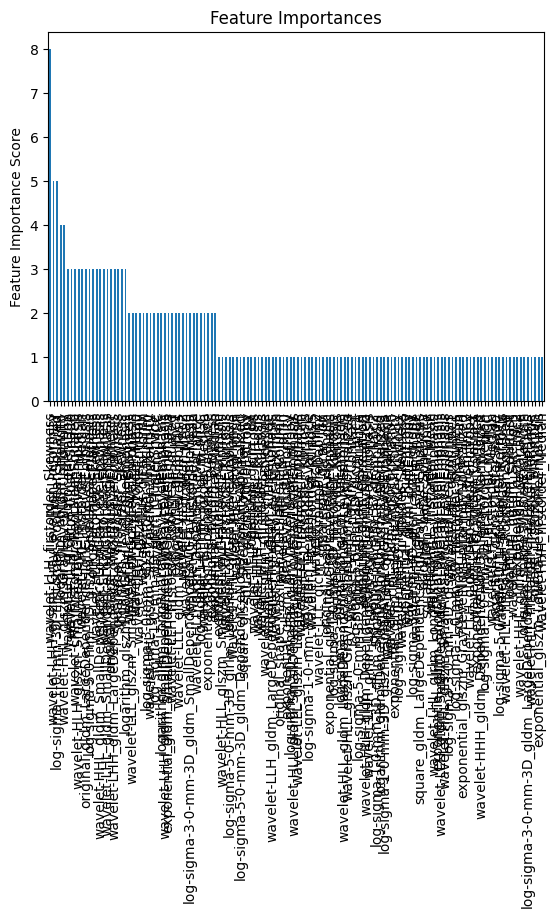

In [ ]:
xgb2 = XGBClassifier(
 learning_rate =0.1,
 n_estimators=1000,
 max_depth=3,
 min_child_weight=1,
 gamma=0.2,
 subsample=0.8,
 colsample_bytree=0.8,
 reg_alpha=1e-05,
 objective= 'binary:logistic',
 nthread=4,
 scale_pos_weight=1,
 seed=27)
modelfit(xgb1, data1,predictors)

In [ ]:
# model = XGBClassifier()

# learning_rate = np.arange(0.001, 1, 0.01)

# param_grid = dict(learning_rate=learning_rate)

# kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=7)

# grid_search = GridSearchCV(model, param_grid, scoring="neg_log_loss", n_jobs=-1, cv=kfold)
# grid_search.fit(final_df_test[predictors],final_df_test[target])
# grid_search.cv_results_, grid_search.best_params_, grid_search.best_score_

({'mean_fit_time': array([1.17833142, 1.0334573 , 0.71824062, 0.67113121, 1.10150559,
         0.59076638, 0.56483054, 0.52740197, 0.72057939, 0.72839153,
         0.46395385, 0.45002196, 0.43147712, 0.49404955, 0.76552236,
         0.41505461, 0.38371832, 0.37280045, 0.36021483, 0.35768204,
         0.5645232 , 0.57860141, 0.33598619, 0.32522712, 0.31792309,
         0.31020041, 0.3043766 , 0.43702679, 0.55801957, 0.35057256,
         0.28766582, 0.28693831, 0.28205388, 0.28104193, 0.27664354,
         0.37277215, 0.50342672, 0.33283632, 0.26770339, 0.26362157,
         0.26286883, 0.25419989, 0.25564744, 0.2548527 , 0.42754042,
         0.44921627, 0.3194011 , 0.24371834, 0.24310298, 0.2404937 ,
         0.23678324, 0.23862913, 0.23700202, 0.2671509 , 0.42727597,
         0.40314922, 0.23063917, 0.22754147, 0.2256268 , 0.22559247,
         0.22459371, 0.22099385, 0.22345896, 0.29783897, 0.36854064,
         0.35716686, 0.21685832, 0.21326861, 0.21650927, 0.21834235,
         0.215904

In [ ]:
# from sklearn.metrics import roc_curve
# from sklearn.metrics import auc

# # Compute fpr, tpr, thresholds and roc auc
# fpr, tpr, thresholds = roc_curve(Y_test, pred)
# roc_auc = auc(fpr, tpr)


# # Plot ROC curve
# plt.plot(fpr, tpr, label='ROC curve (area = %0.3f)' % roc_auc)
# plt.plot([0, 1], [0, 1], 'k--')  # random predictions curve
# plt.xlim([0.0, 1.0])
# plt.ylim([0.0, 1.0])
# plt.xlabel('False Positive Rate or (1 - Specifity)')
# plt.ylabel('True Positive Rate or (Sensitivity)')
# plt.title('Receiver Operating Characteristic')
# plt.legend(loc="lower right")

ValueError: Found input variables with inconsistent numbers of samples: [13, 120]

In [ ]:
import matplotlib

In [ ]:
imgs= "/content/RADIOMICS/RADIOMICS_58_RTN/NII/3DFSPGR.nii"
mask_img= '/content/RADIOMICS/RADIOMICS_58_RTN/Segmentation/Segmentation.nii.gz'

In [ ]:
idx= 60

img_fdata= nib.load(imgs).get_fdata()

slice_= img_fdata[:, :, idx]

matplotlib.image.imsave('img.png', slice_, cmap='gray')

In [ ]:
mask_fdata= nib.load(mask_img).get_fdata()

slice_= mask_fdata[:, :, idx]

matplotlib.image.imsave('mask.png', slice_, cmap= 'Greens')

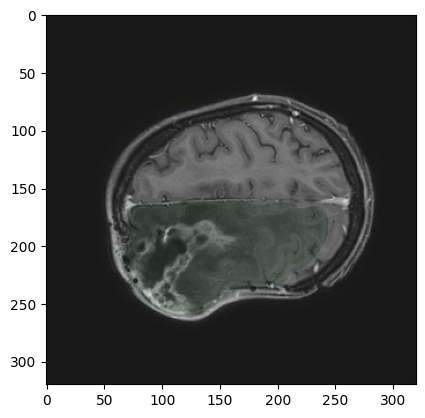

In [ ]:
import matplotlib.pyplot as plt

image = plt.imread('img.png')
mask = plt.imread('mask.png')

fig, ax = plt.subplots()
ax.imshow(image, cmap='gray')
ax.imshow(mask, cmap= 'Greens' ,alpha=0.1)
fig.show()
fig.savefig('overlapped.png')

Text(0.5, 1.0, 'RTN')

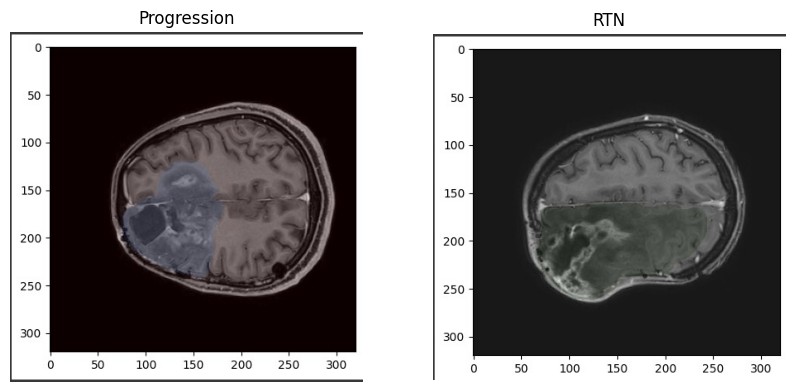

In [ ]:
import cv2
from matplotlib import pyplot as plt

# create figure
fig = plt.figure(figsize=(10, 7))

# setting values to rows and column variables
rows = 1
columns = 2

# reading images
Image1 = cv2.imread('/content/prog_1.jpg')
Image2 = cv2.imread('/content/rtn_1.jpg')
# Image3 = cv2.imread('Image3.jpg')
# Image4 = cv2.imread('Image4.jpg')

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 1)

# showing image
plt.imshow(Image1)
plt.axis('off')
plt.title("Progression")

# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 2)

# showing image
plt.imshow(Image2)
plt.axis('off')
plt.title("RTN")


In [ ]:
!pip install scipy==1.11.4

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.4/36.4 MB 20.7 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.13.1
    Uninstalling scipy-1.13.1:
      Successfully uninstalled scipy-1.13.1


In [ ]:
X

,original_shape_Elongation,original_shape_Flatness,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterColumn,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_MinorAxisLength,...,exponential_glszm_SmallAreaHighGrayLevelEmphasis,exponential_glszm_SmallAreaLowGrayLevelEmphasis,exponential_glszm_ZoneEntropy,exponential_glszm_ZonePercentage,exponential_glszm_ZoneVariance,exponential_ngtdm_Busyness,exponential_ngtdm_Coarseness,exponential_ngtdm_Complexity,exponential_ngtdm_Contrast,exponential_ngtdm_Strength
0,0.578695,0.285496,85.218468,298.492730,188.170136,349.322201,348.969913,354.506700,2.888481e+06,172.736245,...,34.120728,0.033252,6.990899,0.001592,1.338891e+09,779.780257,0.000015,88.802993,0.000110,0.138185
1,0.867044,0.521033,41.791257,80.208461,94.641429,84.528102,101.833197,102.985436,1.353419e+05,69.544252,...,18.100580,0.061443,6.218087,0.003277,2.099051e+07,193.817385,0.000118,42.702792,0.000448,0.169912
2,0.473794,0.246831,30.223575,122.446496,65.122961,151.558570,137.931142,157.149610,1.268276e+05,58.014385,...,26.931861,0.040214,6.323051,0.009978,6.369034e+06,161.642641,0.000102,122.279484,0.002210,0.188829
3,0.651864,0.205458,51.710768,251.685668,216.187419,280.301623,274.963634,283.273719,1.291204e+06,164.064883,...,106.529164,0.014700,7.183261,0.003942,2.770419e+08,164.770176,0.000041,268.478911,0.000069,1.700372
4,0.650361,0.378491,51.724134,136.658977,109.041277,146.123236,151.476071,162.228234,3.983875e+05,88.877717,...,82.386306,0.025874,6.497957,0.005436,6.625315e+07,101.119276,0.000116,93.166307,0.000071,1.792949
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130,0.615723,0.267597,21.045255,78.645367,98.412398,59.413803,101.123687,102.610916,4.746825e+04,48.423743,...,18.470273,0.038265,5.887952,0.017766,3.955270e+05,60.388002,0.000260,48.264047,0.018718,0.026148
131,0.593722,0.320946,46.102015,143.644048,125.063984,160.199875,158.256122,162.963186,3.516455e+05,85.284601,...,3.506744,0.090707,4.793363,0.000785,3.997117e+08,865.480461,0.000115,1.235002,0.000266,0.005846
132,0.803080,0.592127,78.819772,133.113006,136.740630,175.934647,176.465294,183.855922,5.739605e+05,106.900339,...,6.187205,0.090125,6.022692,0.001010,4.291993e+08,761.663703,0.000050,10.145146,0.000135,0.030547
133,0.498491,0.467463,43.559987,93.183781,62.369865,110.476242,108.903627,111.054041,1.017913e+05,46.451282,...,8.107437,0.107869,4.683852,0.002767,2.580085e+07,235.545363,0.000174,15.201087,0.000395,0.086741


In [ ]:
corr_df

,col_labels,corr_values
0,original_shape_Elongation,0.125687
1,original_shape_Flatness,0.014763
2,original_shape_LeastAxisLength,0.163991
3,original_shape_MajorAxisLength,0.201498
4,original_shape_Maximum2DDiameterColumn,0.044689
...,...,...
1497,exponential_ngtdm_Busyness,0.174764
1498,exponential_ngtdm_Coarseness,0.164390
1499,exponential_ngtdm_Complexity,0.083791
1500,exponential_ngtdm_Contrast,0.154016


In [ ]:
data1

,Outcome,squareroot_glcm_Idn,wavelet-LLL_firstorder_Kurtosis,wavelet-LHH_firstorder_Mean,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LHL_firstorder_Kurtosis,wavelet-HHL_glrlm_LongRunHighGrayLevelEmphasis,logarithm_gldm_DependenceNonUniformityNormalized,logarithm_ngtdm_Strength,exponential_gldm_DependenceVariance,...,wavelet-HLH_glszm_SmallAreaLowGrayLevelEmphasis,square_glrlm_RunEntropy,exponential_gldm_LargeDependenceHighGrayLevelEmphasis,log-sigma-3-0-mm-3D_glrlm_GrayLevelNonUniformityNormalized,logarithm_gldm_LargeDependenceLowGrayLevelEmphasis,exponential_gldm_SmallDependenceLowGrayLevelEmphasis,log-sigma-3-0-mm-3D_ngtdm_Contrast,squareroot_firstorder_Skewness,log-sigma-5-0-mm-3D_firstorder_Kurtosis,wavelet-LLH_glszm_SmallAreaLowGrayLevelEmphasis
0,0,0.935872,0.506826,0.349510,0.023269,0.333468,0.459530,0.130308,0.037315,0.285289,...,0.063405,0.889838,0.160884,0.407703,0.011283,0.001688,0.028602,0.717275,0.418167,0.139084
1,0,0.525409,0.209695,0.317385,0.015040,0.163376,0.230429,0.177505,0.050712,0.441181,...,0.140869,0.399163,0.168024,0.407378,0.022982,0.108534,0.128368,0.380539,0.151328,0.157938
2,0,0.510145,0.218393,0.387411,0.012260,0.106800,0.224852,0.260438,0.168713,0.820260,...,0.019049,0.589738,0.063659,0.233758,0.008072,0.276482,0.155586,0.449015,0.093608,0.057118
3,0,0.785530,1.000000,0.383273,0.010829,0.306706,0.284523,0.367836,0.059917,0.335130,...,0.042411,0.649888,0.081229,0.269598,0.000897,0.025434,0.074303,0.826503,1.000000,0.067578
4,0,0.406159,0.603130,0.353398,0.032008,0.183169,0.144479,0.613519,0.033074,0.238848,...,0.086948,0.425130,0.059899,0.408179,0.002840,0.053492,0.070147,0.634138,0.396570,0.087254
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130,1,0.666453,0.755693,0.559195,0.008850,0.170697,0.042452,0.000000,0.175127,0.376510,...,0.224074,0.428581,1.000000,0.817100,0.071114,0.206408,0.154253,0.000000,0.163861,0.276136
131,0,0.613270,0.353561,0.363670,0.012570,0.177283,0.272143,0.380253,0.154361,0.195836,...,0.018650,0.390602,0.056998,0.342870,0.001363,0.046036,0.097094,0.409444,0.193522,0.053163
132,0,0.906679,0.340948,0.357770,0.020584,0.388835,0.067994,0.128620,0.135352,0.215681,...,0.300089,0.492859,0.103473,0.956378,0.007292,0.045930,0.007293,0.259148,0.391541,0.222573
133,0,0.495883,0.203218,0.425965,0.042512,0.083017,0.537441,0.463655,0.312920,0.418185,...,0.011209,0.311523,0.066599,0.318674,0.005193,0.174859,0.140015,0.392939,0.174565,0.128747


In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# g = sns.clustermap(X.corr(y,'spearman'),
#                    method = 'complete',
#                    cmap   = 'RdBu',
#                    annot  = True,
#                    annot_kws = {'size': 8})
# plt.setp(g.ax_heatmap.get_xticklabels(), rotation=60);

In [ ]:
1.Overlay
 Correlation Matrix
2. ROC curve
3. Specifictiy and sensitivity
4. Best features of K best